
# Preprocessing - QC & Filtering with Muon - NVF Mouse Islets Multiome GEX & ATAC

Michael Sterr

2023-11-29 17:56:31 


# Setup

In [1]:
# General
import scipy as sci
import numpy as np
import pandas as pd
import logging
import anndata as ad

# #R
# import rpy2
# import rpy2.rinterface_lib.callbacks
# from rpy2.robjects import pandas2ri
# import anndata2ri

# Plotting
import matplotlib.pyplot as plt
import matplotlib as mpl
from matplotlib import rcParams
from matplotlib.pyplot import rc_context
import seaborn as sb

# Analysis
import scanpy as sc
import muon as mu
from muon import atac as ac

In [2]:
# Display options
from IPython.core.display import display, HTML
display(HTML("<style>.container { width:85% !important; }</style>"))
#pd.set_option("display.max_rows", None)

# from itables import init_notebook_mode
# init_notebook_mode(all_interactive=True)

/tmp/ipykernel_980990/1115849759.py:2: DeprecationWarning: Importing display from IPython.core.display is deprecated since IPython 7.14, please import from IPython display
  from IPython.core.display import display, HTML


In [3]:
# Settings

## Scanpy settings
sc.settings.verbosity = 3
#sc.logging.print_header()
sc.logging.print_versions()

# ## R settings
# ### Ignore R warning messages
# #### Note: this can be commented out to get more verbose R output
# rpy2.rinterface_lib.callbacks.logger.setLevel(logging.ERROR)

# ### Automatically convert rpy2 outputs to pandas dataframes
# pandas2ri.activate()
# anndata2ri.activate()
# %load_ext rpy2.ipython

-----
anndata     0.8.0
scanpy      1.9.3
-----
PIL                 9.4.0
asttokens           NA
backcall            0.2.0
cffi                1.15.1
comm                0.1.2
cycler              0.10.0
cython_runtime      NA
dateutil            2.8.2
debugpy             1.6.6
decorator           5.1.1
defusedxml          0.7.1
executing           1.2.0
h5py                3.8.0
igraph              0.10.8
importlib_resources NA
ipykernel           6.21.2
ipython_genutils    0.2.0
ipywidgets          7.7.1
jedi                0.18.2
joblib              1.2.0
kiwisolver          1.4.4
leidenalg           0.10.1
llvmlite            0.39.1
louvain             0.8.1
matplotlib          3.7.1
mpl_toolkits        NA
mudata              0.2.1
muon                0.1.5
natsort             8.3.1
numba               0.56.4
numexpr             2.8.6
numpy               1.23.5
packaging           23.0
pandas              1.5.3
parso               0.8.3
patsy               0.5.3
pexpect             

In [4]:
# Color maps
exec(open("/home/michi/Software/viscm/maps/michi_bk_bl_gn_yl.py").read())

In [5]:
# Plot settings
%matplotlib inline
# %config InlineBackend.figure_format='retina'

## Directory
sc.settings.figdir='/home/michi/Projects/scMultiome_Mouse-Islets_NVF_E14-E16_Notebooks/Figures'

## Plotting parameters
rcParams['figure.figsize']=(20,20) #rescale figures
#sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False, color_map='tab10' ,transparent=True, dpi=150, dpi_save=300)
sc.set_figure_params(scanpy=True, frameon=False, vector_friendly=False ,transparent=True, dpi=150, dpi_save=300)

## Font
rcParams['font.family'] = 'sans-serif'
rcParams['font.sans-serif'] = ['Source Sans 3']

## Grid & Ticks
rcParams['grid.alpha'] = 0
rcParams['xtick.bottom'] = True
rcParams['ytick.left'] = True

## Embed font
plt.rc('pdf', fonttype=42)

## Define new default settings
plt.rcParamsDefault = plt.rcParams

# Functions

In [6]:
# Functions
def get_umap_leiden(adata, resolution=0.5, exclude_highly_expressed=False):
       
    # preprocess adata, cluster and get umap
    adata_pp = adata.copy()
    sc.pp.normalize_total(adata_pp, target_sum=1e4, exclude_highly_expressed=exclude_highly_expressed, key_added='size_factor') #sc.pp.normalize_per_cell(adata_pp, counts_per_cell_after=1e6)
    sc.pp.log1p(adata_pp)
    sc.pp.pca(adata_pp)
    sc.pp.neighbors(adata_pp, metric='correlation')
    sc.tl.leiden(adata_pp, resolution=resolution)
    sc.tl.umap(adata_pp)
    
    adata.obsm['X_umap'] = adata_pp.obsm['X_umap'].copy()
    adata.obs['leiden'] = adata_pp.obs['leiden'].copy()

###################################################################################################################
###################################################################################################################
###################################################################################################################
    
    
def add_droplet_utils_results(adata, ambient_probs=None, cell_probs=None):
    ambi_key = 'ambient_genes_' + adata.obs['sample'][0]
    ambient_probs.index = ambient_probs['Unnamed: 0'].values
    all_genes = set(adata.var.index)
    ambient_probs_genes = set(ambient_probs.index)
    shared_genes = all_genes.intersection(ambient_probs_genes)
    adata.var[ambi_key] = 0.0
    adata.var.loc[shared_genes,ambi_key] = ambient_probs.loc[shared_genes,'ambient_genes'].values
    #adata.var[ambi_key][all_genes] = ambient_probs['ambient_genes'].values
    
       
    # intersect barcodes from adata and cell_probs
    cell_probs.index = cell_probs.barcodes.values
    adata_barcodes = set(adata.obs.index)
    cell_probs_barcodes = set(cell_probs.index)
    shared_barcodes = adata_barcodes.intersection(cell_probs_barcodes)
                               
    adata.obs.loc[shared_barcodes,'log_cell_probs'] = cell_probs.loc[shared_barcodes,'cell_probs'].values

###################################################################################################################
###################################################################################################################
###################################################################################################################
    
def set_ambient_threshold(adata, threshold=0.0005, lower_limit=0.0001, upper_limit=0.002, bins=60, kde=True):
    ambi_key = 'ambient_genes_' + adata.obs['sample'][0]
    is_ambi_key = 'is_ambient_' + adata.obs['sample'][0]
    
    with rc_context({'figure.figsize': (8, 3)}):
        sb.distplot(adata.var[ambi_key][(adata.var[ambi_key] > lower_limit) & (adata.var[ambi_key] < upper_limit)], kde=kde, bins=bins)
        plt.axvline(threshold, 0, 1)
        plt.title(label='Ambient Genes Threshold (' + str(len(adata.var[ambi_key][adata.var[ambi_key] > threshold])) + ' Genes)', fontweight='bold')
    
    adata.var[is_ambi_key] = pd.Categorical(adata.var[ambi_key] > threshold)

###################################################################################################################
###################################################################################################################
###################################################################################################################
    

def qc_metrics(adata, ambient=True, plot=True, counts_per_gene=True, keep_dense=True, genome='auto', mt_genes_path='/mnt/ssd/Resources/sus_scrofa_mt_ens101_ext.txt'):
    """\
    Calculate QC metrics.
    genome: {'auto','Mus_musculus','Homo_sapiens','Sus_scrofa'}
    mt_genes_path: Path to mitochondrial genes for sus scrofa. Tab delimited file without header and with gene symbols in column 2. default: '/mnt/ssd/Resources/sus_scrofa_mt_ens101_ext.txt'
    ambient: Requires adata.var['is_ambient'] = pd.Categorical(list(map(str,list(adata.var['ambient_genes'] > cut_off))))
    """
    
    is_ambi_key = 'is_ambient_' + adata.obs['sample'][0]
    
    if genome=='auto':
        genome = '_'.join(adata.var.loc[:,'genome'][0].split('_')[0:2])
        print('Genome is', genome)

    if sci.sparse.issparse(adata.X):
        adata.X = adata.X.toarray()

    if counts_per_gene:
        # counts per gene
        adata.var['n_counts'] = adata.X.sum(0)

    # counts per cell
    adata.obs['n_counts'] = adata.X.sum(1)
    # log counts per cell
    adata.obs['log_counts'] = np.log(adata.obs['n_counts'])
    # rank by counts
    adata.obs['n_counts_rank'] = adata.obs['n_counts'].rank(method='first',ascending=False)
    # genes per cell
    adata.obs['n_genes'] = (adata.X > 0).sum(1)
    # log genes per cell
    adata.obs['log_genes'] = np.log(adata.obs['n_genes'])
    # fraction of mitochondrial genes
    if (genome == 'Homo_sapiens') | (genome == 'homo_sapiens'):
        mt_gene_mask = [gene.startswith('MT-') for gene in adata.var_names]
        adata.obs['mt_frac'] = adata.X[:, mt_gene_mask].sum(1)/adata.obs['n_counts']

        rp_gene_mask = [gene.startswith(('RPS','RPL')) for gene in adata.var_names]
        adata.obs['rp_frac'] = adata.X[:,rp_gene_mask].sum(1) / adata.obs['n_counts']

    elif (genome == 'Mus_musculus') | (genome == 'mus_musculus'):
        mt_gene_mask = [gene.startswith('mt-') for gene in adata.var_names]
        adata.obs['mt_frac'] = adata.X[:, mt_gene_mask].sum(1)/adata.obs['n_counts']

        rp_gene_mask = [gene.startswith(('Rps','Rpl')) for gene in adata.var_names]
        adata.obs['rp_frac'] = adata.X[:,rp_gene_mask].sum(1) / adata.obs['n_counts']

    elif (genome == 'Sus_scrofa') | (genome == 'sus_scrofa'):
        mt_genes = [gene.split('-')[0] for gene in list(pd.read_csv(mt_genes_path , header=None, sep="\t")[1])]
        mt_gene_mask = adata.var_names.isin(mt_genes)
        adata.obs['mt_frac'] = adata.X[:, mt_gene_mask].sum(1)/adata.obs['n_counts']

        rp_gene_mask = [gene.startswith(('RPS','RPL')) for gene in adata.var_names]
        adata.obs['rp_frac'] = adata.X[:,rp_gene_mask].sum(1) / adata.obs['n_counts']

    if ambient:
        adata.obs['ambi_frac'] = adata.X[:,adata.var[is_ambi_key]==True].sum(1) / adata.obs['n_counts']

    if plot:
        sb.jointplot(
            data=adata.obs,
            x="log_counts",
            y="log_genes",
            kind="hist", bins=100, cmap="rocket_r", color="#f69c73", space=0
        )

        fig, ax1 = plt.subplots()
        ax1.scatter(x=adata.obs['n_counts_rank'], y=adata.obs['n_counts'], s=1, alpha=0.2, c='black', label='Total UMI Counts')
        ax1.scatter(x=adata.obs['n_counts_rank'], y=adata.obs['n_genes'], s=1, alpha=0.2, c='tab:green', label='Gene Counts')
        ax1.set(xscale='log', yscale='log')
        ax1.set_ylabel('Total UMI/Gene Counts')
        ax1.set_xlabel('Ranked Droplets')
        #ax1.vlines(x=[max_rank], color="black", lw=0.5).set_linestyle("--")

        ax2 = ax1.twinx()
        ax2.scatter(x=adata.obs['n_counts_rank'], y=adata.obs['mt_frac']*100, s=1, alpha=0.2, c='tab:red', label='% Mito. Counts')
        ax2.set_ylabel('%')

        fig.legend(loc='center left', fontsize='xx-small', bbox_to_anchor=(0.2, 0.35))
        
    if not keep_dense:
        adata.X = sci.sparse.csr_matrix(adata.X)  
        


###################################################################################################################
###################################################################################################################
###################################################################################################################
    
    
    
def prefilter_barcodes_mdata(mdata, barcodes=None, plot=True):
    all_barcodes = pd.Series(mdata.obs.index)
    mdata.mod['rna'] = mdata.mod['rna'][all_barcodes[all_barcodes.isin(barcodes)]].copy()
    mu.pp.intersect_obs(mdata)
    #mdata=mdata[list(all_barcodes[all_barcodes.isin(barcodes)])].copy()
    
    if plot:
        sb.jointplot(
            data=mdata.mod['rna'].obs,
            x="log_counts",
            y="log_genes",
            kind="hist", bins=100, cmap="rocket_r", color="#f69c73", space=0
        )
        
        #############################

        fig, ax1 = plt.subplots()
        ax1.scatter(x=mdata.mod['rna'].obs['n_counts_rank'], y=mdata.mod['rna'].obs['n_counts'], s=1, alpha=0.2, c='black', label='Total UMI Counts')
        ax1.scatter(x=mdata.mod['rna'].obs['n_counts_rank'], y=mdata.mod['rna'].obs['n_genes'], s=1, alpha=0.2, c='tab:green', label='Gene Counts')
        ax1.set(xscale='log', yscale='log')
        ax1.set_ylabel('Total UMI/Gene Counts')
        ax1.set_xlabel('Ranked Droplets')
        #ax1.vlines(x=[max_rank], color="black", lw=0.5).set_linestyle("--")

        ax2 = ax1.twinx()
        ax2.scatter(x=mdata.mod['rna'].obs['n_counts_rank'], y=mdata.mod['rna'].obs['mt_frac']*100, s=1, alpha=0.2, c='tab:red', label='% Mito. Counts')
        ax2.set_ylabel('%')

        fig.legend(loc='center left', fontsize='xx-small', bbox_to_anchor=(0.2, 0.35))

        plt.show()

        ###################################

        cell_probs_key = 'log_cell_probs' #'log_cell_probs_' + mdata.mod['rna'].obs['sample'][0]
        fig, ax1 = plt.subplots()
        ax1.scatter(x=mdata.mod['rna'].obs['n_counts_rank'], y=mdata.mod['rna'].obs['n_counts'], s=1, alpha=0.2, c='black', label='Total UMI Counts')
        ax1.scatter(x=mdata.mod['rna'].obs['n_counts_rank'], y=mdata.mod['rna'].obs['n_genes'], s=1, alpha=0.2, c='tab:green', label='Gene Counts')
        ax1.set(xscale='log', yscale='log')
        ax1.set_ylabel('Total UMI/Gene Counts')
        ax1.set_xlabel('Ranked Droplets')
        #ax1.vlines(x=[max_rank], color="black", lw=0.5).set_linestyle("--")

        ax2 = ax1.twinx()
        ax2.scatter(x=mdata.mod['rna'].obs['n_counts_rank'], y=mdata.mod['rna'].obs[cell_probs_key], s=1, alpha=0.2, c='tab:blue', label='Log Cell Probabilities')
        ax2.set_ylabel('Cell Probabilities')

        fig.legend(loc='center left', fontsize='xx-small', bbox_to_anchor=(0.2, 0.35))

        plt.show()

        ##############################

        sb.distplot(mdata.mod['rna'].obs[cell_probs_key][~np.isnan(list(mdata.mod['rna'].obs[cell_probs_key]))], kde=True, bins=60)
        plt.title(label='Log Cell Probabilities', fontweight='bold')
    
    return mdata


def prefilter_barcodes(adata, barcodes=None, plot=True):
    all_barcodes = pd.Series(adata.obs.index)
    adata=adata[all_barcodes[all_barcodes.isin(barcodes)]].copy()
    
    if plot:
        sb.jointplot(
            data=adata.obs,
            x="log_counts",
            y="log_genes",
            kind="hist", bins=100, cmap="rocket_r", color="#f69c73", space=0
        )
        
        #############################

        fig, ax1 = plt.subplots()
        ax1.scatter(x=adata.obs['n_counts_rank'], y=adata.obs['n_counts'], s=1, alpha=0.2, c='black', label='Total UMI Counts')
        ax1.scatter(x=adata.obs['n_counts_rank'], y=adata.obs['n_genes'], s=1, alpha=0.2, c='tab:green', label='Gene Counts')
        ax1.set(xscale='log', yscale='log')
        ax1.set_ylabel('Total UMI/Gene Counts')
        ax1.set_xlabel('Ranked Droplets')
        #ax1.vlines(x=[max_rank], color="black", lw=0.5).set_linestyle("--")

        ax2 = ax1.twinx()
        ax2.scatter(x=adata.obs['n_counts_rank'], y=adata.obs['mt_frac']*100, s=1, alpha=0.2, c='tab:red', label='% Mito. Counts')
        ax2.set_ylabel('%')

        fig.legend(loc='center left', fontsize='xx-small', bbox_to_anchor=(0.2, 0.35))
        
        plt.show()
        
        ###################################
        
        cell_probs_key = 'log_cell_probs' #'log_cell_probs_' + adata.obs['sample'][0]
        fig, ax1 = plt.subplots()
        ax1.scatter(x=adata.obs['n_counts_rank'], y=adata.obs['n_counts'], s=1, alpha=0.2, c='black', label='Total UMI Counts')
        ax1.scatter(x=adata.obs['n_counts_rank'], y=adata.obs['n_genes'], s=1, alpha=0.2, c='tab:green', label='Gene Counts')
        ax1.set(xscale='log', yscale='log')
        ax1.set_ylabel('Total UMI/Gene Counts')
        ax1.set_xlabel('Ranked Droplets')
        #ax1.vlines(x=[max_rank], color="black", lw=0.5).set_linestyle("--")

        ax2 = ax1.twinx()
        ax2.scatter(x=adata.obs['n_counts_rank'], y=adata.obs[cell_probs_key], s=1, alpha=0.2, c='tab:blue', label='Log Cell Probabilities')
        ax2.set_ylabel('Cell Probabilities')

        fig.legend(loc='center left', fontsize='xx-small', bbox_to_anchor=(0.2, 0.35))
        
        plt.show()
        
        ##############################
        
        sb.distplot(adata.obs[cell_probs_key][~np.isnan(list(adata.obs[cell_probs_key]))], kde=True, bins=60)
        plt.title(label='Log Cell Probabilities', fontweight='bold')
    
    return adata



###################################################################################################################
###################################################################################################################
###################################################################################################################
    

        
def filter_qc(adata, counts_filter, genes_filter, mito_filter):
    """\
    counts_filter, genes_filter, mito_filter: array of booleans. E.g. genes_filter = adata.obs['n_genes'] > min_genes
    """
    pre_filter_n_obs = adata.n_obs
    adata = adata[counts_filter & genes_filter & mito_filter]
    pct = (pre_filter_n_obs - adata.n_obs) / pre_filter_n_obs * 100
    print('Filtered out {:d}'.format(pre_filter_n_obs - adata.n_obs),'cells ({:.1f}'.format(pct) ,'%).')
    print('Number of cells after filter: {:d}'.format(adata.n_obs))
    #return adata
    

###################################################################################################################
###################################################################################################################
###################################################################################################################
    
    
def qc_filter_mdata(mdata, adata, modality=None, qc_filter=None): 
    """\
    mdata: mdata oject containing different modalities.
    adata: adata object containing the modality to filter
    modality: modality to filter
    qc_filter: array of booleans. E.g. genes_filter = adata.obs['n_genes'] > min_genes or (genes_filter & counts_filter)
    """
    if (modality is None):
        print('Specify modality (\'rna\' or \'atac\'.')
        return
    if (qc_filter is None):
        print('Specify QC filter.')
        return
    
    pre_filter_n_obs = mdata.mod[modality].n_obs
    mdata.mod[modality] = mdata.mod[modality][qc_filter]
    adata = mdata.mod[modality]
    pct = (pre_filter_n_obs - mdata.mod[modality].n_obs) / pre_filter_n_obs * 100
    print('Filtered out {:d}'.format(pre_filter_n_obs - mdata.mod[modality].n_obs),'cells ({:.1f}'.format(pct) ,'%).')
    print('Number of cells after filter: {:d}'.format(mdata.mod[modality].n_obs))
    return adata


###################################################################################################################
###################################################################################################################
###################################################################################################################
    

def sparsify_mdata(mdata, modalities='all'):
    """
    Loop trough all modalities and make dense adata.X sparse.
    modalites: 'all' or list of modalities, e.g. ['rna','atac']
    """
    if modalities=='all':
        modalities = mdata.mod.keys()
        
    for mod in modalities:
        if not sci.sparse.issparse(mdata.mod[mod].X):
            print('Sparsify modality', mod)
            mdata.mod[mod].X = sci.sparse.csr_matrix(mdata.mod[mod].X)
        else:
            print('Modality', mod, 'already spase...')
            
###################################################################################################################
###################################################################################################################
###################################################################################################################
    
    
    
def sparsify_all_layers(adata):
    """
    Loop trough all layers and make dense matrices sparse.
    """
          
    if not sci.sparse.issparse(adata.X):
        print('Sparsify .X...')
        adata.X = sci.sparse.csr_matrix(adata.X)
    else:
        print('.X already spase...')  
        
    for layer in list(adata.layers):
        if not sci.sparse.issparse(adata.layers[layer]):
            print('Sparsify ', layer)
            adata.layers[layer] = sci.sparse.csr_matrix(adata.layers[layer])
        else:
            print('Layer', layer, 'already spase...')
            
            
###################################################################################################################
###################################################################################################################
###################################################################################################################
    

def sparsify_all_layers_mdata(mdata, modalities='all'):
    """
    Loop trough all modalities and make dense adata.X sparse.
    modalites: 'all' or list of modalities, e.g. ['rna','atac']
    """
    if modalities=='all':
        modalities = mdata.mod.keys()
        
    for mod in modalities:
        if not sci.sparse.issparse(mdata.mod[mod].X):
            print('Sparsify .X in modality', mod)
            mdata.mod[mod].X = sci.sparse.csr_matrix(mdata.mod[mod].X)
        else:
            print('.X in modality', mod, 'already spase...')
            
        for layer in list(mdata.mod[mod].layers):
            if not sci.sparse.issparse(mdata.mod[mod].layers[layer]):
                print('Sparsify ', layer, ' in modality', mod)
                mdata.mod[mod].layers[layer] = sci.sparse.csr_matrix(mdata.mod[mod].layers[layer])
            else:
                print('Layer', layer, ' in modality', mod, 'already spase...')
         

In [7]:
def atac_qc_metrics(atac, mdata, n_tss=2000, plot=True, gtf_path=None):
    """\
    Calculate QC metrics.
    atac: adata object containing atac data. i.e. mdata.mod['atac']
    mdata: Corresponding mdata object
    tss: {'random','top'} random tss or the n tss with highest rna counts
    n_top: number of tss
    """
    import muon as mu
    from muon import atac as ac
    
    if (gtf_path is None):
        print('Provide path to annotation GTF file!')
        return
    
    if sci.sparse.issparse(atac.X):
        print('X is spare. Densifying X...')
        atac.X = atac.X.toarray()
    
    # counts per peak
    atac.var['n_counts'] = atac.X.sum(0)
    # counts per cell
    atac.obs['n_counts_ATAC'] = list(atac.X.sum(1))
    # log counts per cell
    atac.obs['log_counts_ATAC'] = np.log(atac.obs['n_counts_ATAC'] + 1)
    # rank by counts
    atac.obs['n_counts_rank_ATAC'] = atac.obs['n_counts_ATAC'].rank(method='first',ascending=False)
    # genes per cell
    atac.obs['n_peaks_ATAC'] = (atac.X > 0).sum(1)
    # log genes per cell
    atac.obs['log_peaks_ATAC'] = np.log(atac.obs['n_peaks_ATAC'] + 1)
    
    if plot:
        mu.pl.histogram(atac, ['n_counts_ATAC', 'n_peaks_ATAC'])
        
    # nucleosome signal
    ac.tl.nucleosome_signal(atac, n=1e6)
    
    if plot:
        # plot nucleosome signal
        ac.pl.fragment_histogram(atac, region='1:1-20000000')
        mu.pl.histogram(atac, "nucleosome_signal", kde=True)
        
    # TSS enrichment
    tss = ac.tl.tss_enrichment(mdata, n_tss=n_tss)  # by default, features=ac.tl.get_gene_annotation_from_rna(mdata)
    if plot:
        # plot TSS enrichment
        ac.pl.tss_enrichment(tss)
    
        

###################################################################################################################
###################################################################################################################
###################################################################################################################
    
        
def get_feature_pos_from_gtf(gtf_path=None, random=True):
    # load Ensembl annotation file and reduce to genes
    annotation = pd.read_csv(gtf_path, header=None, skiprows=5, sep='\t')
    annotation = annotation.loc[annotation.iloc[:,2]=='gene',:]

    # get positions of + features
    features_p = annotation.loc[annotation.iloc[:,6]=='+',:].iloc[:,[0,3,4]]     
    features_p.columns = ['Chromosome','Start','End']

    # get positions of - features and switch start and end
    features_m = annotation.loc[annotation.iloc[:,6]=='-',:].iloc[:,[0,4,3]]     
    features_m.columns = ['Chromosome','Start','End']

    # concatenate
    features = pd.concat([features_p, features_m], ignore_index = True)
    
    # randomize order
    if random:
        features = features.sample(frac=1, random_state=420)

    return features

###################################################################################################################
###################################################################################################################
###################################################################################################################
    

def get_top_feature_pos_from_gtf(gex_adata, gtf_path=None, n_top=2000):
    # load Ensembl annotation file and reduce to genes
    annotation = pd.read_csv(gtf_path, header=None, skiprows=5, sep='\t')
    annotation = annotation.loc[annotation.iloc[:,2]=='gene',:]
    
    # add gene names
    annotation.loc[:,9] = annotation.loc[:,8].str.split('\"', expand=True).loc[:,1]
    annotation.set_index = annotation[9]
   
    # add counts and sort annotation
    annotation = annotation.merge(gex_adata.var.loc[:,['gene_ids','n_counts']], left_on=9, right_on='gene_ids')
    annotation = annotation.sort_values(by=['n_counts'], ascending=False)
    
    # filter n_top genes
    annotation = annotation.iloc[0:n_top,:]
      
    # get positions of + features
    features_p = annotation.loc[annotation.iloc[:,6]=='+',:].iloc[:,[0,3,4]]     
    features_p.columns = ['Chromosome','Start','End']

    # get positions of - features and switch start and end
    features_m = annotation.loc[annotation.iloc[:,6]=='-',:].iloc[:,[0,4,3]]
    features_m.columns = ['Chromosome','Start','End']

    # concatenate
    features = pd.concat([features_p, features_m], ignore_index = True)

    return features
    


# Load Data

In [8]:
# Load multi modal data
mdata=mu.read_10x_h5('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/raw_feature_bc_matrix.h5')
mdata.obs['sample'] = pd.Categorical(['NVF_E16-5_Rep1']*mdata.n_obs)
mdata.obs['name'] = pd.Categorical(['E16.5']*mdata.n_obs)
mdata.obs['stage'] = pd.Categorical(['E16.5']*mdata.n_obs)
mdata.obs['stage_num'] = pd.Categorical([16.5]*mdata.n_obs)
mdata.obs['int_id'] = pd.Categorical(['666']*mdata.n_obs)
mdata.obs['seq_id_gex_id'] = pd.Categorical(['23L011298']*mdata.n_obs)
mdata.obs['seq_id_atac'] = pd.Categorical(['23L011293']*mdata.n_obs)
mdata.obs['reporter'] = pd.Categorical(['Neurog3-Venus-Fusion']*mdata.n_obs)
mdata.obs['experiment_batch'] = pd.Categorical(['Exp_2']*mdata.n_obs)
mdata.obs['sequencing_batch'] = pd.Categorical(['Seq_3']*mdata.n_obs)

mdata.var_names_make_unique()

mdata.mod['rna'].obs = mdata.obs.copy()
mdata.mod['atac'].obs = mdata.obs.copy()

mdata
#mdata.var_names_make_unique()

reading /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/raw_feature_bc_matrix.h5
 (0:00:06)


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")


Added `interval` annotation for features from /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/raw_feature_bc_matrix.h5


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/mudata/_core/mudata.py:446: UserWarning: var_names are not unique. To make them unique, call `.var_names_make_unique`.
  warnings.warn(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/muon/_atac/tools.py:112: DtypeWarning: Columns (0) have mixed types. Specify dtype option on import or set low_memory=False.
  pa = pd.read_csv(annotation, sep=sep)


Added peak annotation from /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/atac_peak_annotation.tsv to .uns['atac']['peak_annotation']
Added gene names to peak annotation in .uns['atac']['peak_annotation']
Located fragments file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/atac_fragments.tsv.gz


[W::hts_idx_load3] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/atac_fragments.tsv.gz.tbi


MuData object with n_obs × n_vars = 735492 × 212894
  obs:	'sample', 'name', 'stage', 'stage_num', 'int_id', 'seq_id_gex_id', 'seq_id_atac', 'reporter', 'experiment_batch', 'sequencing_batch'
  var:	'gene_ids', 'feature_types', 'genome', 'interval'
  2 modalities
    rna:	735492 x 31255
      obs:	'sample', 'name', 'stage', 'stage_num', 'int_id', 'seq_id_gex_id', 'seq_id_atac', 'reporter', 'experiment_batch', 'sequencing_batch'
      var:	'gene_ids', 'feature_types', 'genome', 'interval'
    atac:	735492 x 181639
      obs:	'sample', 'name', 'stage', 'stage_num', 'int_id', 'seq_id_gex_id', 'seq_id_atac', 'reporter', 'experiment_batch', 'sequencing_batch'
      var:	'gene_ids', 'feature_types', 'genome', 'interval'
      uns:	'atac', 'files'

In [9]:
# DropletUtils output
cell_barcodes_du = pd.read_csv('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/NVF_E16-5_Rep1_DropletUtils_CellBarcodes.csv')
cell_probs = pd.read_csv('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/NVF_E16-5_Rep1_DropletUtils_LogProbabilities.csv')
ambient_genes = pd.read_csv('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/NVF_E16-5_Rep1_DropletUtils_AmbientGenes.csv')

# CellRanger cell barcodes
cell_barcodes_cr = pd.read_csv('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/filtered_feature_bc_matrix/barcodes.tsv.gz', names=['x'])
cell_barcodes_cr = pd.Series(cell_barcodes_cr.loc[:,'x'])

In [10]:
# GEX
gex = mdata.mod['rna']
gex.var_names_make_unique()
#gex.X = gex.X.toarray()

# Preprocessing GEX

## Ambient RNA

In [11]:
add_droplet_utils_results(gex, ambient_probs=ambient_genes, cell_probs=cell_probs)

/tmp/ipykernel_980990/419706704.py:28: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  adata.var.loc[shared_genes,ambi_key] = ambient_probs.loc[shared_genes,'ambient_genes'].values
/tmp/ipykernel_980990/419706704.py:28: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  adata.var.loc[shared_genes,ambi_key] = ambient_probs.loc[shared_genes,'ambient_genes'].values
/tmp/ipykernel_980990/419706704.py:38: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  adata.obs.loc[shared_barcodes,'log_cell_probs'] = cell_probs.loc[shared_barcodes,'cell_probs'].values
/tmp/ipykernel_980990/419706704.py:38: FutureWarning: Passing a set as an indexer is deprecated and will raise in a future version. Use a list instead.
  adata.obs.loc[shared_barcodes,'log_cell_probs'] = cell_probs.loc[shared_barcodes,'cell_probs']

/tmp/ipykernel_980990/419706704.py:49: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(adata.var[ambi_key][(adata.var[ambi_key] > lower_limit) & (adata.var[ambi_key] < upper_limit)], kde=kde, bins=bins)


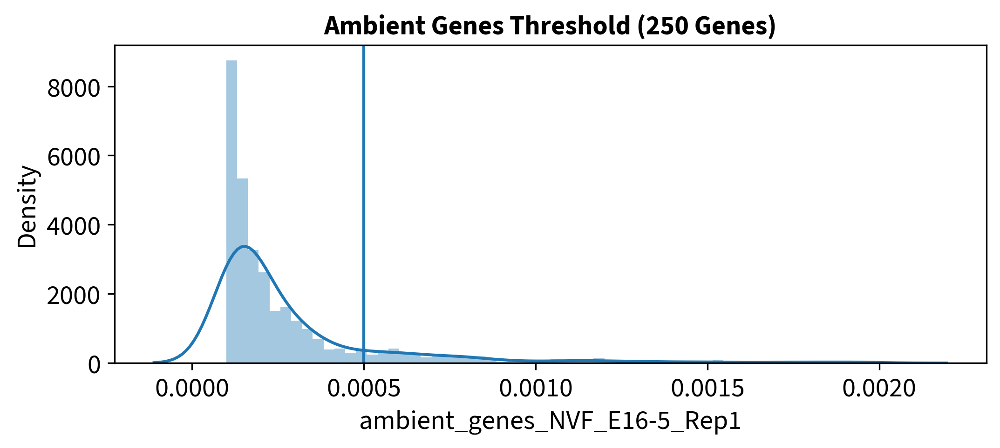

In [12]:
set_ambient_threshold(gex, threshold=0.0005)

## Filter Cell Droplets

Genome is mus_musculus


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/pandas/core/arraylike.py:402: RuntimeWarning: divide by zero encountered in log
  result = getattr(ufunc, method)(*inputs, **kwargs)


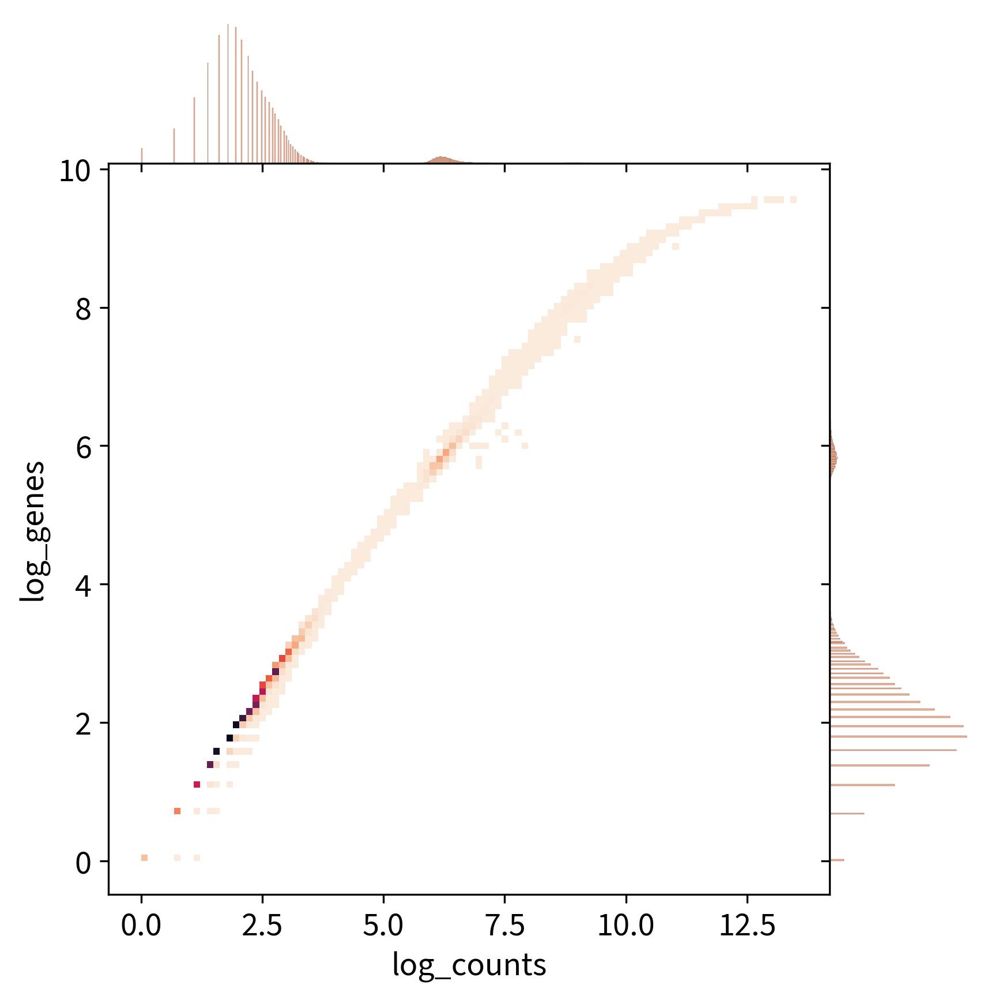

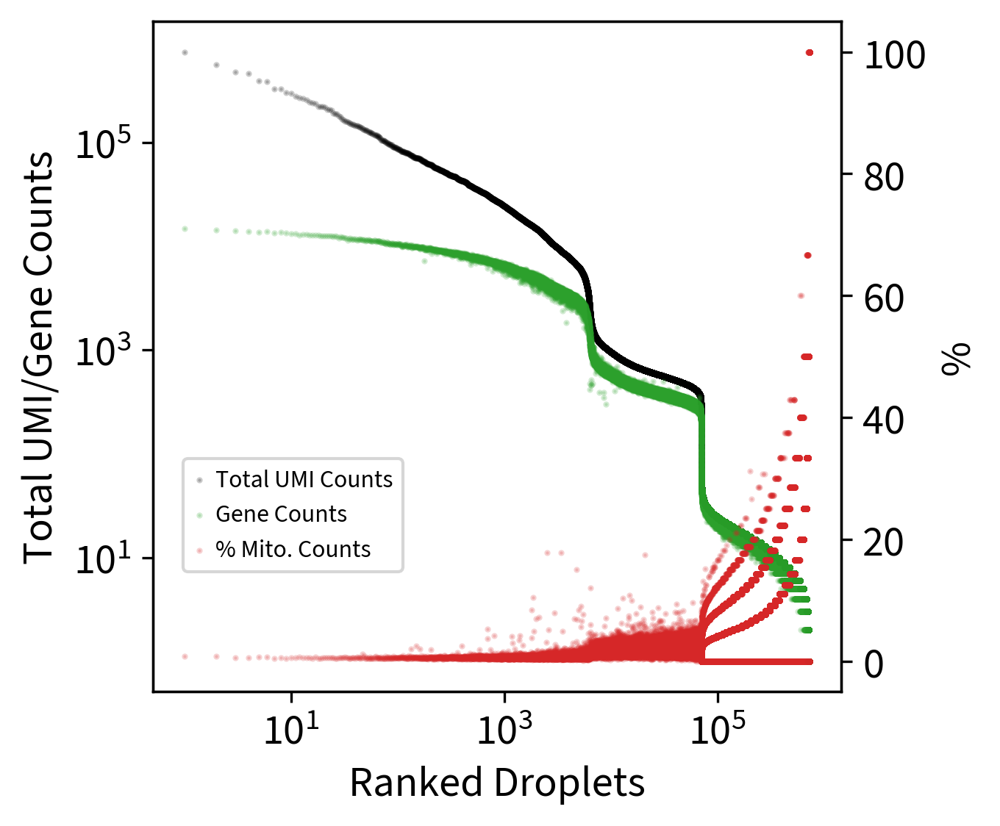

In [13]:
# Quality control - calculate QC covariates
qc_metrics(gex, ambient=True)

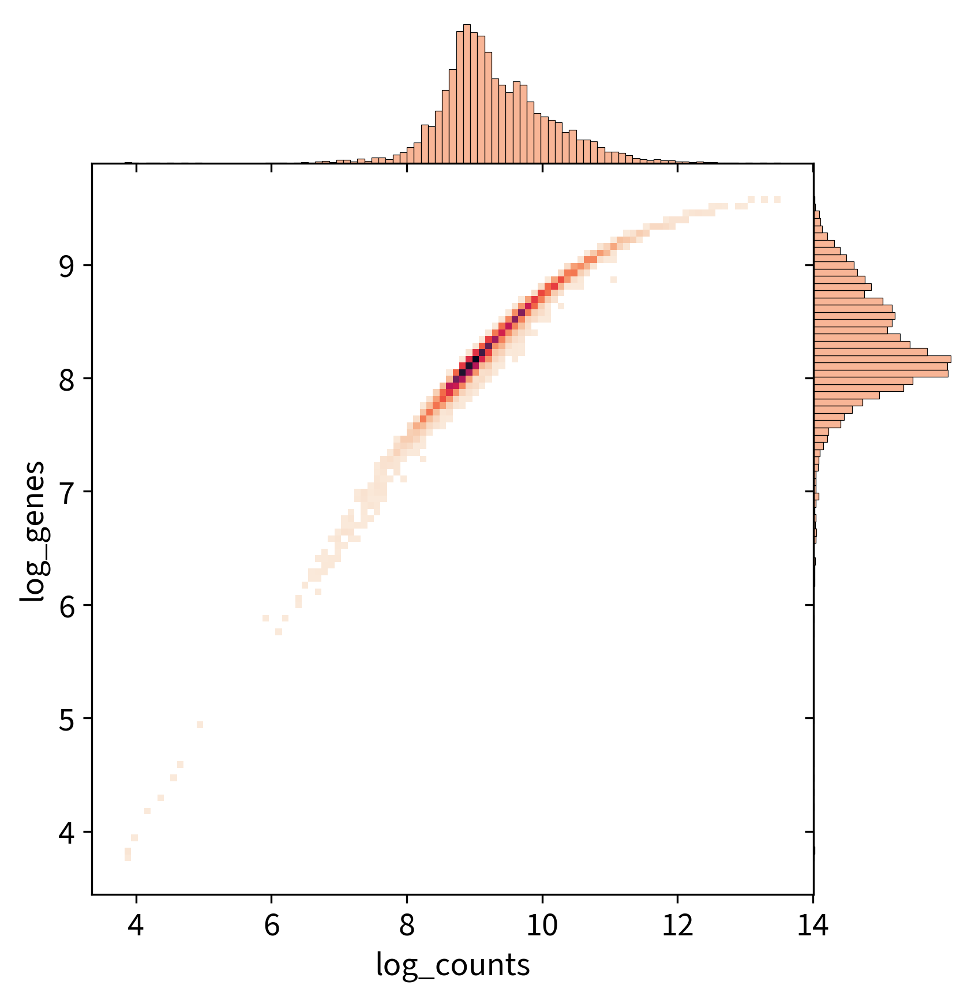

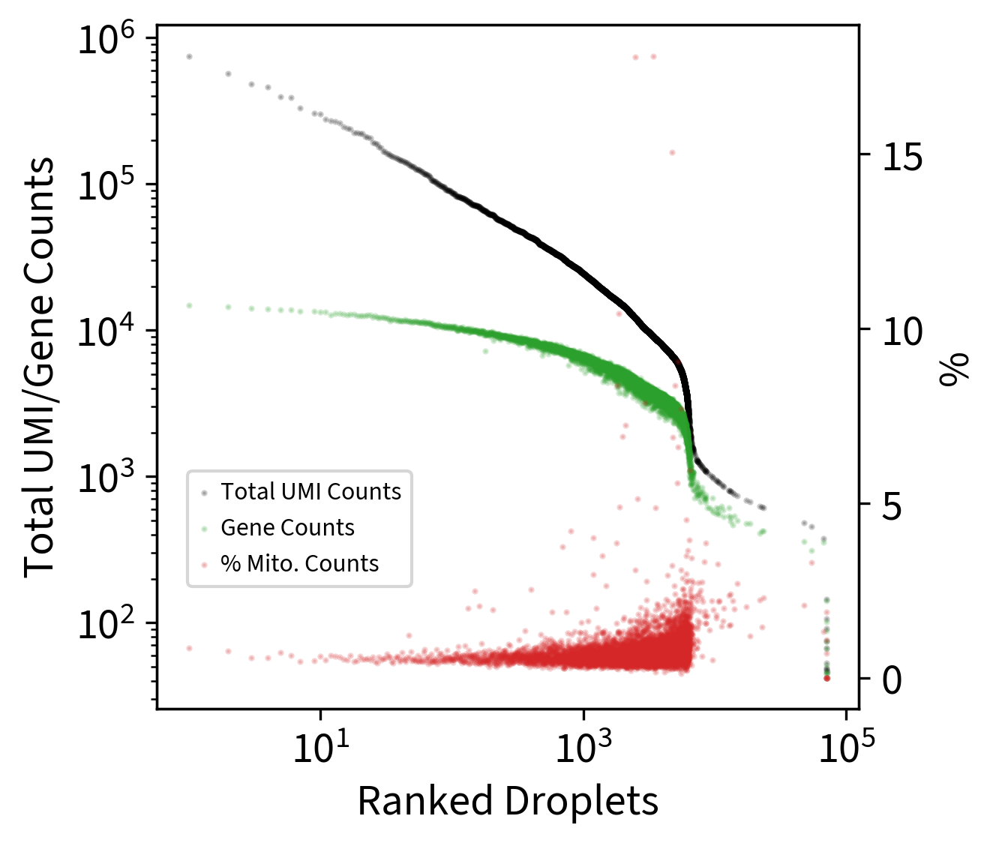

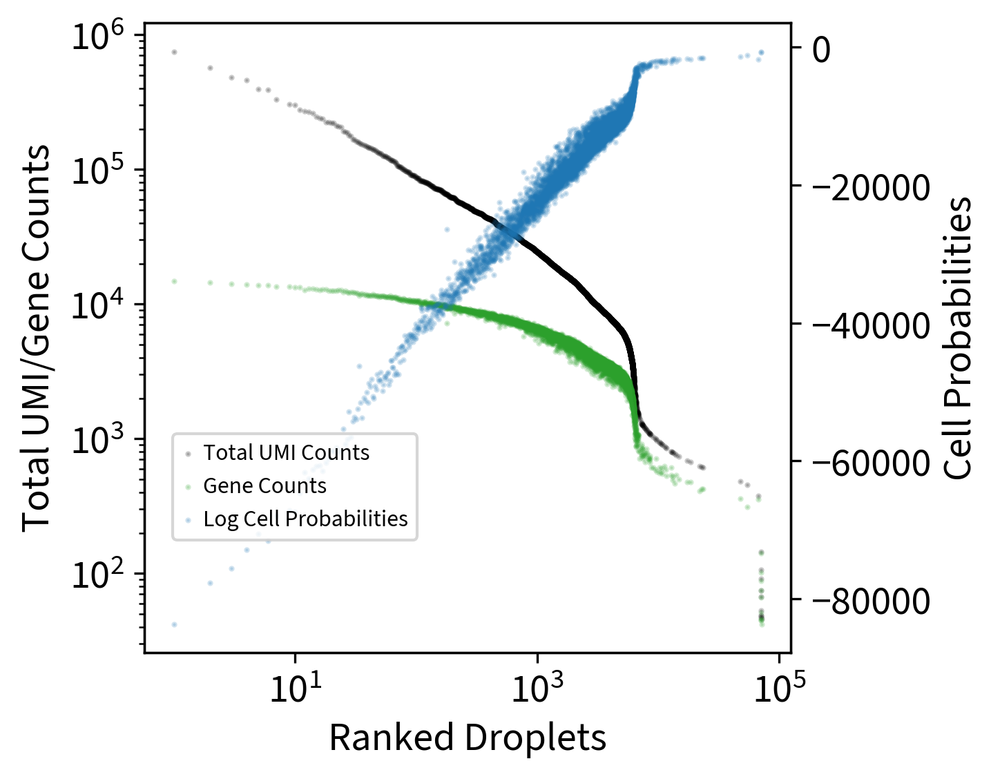

/tmp/ipykernel_980990/419706704.py:203: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(mdata.mod['rna'].obs[cell_probs_key][~np.isnan(list(mdata.mod['rna'].obs[cell_probs_key]))], kde=True, bins=60)


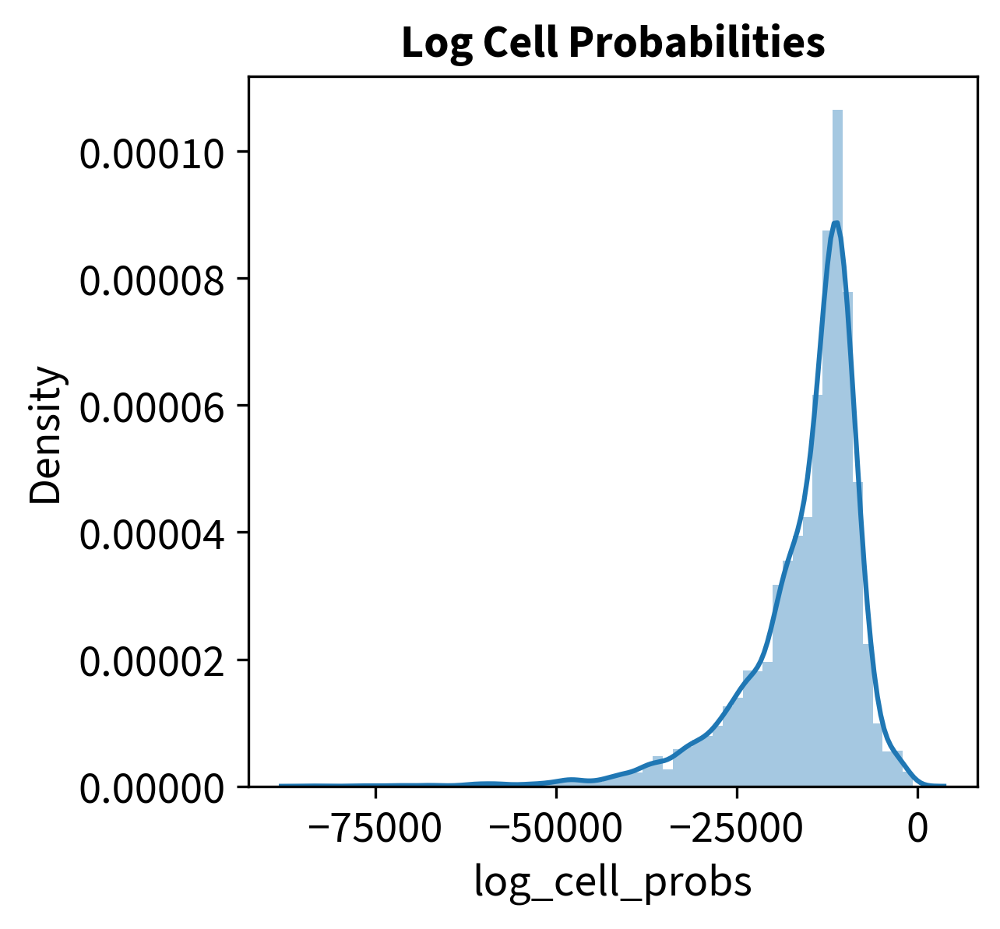

In [14]:
mdata = prefilter_barcodes_mdata(mdata, barcodes=cell_barcodes_cr)

In [15]:
gex = mdata.mod['rna']

## QC & Filtering GEX

### QC & Thresholding Decisions

In [16]:
get_umap_leiden(gex)

normalizing counts per cell
    finished (0:00:00)
computing PCA
    with n_comps=50
    finished (0:00:07)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:59)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: 

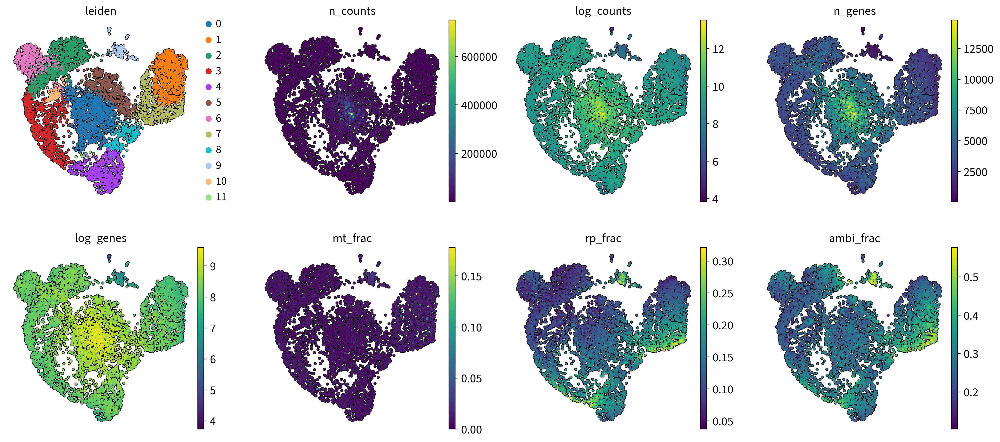

In [17]:
sc.pl.umap(gex, color=['leiden','n_counts','log_counts','n_genes','log_genes','mt_frac','rp_frac', 'ambi_frac'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=4)

#### Mitochondrial Gene Fraction

##### High MT-Gene Fraction

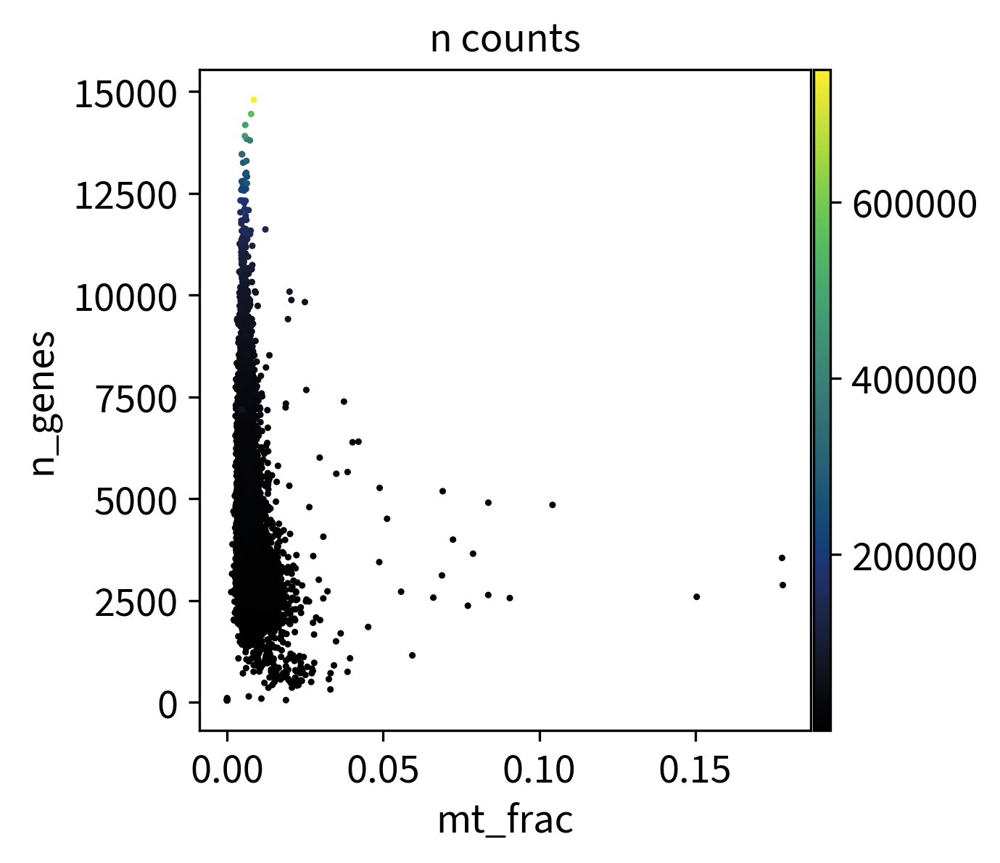

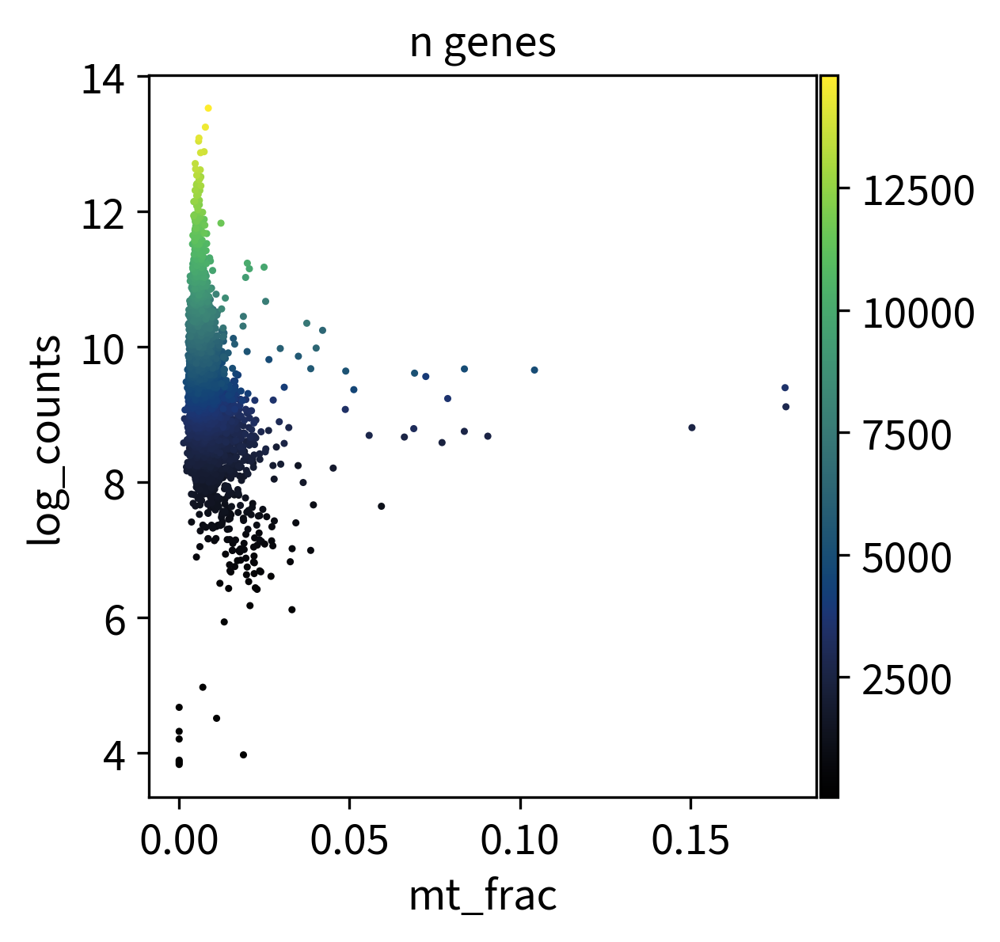

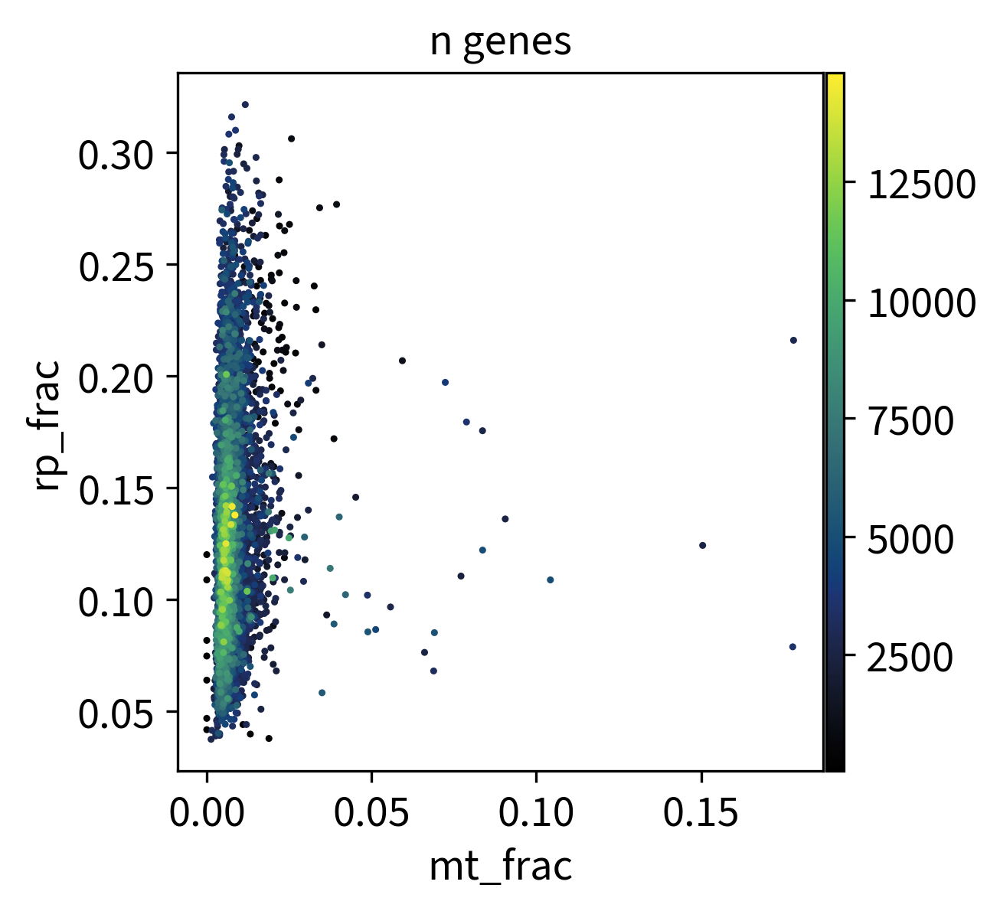

/tmp/ipykernel_980990/162633707.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(gex.obs['mt_frac'], kde=True, bins=60)


<Axes: xlabel='mt_frac', ylabel='Density'>

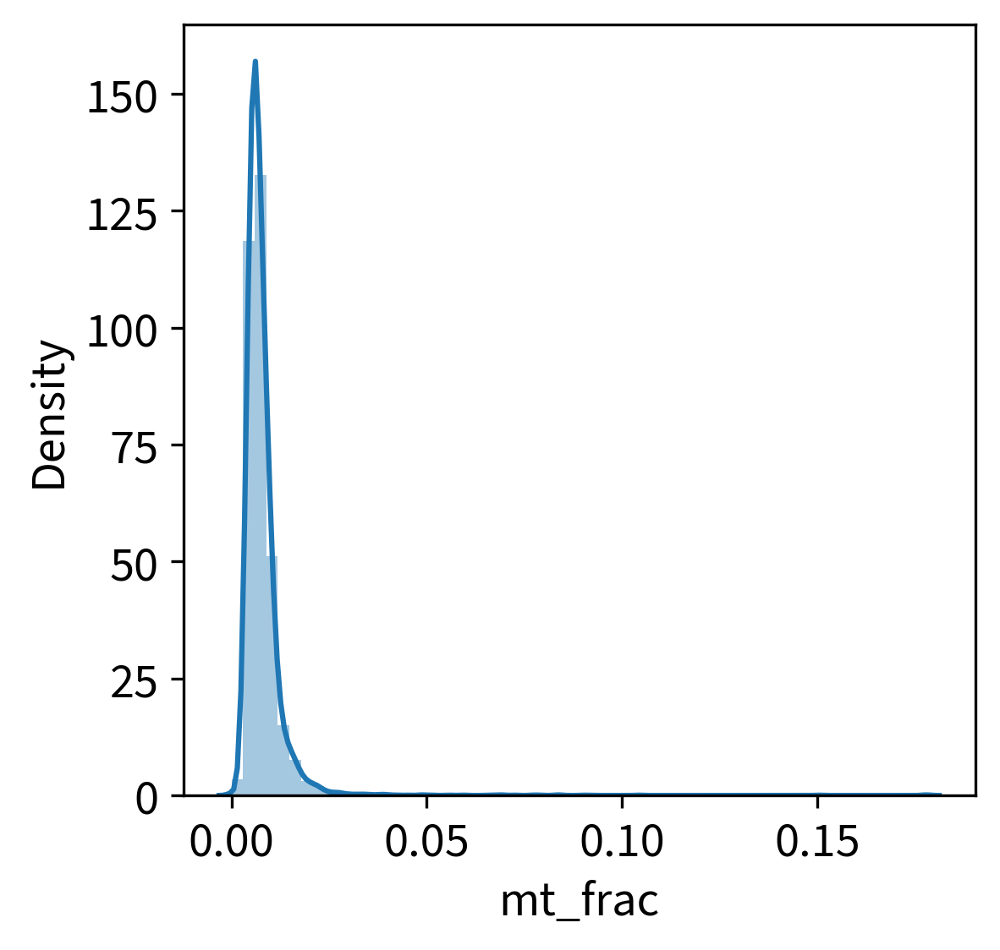

In [18]:
sc.pl.scatter(gex, 'mt_frac', 'n_genes', color='n_counts', color_map=michi_bk_bl_gn_yl)
sc.pl.scatter(gex, 'mt_frac', 'log_counts', color='n_genes', color_map=michi_bk_bl_gn_yl)
sc.pl.scatter(gex, 'mt_frac', 'rp_frac', color='n_genes', color_map=michi_bk_bl_gn_yl)
sb.distplot(gex.obs['mt_frac'], kde=True, bins=60)

In [19]:
max_mito = 0.02
min_mito = 0

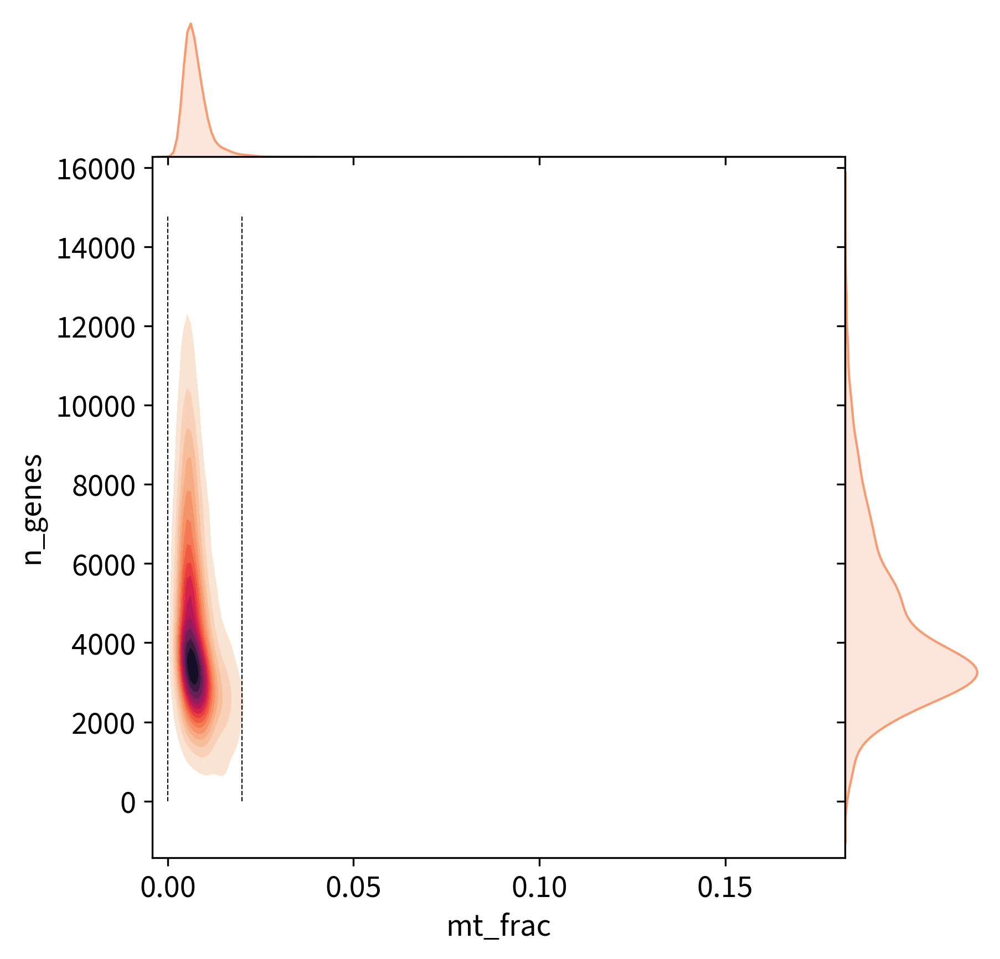

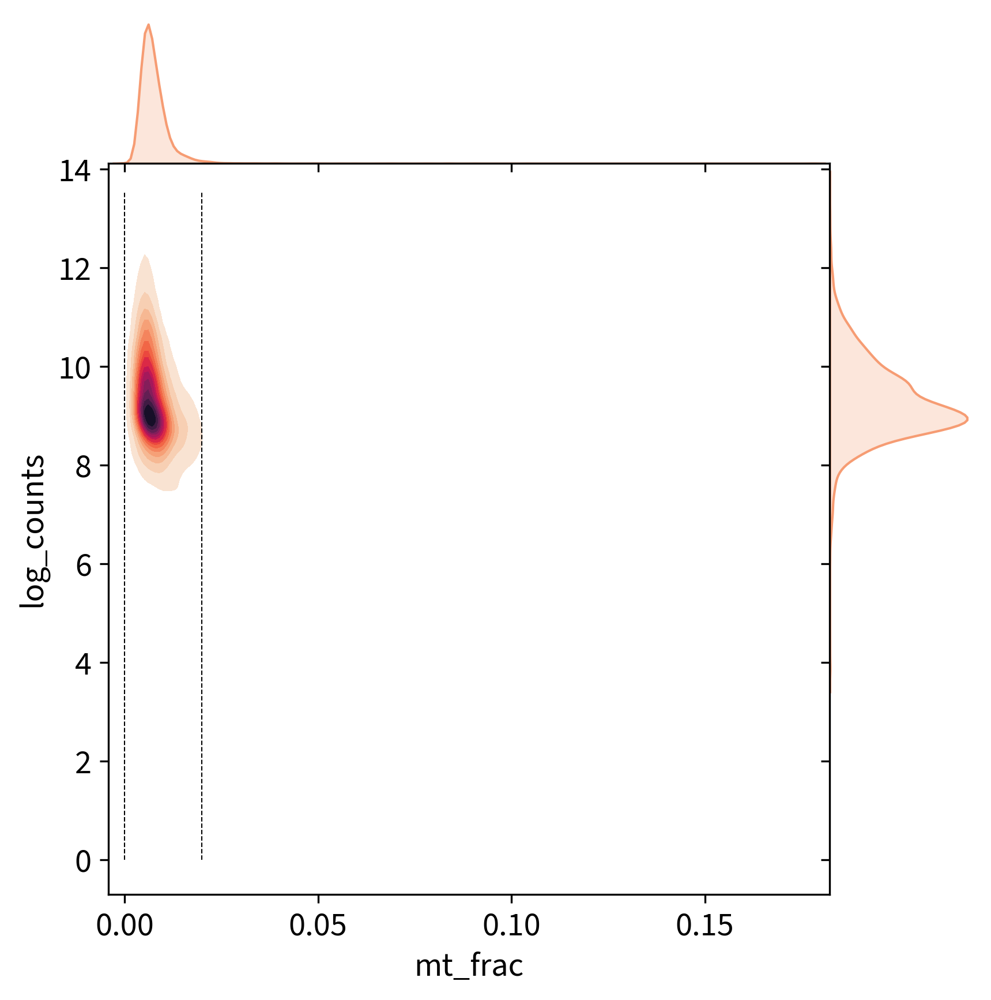

In [20]:
sb.jointplot(x=gex.obs['mt_frac'], y=gex.obs['n_genes'], n_levels=15, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0).ax_joint.vlines(x=[min_mito,max_mito], ymin=[0,0], ymax=[max(gex.obs['n_genes']),max(gex.obs['n_genes'])], color="black", lw=0.5).set_linestyle("--")

sb.jointplot(x=gex.obs['mt_frac'], y=gex.obs['log_counts'], n_levels=15, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0).ax_joint.vlines(x=[min_mito,max_mito], ymin=[0,0], ymax=[max(gex.obs['log_counts']),max(gex.obs['log_counts'])], color="black", lw=0.5).set_linestyle("--")

In [21]:
gex.obs['filter_mt_frac']=pd.Categorical(list(map(str,list((gex.obs['mt_frac'] < max_mito) & (gex.obs['mt_frac'] > min_mito)))))

/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: 

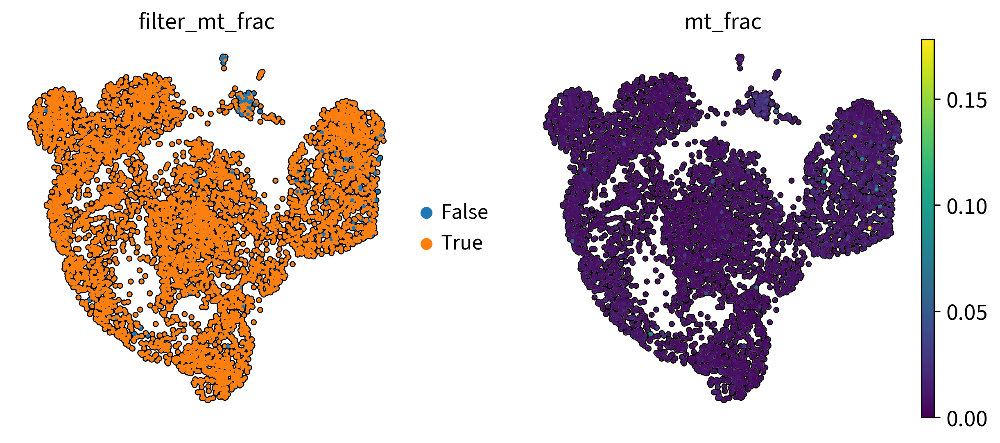

In [22]:
sc.pl.umap(gex, color=['filter_mt_frac','mt_frac'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0))

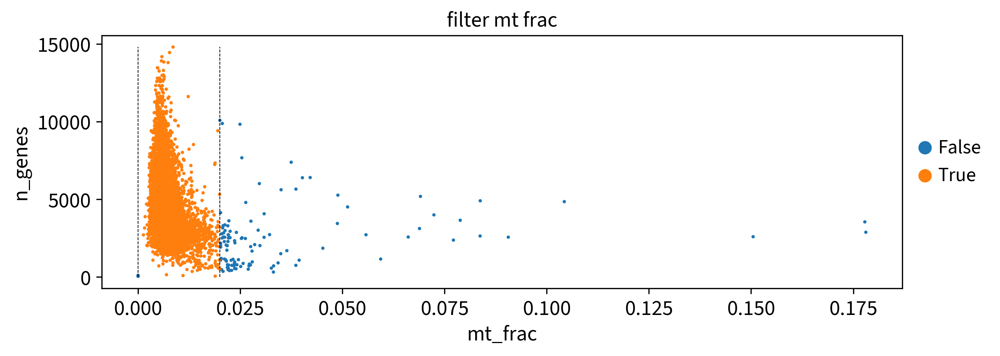

In [23]:
with rc_context({'figure.figsize': (8, 3)}):
    p=sc.pl.scatter(gex, 'mt_frac', 'n_genes', color='filter_mt_frac', color_map=michi_bk_bl_gn_yl, show=False)
    p.vlines(x=[min_mito, max_mito], ymin=[0,0], ymax=[max(gex.obs['n_genes']),max(gex.obs['n_genes'])], color="black", lw=0.5).set_linestyle("--")
    plt.show()

/tmp/ipykernel_980990/1902804307.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(gex.obs['mt_frac'], kde=True, bins=60)


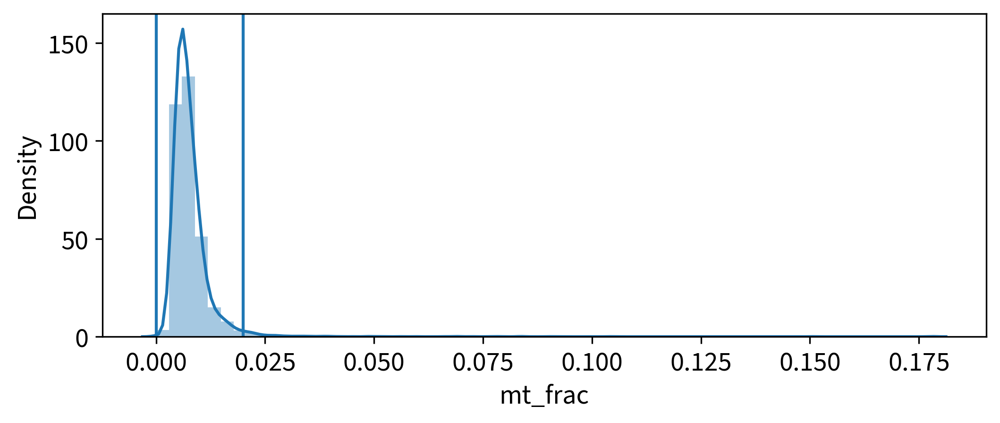

In [24]:
#Thresholding decision: MT-gene fraction
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(gex.obs['mt_frac'], kde=True, bins=60)
    plt.axvline(max_mito, 0, 1)
    plt.axvline(min_mito, 0, 1)

In [25]:
mito_filter = (gex.obs['mt_frac'] < max_mito) & (gex.obs['mt_frac'] > min_mito)

#### Counts

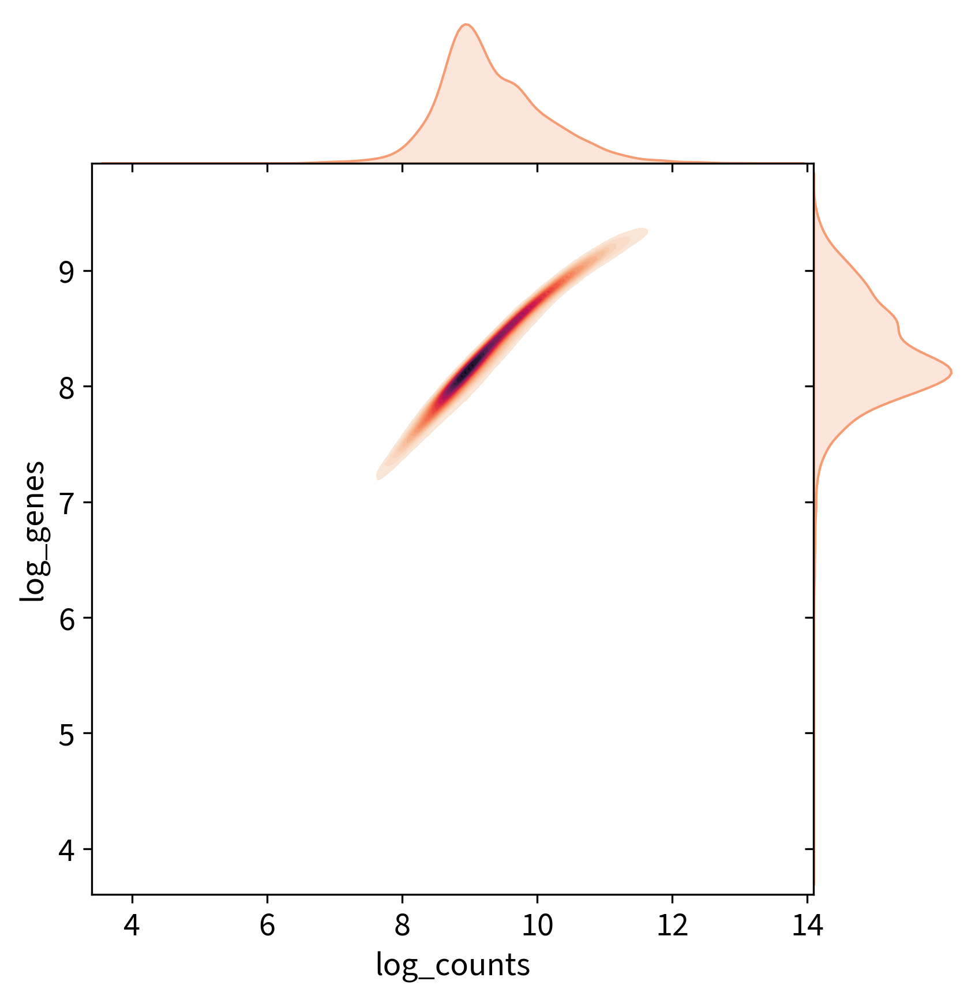

In [26]:
sb.jointplot(x=gex[mito_filter].obs['log_counts'], y=gex[mito_filter].obs['log_genes'], n_levels=30, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0)

/tmp/ipykernel_980990/3944585138.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(gex[mito_filter].obs['n_counts'], kde=True)
/tmp/ipykernel_980990/3944585138.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(gex.obs['n_counts'], kde=True)


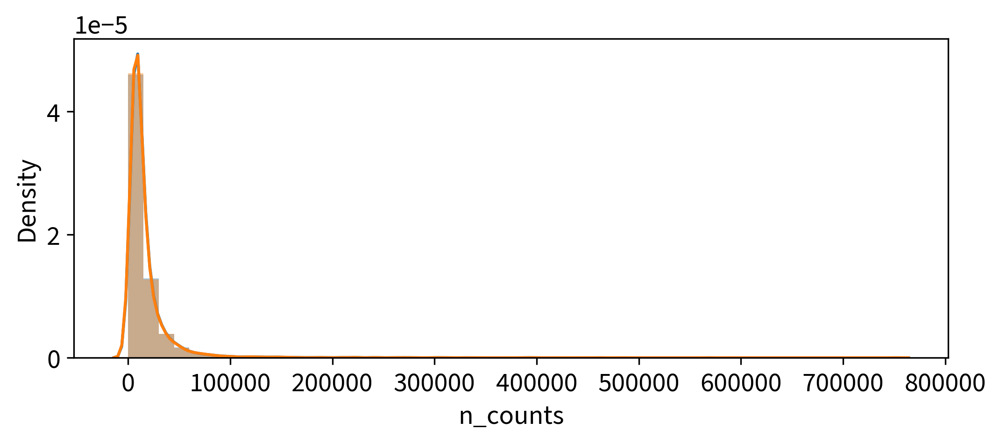

In [27]:
#Thresholding decision: counts
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(gex[mito_filter].obs['n_counts'], kde=True)
    sb.distplot(gex.obs['n_counts'], kde=True)

/tmp/ipykernel_980990/3375395074.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(gex.obs['n_counts'][(gex.obs['n_counts']<x_lim[1]) & mito_filter], kde=True, bins=60)
/tmp/ipykernel_980990/3375395074.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(gex.obs['n_counts'][(gex.obs['n_counts']<x

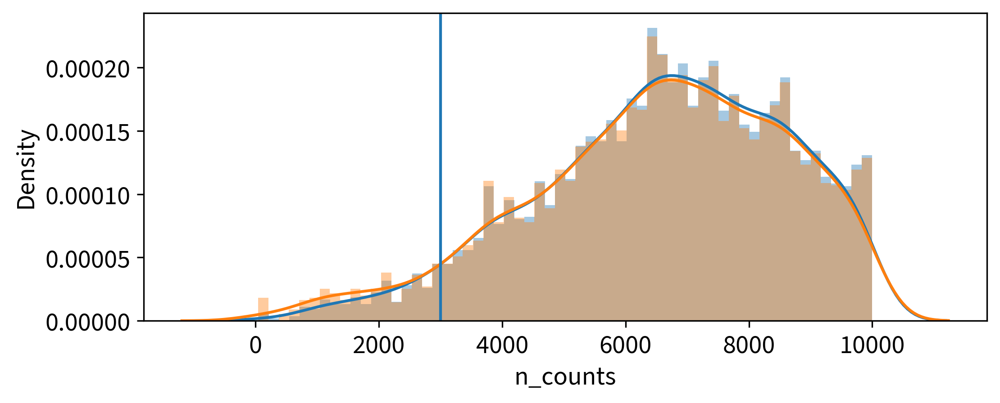

In [28]:
min_counts = 3000
x_lim = [0,10000]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(gex.obs['n_counts'][(gex.obs['n_counts']<x_lim[1]) & mito_filter], kde=True, bins=60)
    sb.distplot(gex.obs['n_counts'][(gex.obs['n_counts']<x_lim[1])], kde=True, bins=60)
    plt.axvline(min_counts, 0, 1)

/tmp/ipykernel_980990/24778742.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(gex.obs['n_counts'][(gex.obs['n_counts']>x_lim[0]) & (gex.obs['n_counts']<x_lim[1]) & mito_filter], kde=True, bins=60)
/tmp/ipykernel_980990/24778742.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(gex.obs['n_co

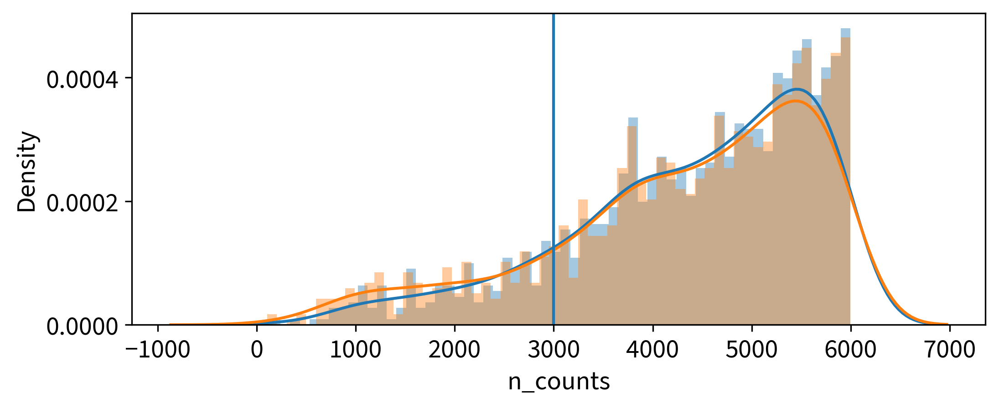

In [29]:
x_lim = [100,6000]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(gex.obs['n_counts'][(gex.obs['n_counts']>x_lim[0]) & (gex.obs['n_counts']<x_lim[1]) & mito_filter], kde=True, bins=60)
    sb.distplot(gex.obs['n_counts'][(gex.obs['n_counts']>x_lim[0]) & (gex.obs['n_counts']<x_lim[1])], kde=True, bins=60)
    plt.axvline(min_counts, 0, 1)

/tmp/ipykernel_980990/3692500838.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(gex.obs['n_counts'][(gex.obs['n_counts']>x_lim[0]) & (gex.obs['n_counts']<x_lim[1]) & mito_filter], kde=True, bins=60)
/tmp/ipykernel_980990/3692500838.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(gex.obs['

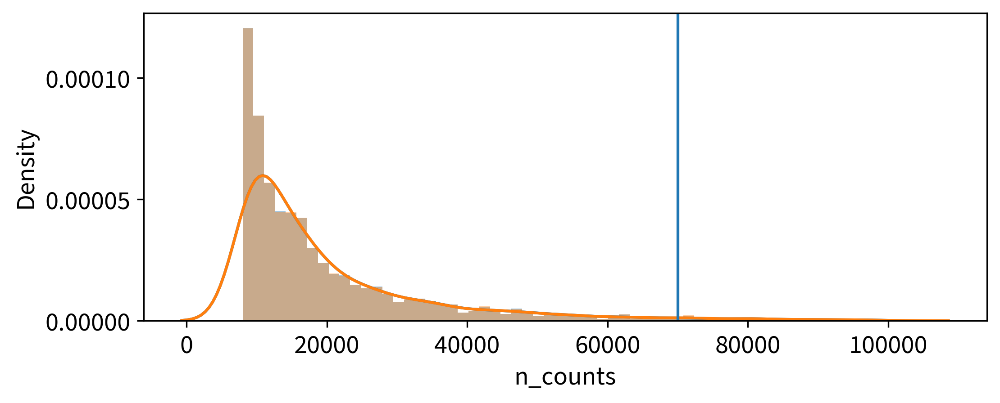

In [30]:
max_counts = 70000
x_lim = [8000,100000]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(gex.obs['n_counts'][(gex.obs['n_counts']>x_lim[0]) & (gex.obs['n_counts']<x_lim[1]) & mito_filter], kde=True, bins=60)
    sb.distplot(gex.obs['n_counts'][(gex.obs['n_counts']>x_lim[0]) & (gex.obs['n_counts']<x_lim[1])], kde=True, bins=60)
    plt.axvline(max_counts, 0, 1)

In [31]:
counts_filter = (gex.obs['n_counts'] > min_counts) & (gex.obs['n_counts'] < max_counts)

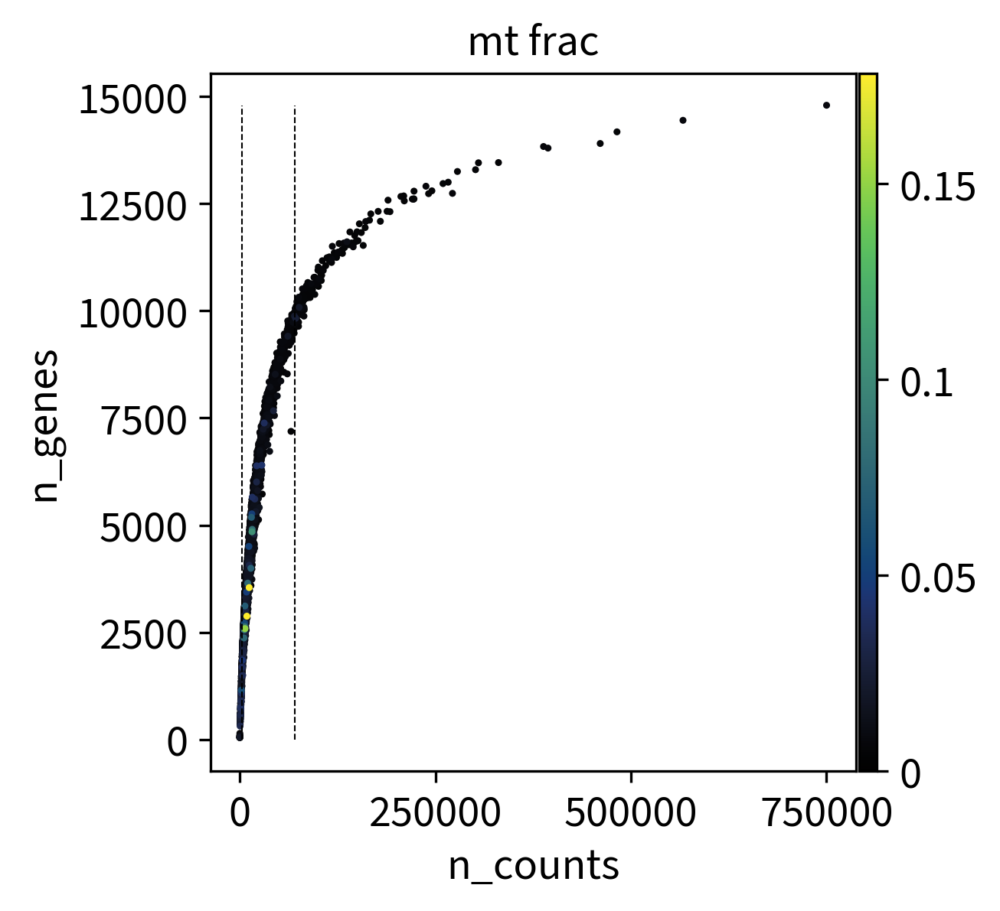

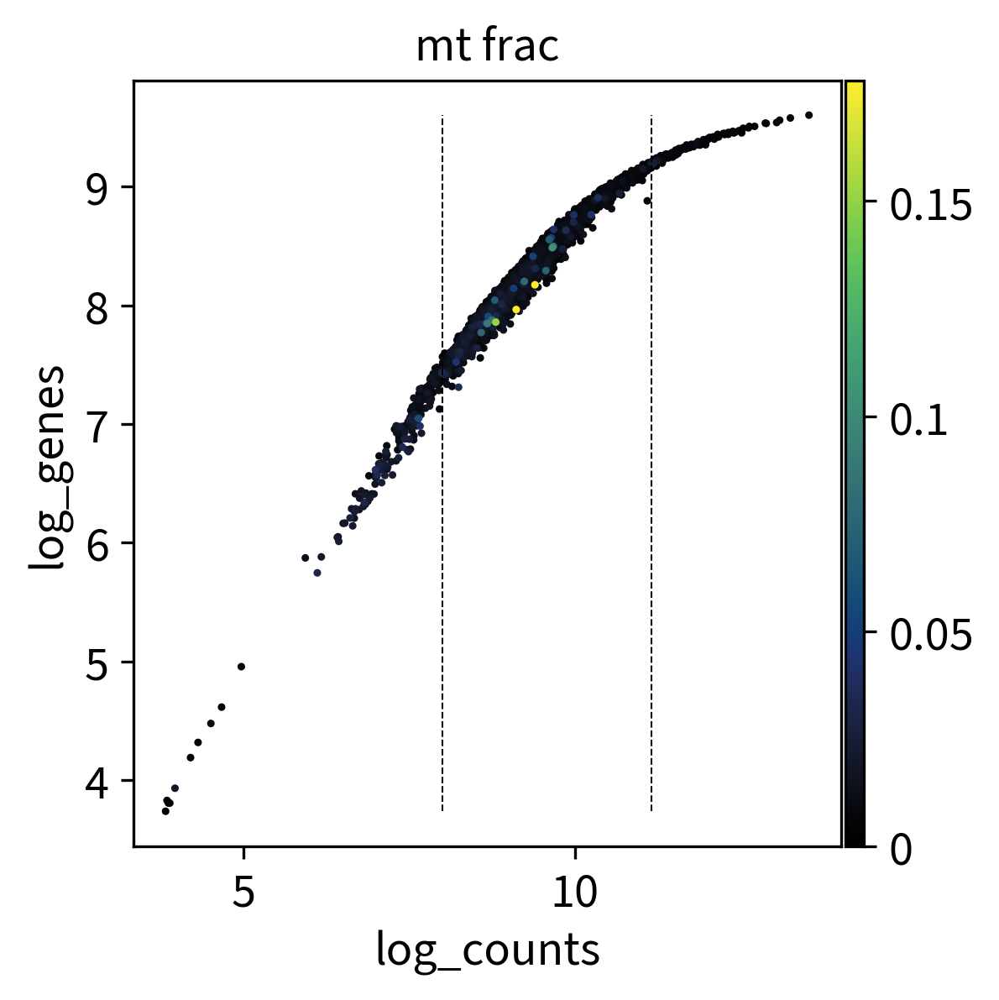

In [32]:
sc.pl.scatter(gex, 'n_counts', 'n_genes', color='mt_frac', color_map=michi_bk_bl_gn_yl, show=False).vlines(x=[min_counts, max_counts], ymin=[0,0], ymax=[max(gex.obs['n_genes']),max(gex.obs['n_genes'])], color="black", lw=0.5).set_linestyle("--")
sc.pl.scatter(gex, 'log_counts', 'log_genes', color='mt_frac', color_map=michi_bk_bl_gn_yl, show=False).vlines(x=[np.log(min_counts), np.log(max_counts)], ymin=[np.log(min(gex.obs['n_genes'])),np.log(min(gex.obs['n_genes']))], ymax=[np.log(max(gex.obs['n_genes'])),np.log(max(gex.obs['n_genes']))], color="black", lw=0.5).set_linestyle("--")

#### Genes

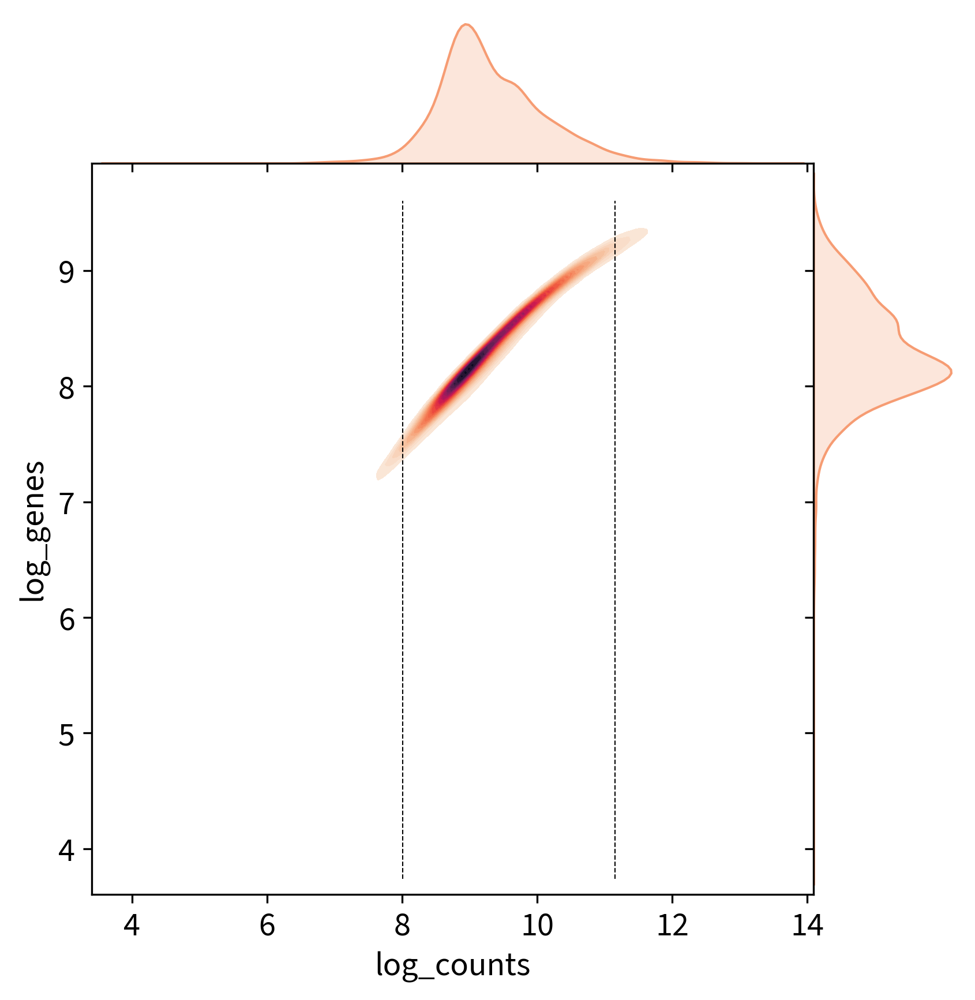

In [33]:
sb.jointplot(x=gex[mito_filter].obs['log_counts'], y=gex[mito_filter].obs['log_genes'], n_levels=30, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0).ax_joint.vlines(x=[np.log(min_counts), np.log(max_counts)], ymin=[np.log(min(gex.obs['n_genes'])),np.log(min(gex.obs['n_genes']))], ymax=[np.log(max(gex.obs['n_genes'])),np.log(max(gex.obs['n_genes']))], color="black", lw=0.5).set_linestyle("--")

/tmp/ipykernel_980990/4081898665.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(gex.obs['n_genes'][mito_filter & counts_filter], kde=True, bins=60)
/tmp/ipykernel_980990/4081898665.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(gex.obs['n_genes'][mito_filter], kde=True, bins=60)
/tmp/ipy

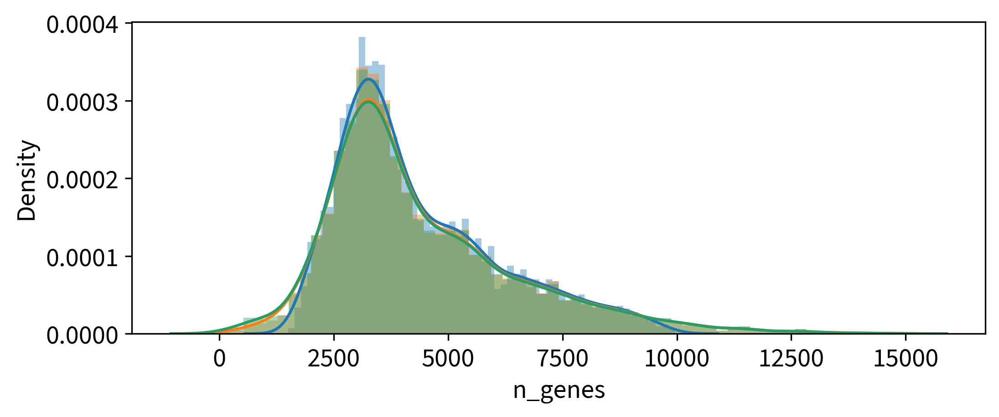

In [34]:
#Thresholding decision: genes
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(gex.obs['n_genes'][mito_filter & counts_filter], kde=True, bins=60)
    sb.distplot(gex.obs['n_genes'][mito_filter], kde=True, bins=60)
    sb.distplot(gex.obs['n_genes'], kde=True, bins=60)

/tmp/ipykernel_980990/3845387068.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(gex.obs['n_genes'][(gex.obs['n_genes']>x_lim[0]) & (gex.obs['n_genes']<x_lim[1])& mito_filter & counts_filter], kde=True, bins=60)
/tmp/ipykernel_980990/3845387068.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distpl

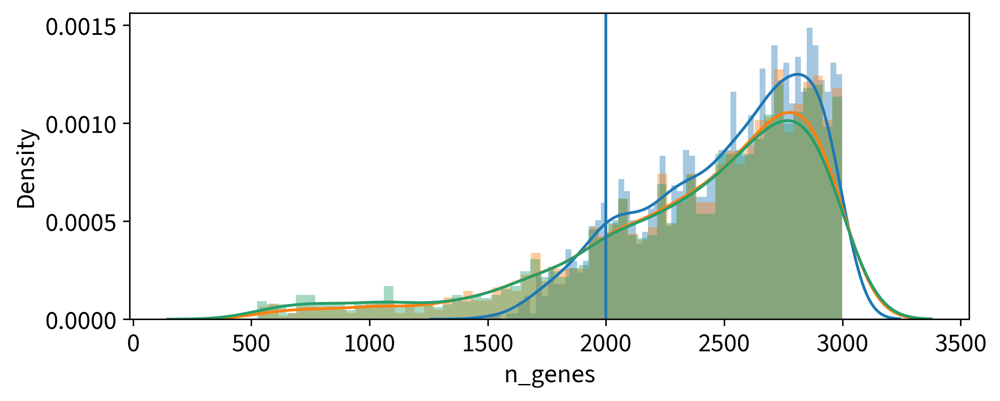

In [35]:
min_genes = 2000
x_lim = [500,3000]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(gex.obs['n_genes'][(gex.obs['n_genes']>x_lim[0]) & (gex.obs['n_genes']<x_lim[1])& mito_filter & counts_filter], kde=True, bins=60)
    sb.distplot(gex.obs['n_genes'][(gex.obs['n_genes']>x_lim[0]) & (gex.obs['n_genes']<x_lim[1])& mito_filter], kde=True, bins=60)
    sb.distplot(gex.obs['n_genes'][(gex.obs['n_genes']>x_lim[0]) & (gex.obs['n_genes']<x_lim[1])], kde=True, bins=60)
    plt.axvline(min_genes, 0, 1)

/tmp/ipykernel_980990/4286471801.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(gex.obs['n_genes'][(gex.obs['n_genes']>x_lim[0]) & (gex.obs['n_genes']<x_lim[1]) & mito_filter & counts_filter], kde=True, bins=100)
/tmp/ipykernel_980990/4286471801.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.dist

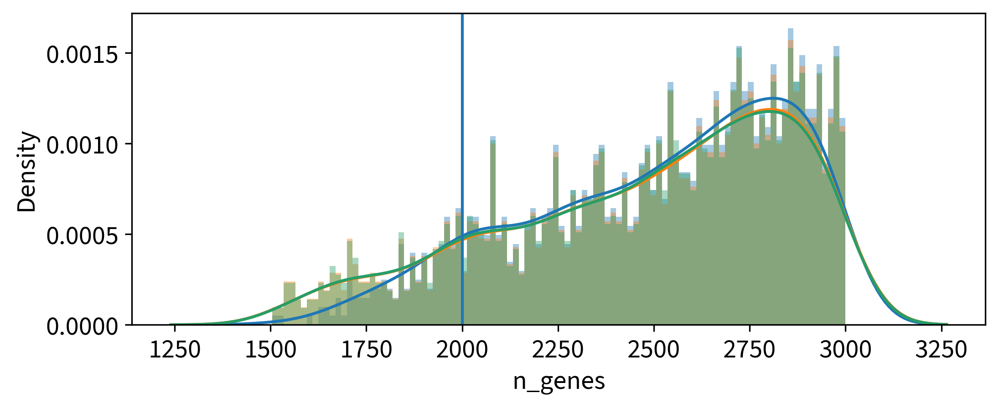

In [36]:
x_lim = [1500,3000]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(gex.obs['n_genes'][(gex.obs['n_genes']>x_lim[0]) & (gex.obs['n_genes']<x_lim[1]) & mito_filter & counts_filter], kde=True, bins=100)
    sb.distplot(gex.obs['n_genes'][(gex.obs['n_genes']>x_lim[0]) & (gex.obs['n_genes']<x_lim[1]) & mito_filter], kde=True, bins=100)
    sb.distplot(gex.obs['n_genes'][(gex.obs['n_genes']>x_lim[0]) & (gex.obs['n_genes']<x_lim[1])], kde=True, bins=100)
    plt.axvline(min_genes, 0, 1)

In [37]:
genes_filter = (gex.obs['n_genes'] > min_genes)

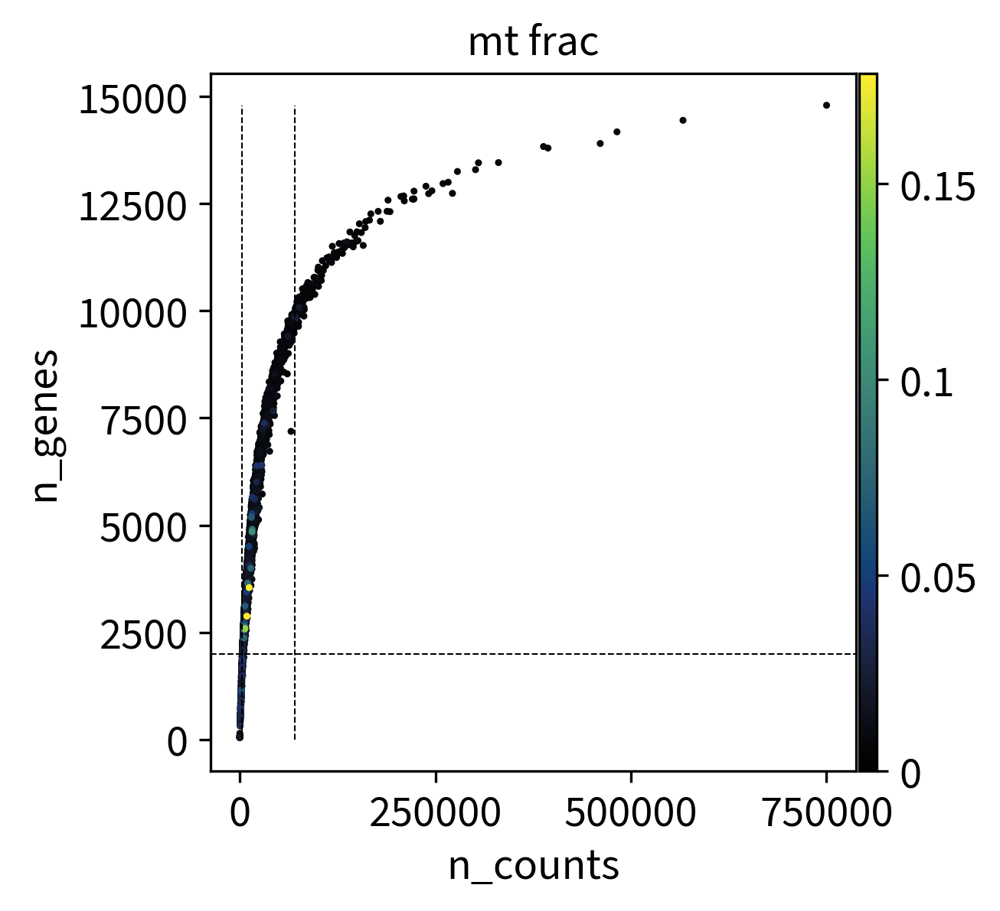

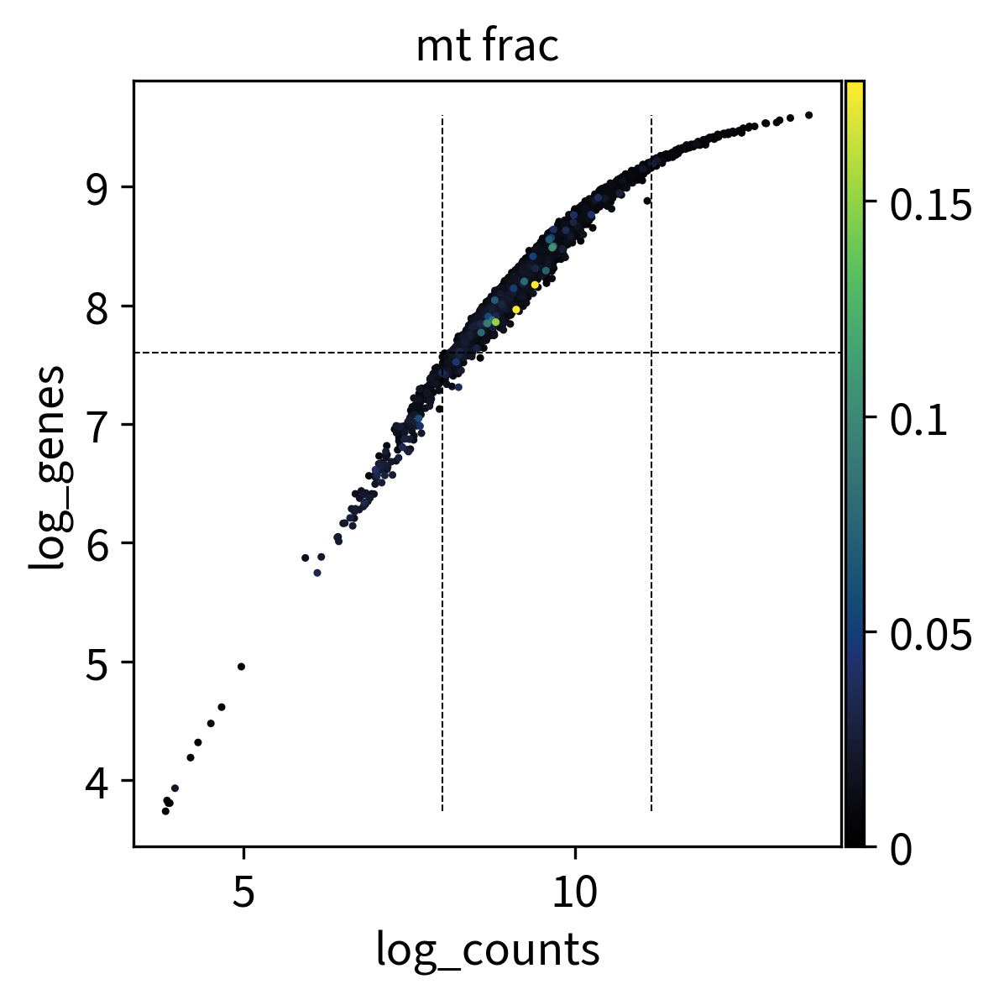

In [38]:
p=sc.pl.scatter(gex, 'n_counts', 'n_genes', color='mt_frac', color_map=michi_bk_bl_gn_yl, show=False)
p.vlines(x=[min_counts, max_counts], ymin=[0,0], ymax=[max(gex.obs['n_genes']),max(gex.obs['n_genes'])], color="black", lw=0.5).set_linestyle("--")
p.axhline(y=min_genes, xmin=0, xmax=max(gex.obs['n_counts']), color="black", lw=0.5).set_linestyle("--")
plt.show()

p=sc.pl.scatter(gex, 'log_counts', 'log_genes', color='mt_frac', color_map=michi_bk_bl_gn_yl, show=False)
p.vlines(x=[np.log(min_counts), np.log(max_counts)], ymin=[np.log(min(gex.obs['n_genes'])),np.log(min(gex.obs['n_genes']))], ymax=[np.log(max(gex.obs['n_genes'])),np.log(max(gex.obs['n_genes']))], color="black", lw=0.5).set_linestyle("--")
p.axhline(y=np.log(min_genes), color="black", lw=0.5).set_linestyle("--")
plt.show()

### Filtering

In [39]:
qc_filter = counts_filter & genes_filter & mito_filter
gex.obs['filtered_cells']=pd.Categorical(list(map(str,list(qc_filter))))

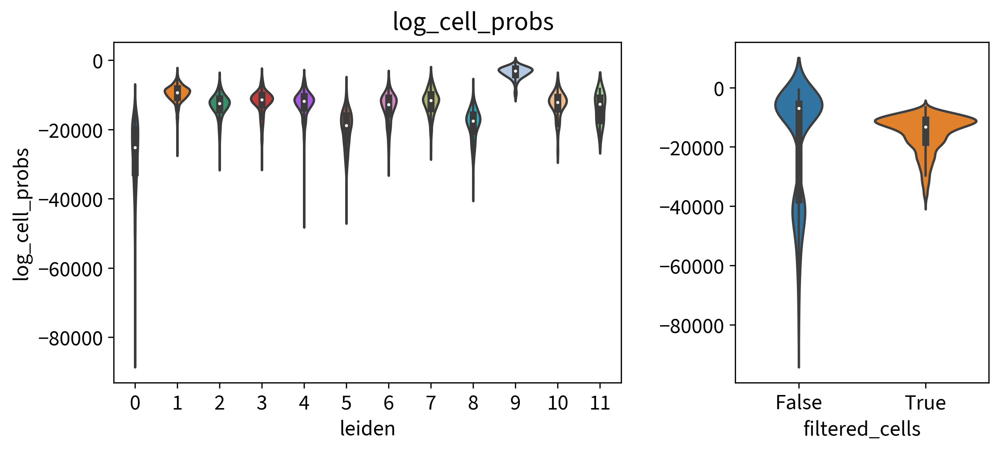

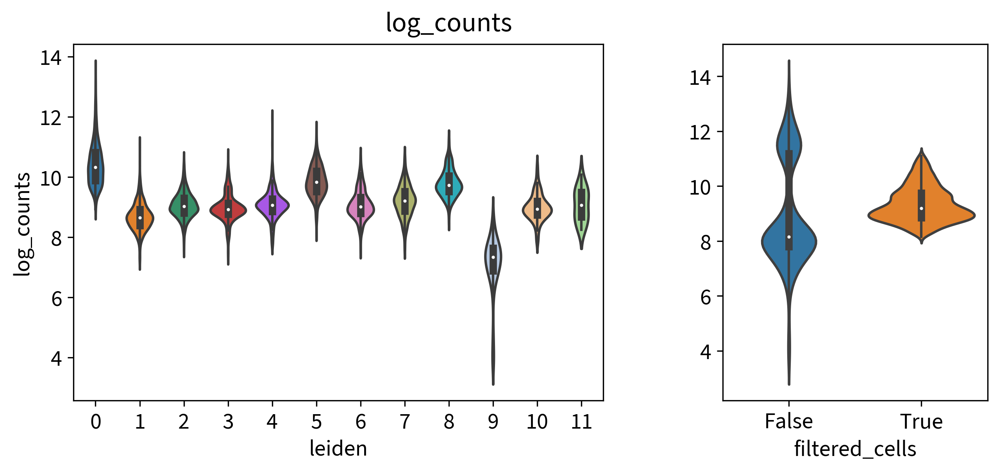

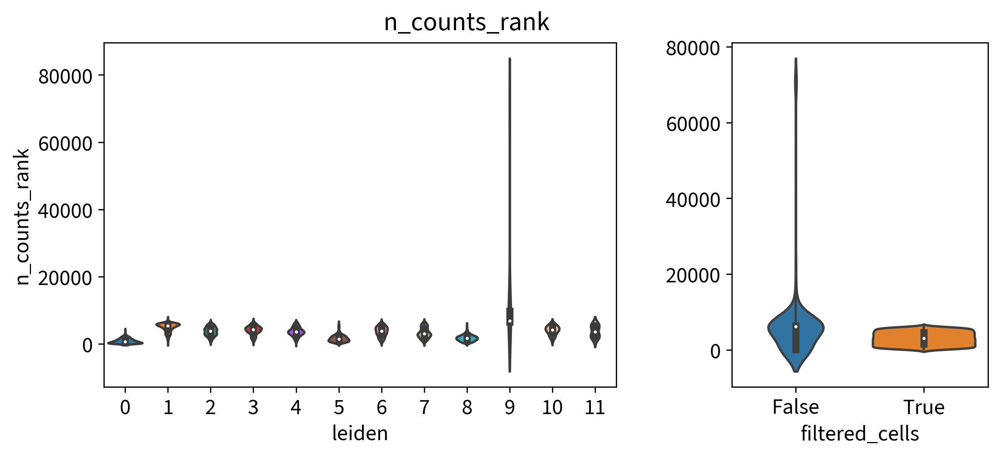

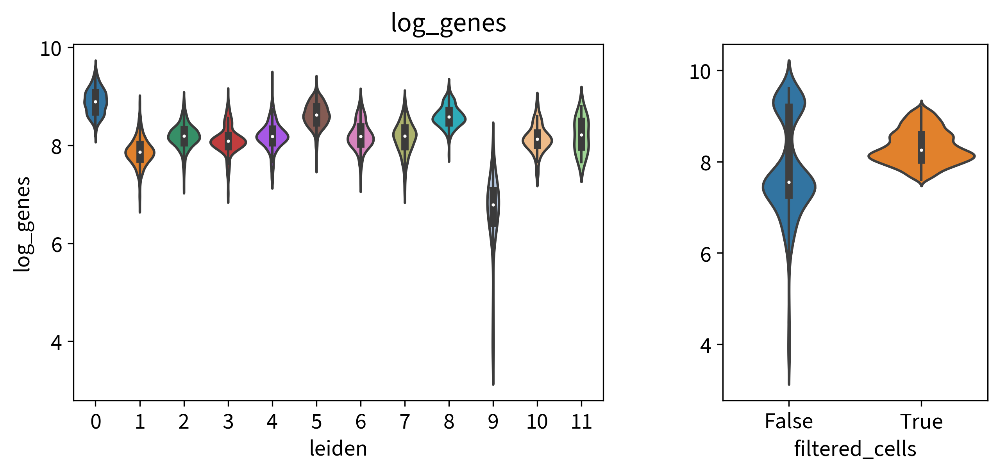

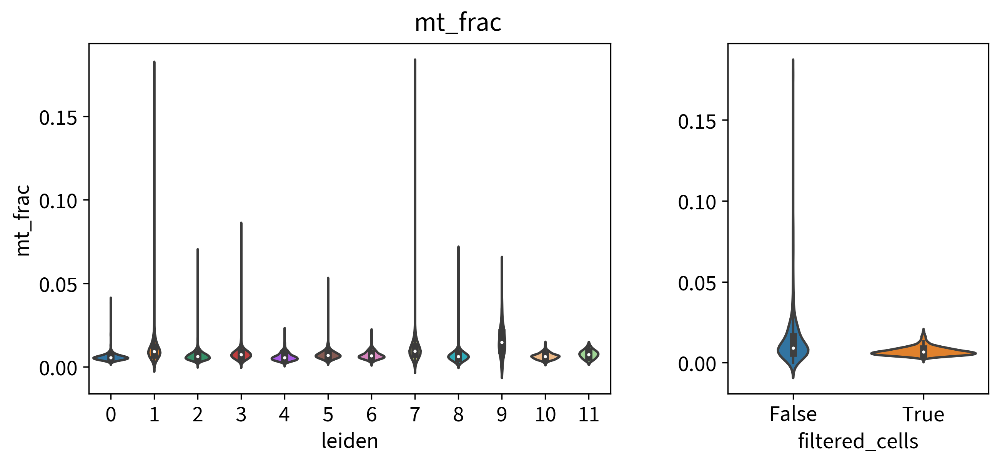

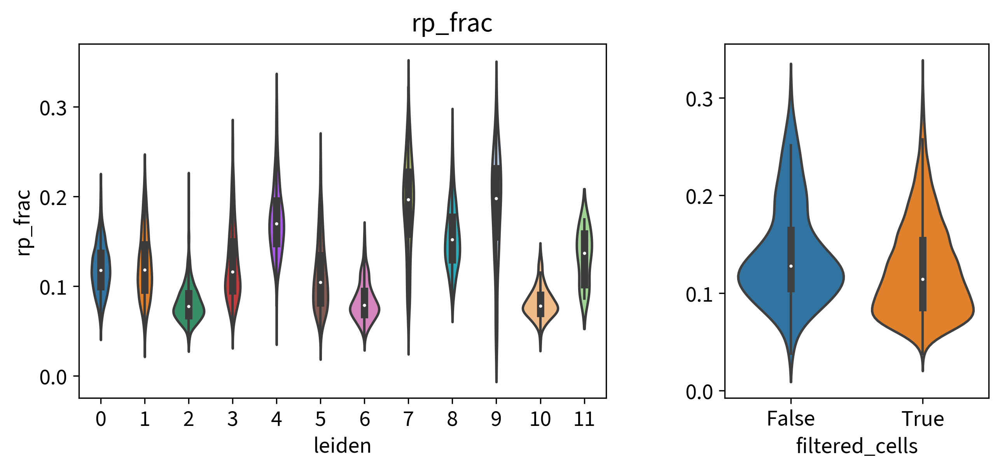

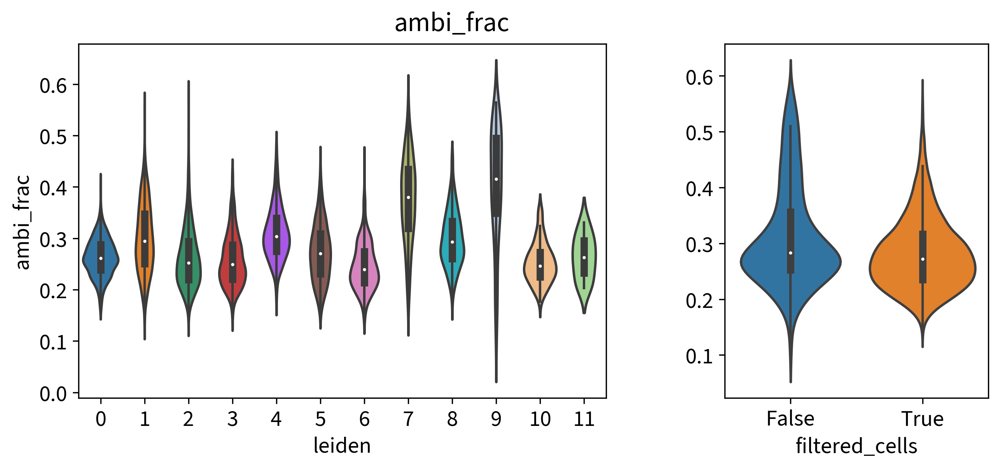

In [40]:
for col in ['log_cell_probs', 'log_counts', 'n_counts_rank', 'log_genes', 'mt_frac', 'rp_frac', 'ambi_frac']:
    fig, axes = plt.subplots(1,2, figsize=(10, 4), gridspec_kw=dict(width_ratios=[2,1],wspace = 0.3))
    
    sb.violinplot(x='leiden', y=col, data=gex.obs, ax=axes[0])
    
    sb.violinplot(x='filtered_cells', y=col, data=gex.obs, ax=axes[1])
    axes[1].set_ylabel(None)
    fig.suptitle(col)

/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(


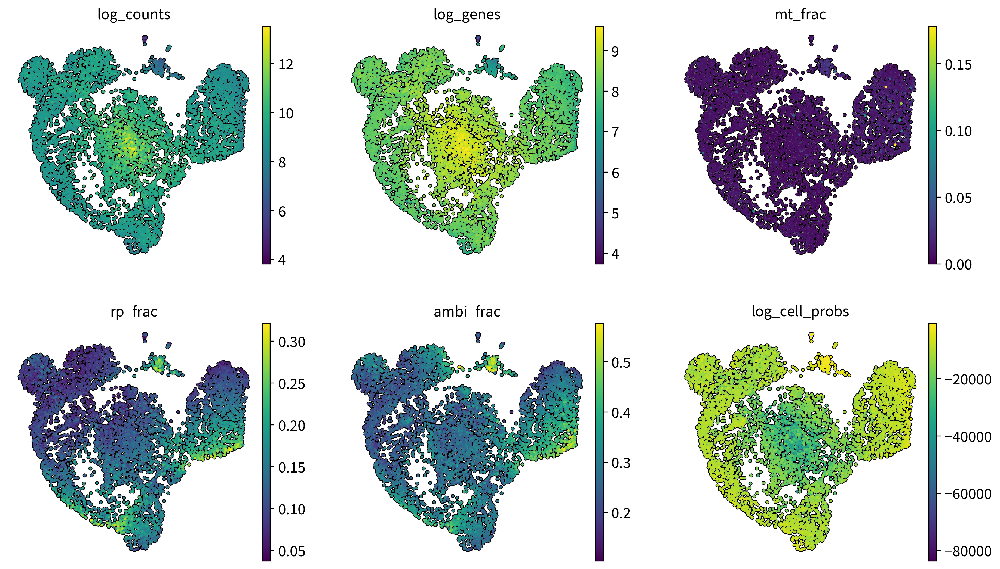

/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data 

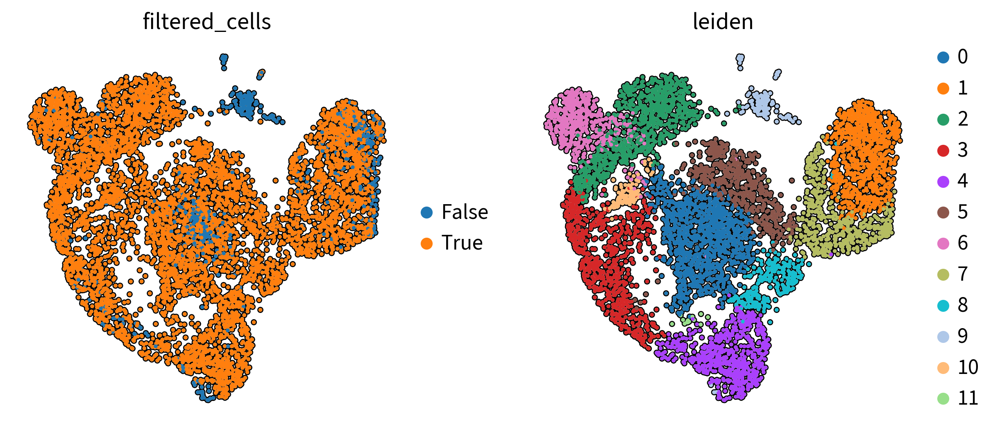

/tmp/ipykernel_980990/2689245316.py:25: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.axes.set_xticklabels(labels=labels, rotation=90)


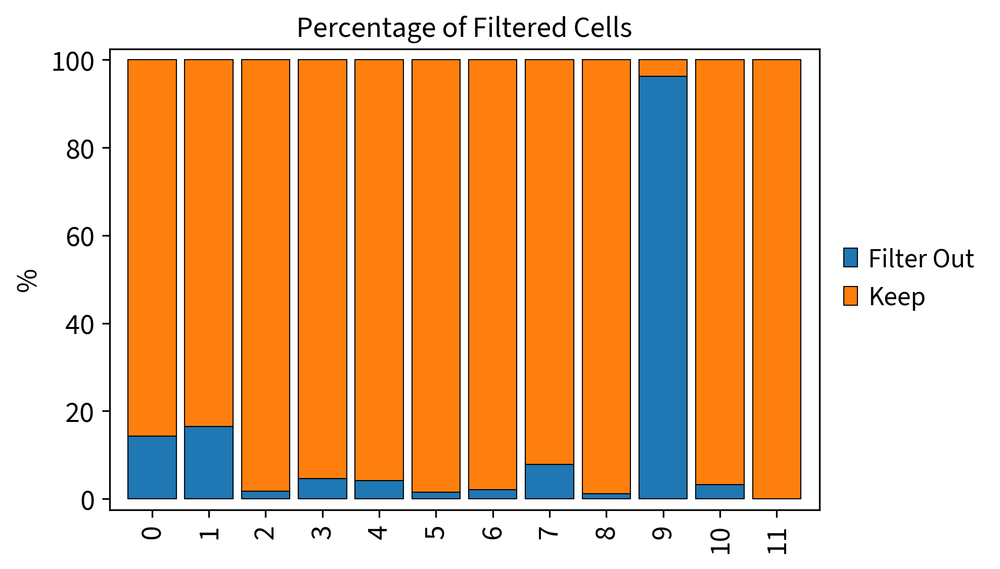

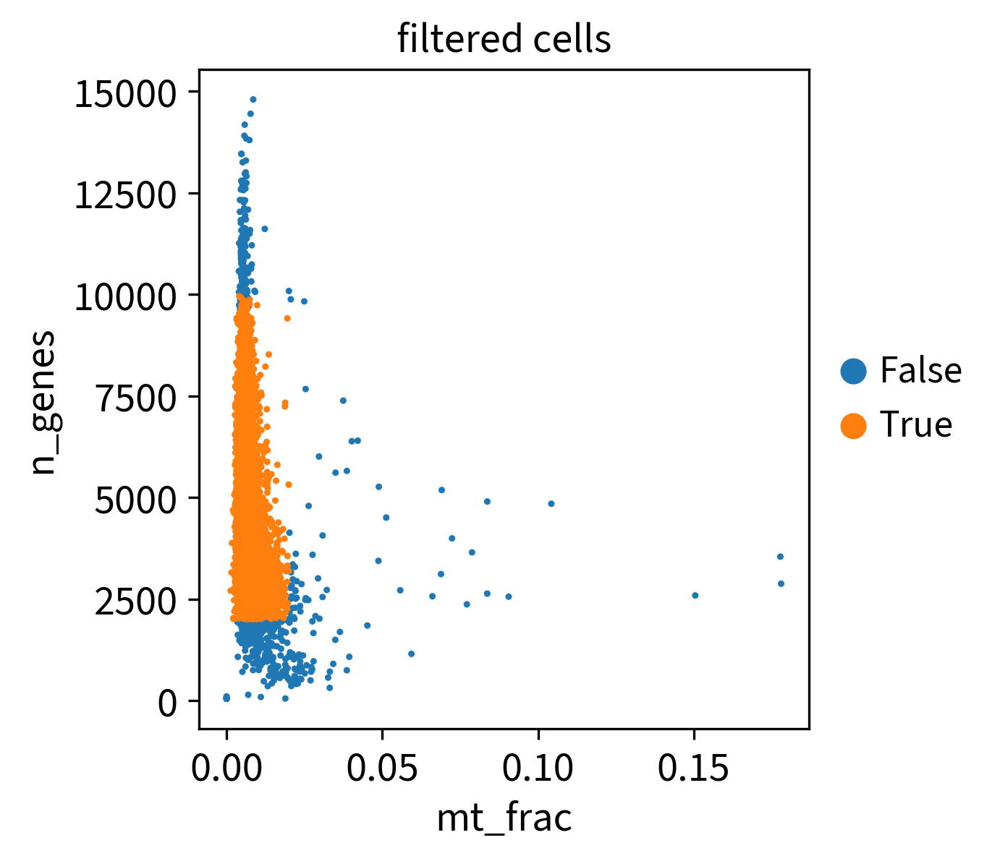

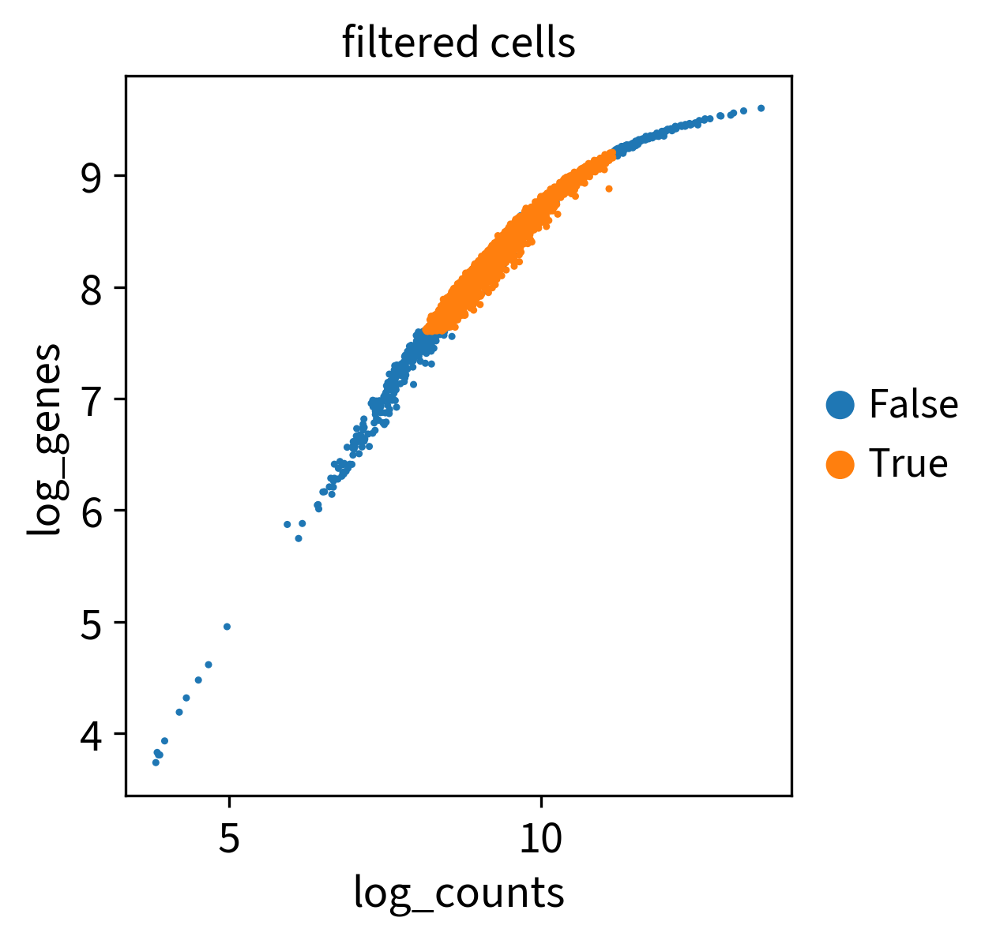

In [41]:
sc.pl.umap(gex, color=['log_counts','log_genes','mt_frac','rp_frac','ambi_frac','log_cell_probs'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=3)
sc.pl.umap(gex, color=['filtered_cells','leiden'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=6)

###############################################################################
###############################################################################

with rc_context({'figure.figsize': (6, 4)}): #rcParams['figure.figsize']=(6,4)
    key = 'leiden'
    labels = list(gex.obs[key].cat.categories)
    keep_pct = []
    filter_pct = []
    width = 0.85       # the width of the bars: can also be len(x) sequence

    for label in labels:
        keep_pct = keep_pct + [gex.obs['filtered_cells'][gex.obs[key]==label].value_counts()['True']/gex.obs['filtered_cells'][gex.obs[key]==label].value_counts().sum()*100]
        filter_pct = filter_pct + [gex.obs['filtered_cells'][gex.obs[key]==label].value_counts()['False']/gex.obs['filtered_cells'][gex.obs[key]==label].value_counts().sum()*100]

    fig, ax = plt.subplots()

    ax.bar(labels, filter_pct, width, label='Filter Out', edgecolor='0', linewidth=0.5)
    ax.bar(labels, keep_pct, width, bottom=filter_pct, label='Keep', edgecolor='0', linewidth=0.5)

    ax.set_ylabel('%')
    ax.set_title('Percentage of Filtered Cells')
    ax.axes.set_xticklabels(labels=labels, rotation=90)
    ax.legend(bbox_to_anchor=(1, .5),loc='center left', edgecolor='1')

    plt.ylim([-2.5,100+2.5])
    plt.xlim([-1+0.25,len(labels)-0.25])

    plt.show()

#################################################################################
#################################################################################

sc.pl.scatter(gex, 'mt_frac', 'n_genes', color='filtered_cells')
sc.pl.scatter(gex, 'log_counts', 'log_genes', color='filtered_cells')

#### Filter

In [42]:
# Filter cells according to identified QC thresholds:
gex = qc_filter_mdata(mdata, gex, modality='rna', qc_filter=qc_filter)

Filtered out 574 cells (9.0 %).
Number of cells after filter: 5776


In [43]:
del gex.obs['filtered_cells']
del gex.obs['filter_mt_frac']
#del gex.obs['low_mt_frac']

#### Plot Results

In [44]:
get_umap_leiden(gex)

normalizing counts per cell
    finished (0:00:00)
computing PCA
    with n_comps=50
    finished (0:00:06)
computing neighbors
    using 'X_pca' with n_pcs = 50
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:00)
running Leiden clustering
    finished: found 12 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:01)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:05)


/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(


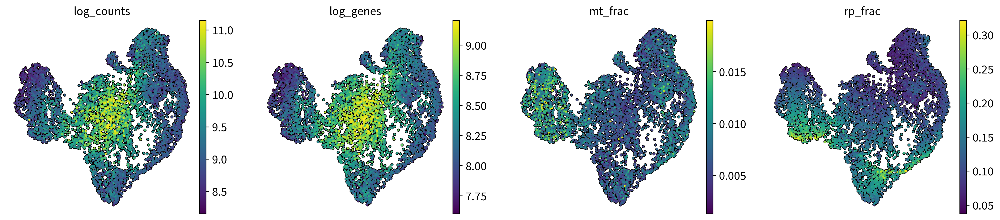

In [45]:
sc.pl.umap(gex, color=['log_counts','log_genes','mt_frac','rp_frac'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=5)

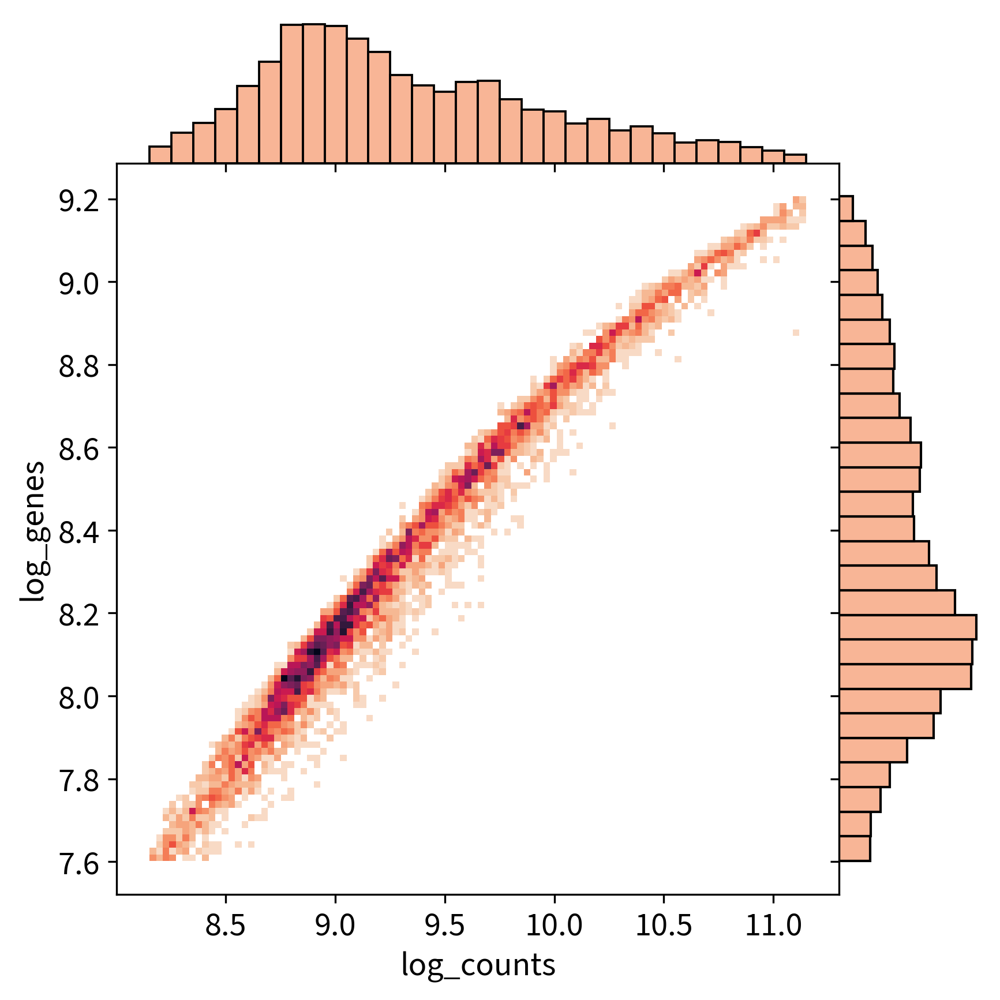

In [46]:
sb.jointplot(
    data=gex.obs,
    x="log_counts",
    y="log_genes",
    kind="hist", bins=100, cmap="rocket_r", color="#f69c73", space=0
)

# Preprocessing ATAC

## QC & Filtering ATAC

In [47]:
# retain only cell passing GEX QC
mu.pp.intersect_obs(mdata)

In [48]:
# ATAC
atac = mdata.mod['atac']
atac.var_names_make_unique()

# add umap
atac.obsm['X_umap'] = gex.obsm['X_umap']
atac.obs['leiden'] = gex.obs['leiden']

In [49]:
atac

AnnData object with n_obs × n_vars = 5776 × 181639
    obs: 'sample', 'name', 'stage', 'stage_num', 'int_id', 'seq_id_gex_id', 'seq_id_atac', 'reporter', 'experiment_batch', 'sequencing_batch', 'leiden'
    var: 'gene_ids', 'feature_types', 'genome', 'interval'
    uns: 'atac', 'files'
    obsm: 'X_umap'

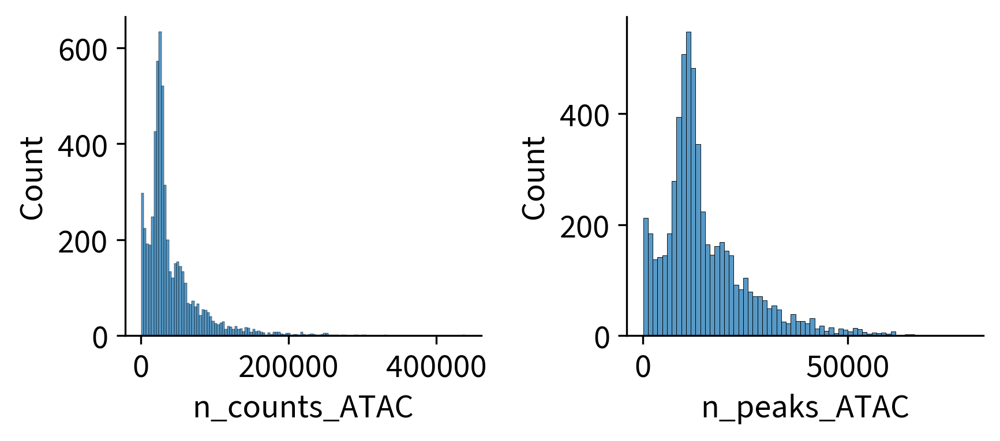

[W::hts_idx_load3] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/atac_fragments.tsv.gz.tbi
Reading Fragments: 100%|██████████| 1000000/1000000 [00:02<00:00, 416692.81it/s]

Added a "nucleosome_signal" column to the .obs slot of the AnnData object



[W::hts_idx_load3] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/atac_fragments.tsv.gz.tbi
Fetching Regions...: 100%|████████████████████████| 1/1 [00:03<00:00,  3.21s/it]


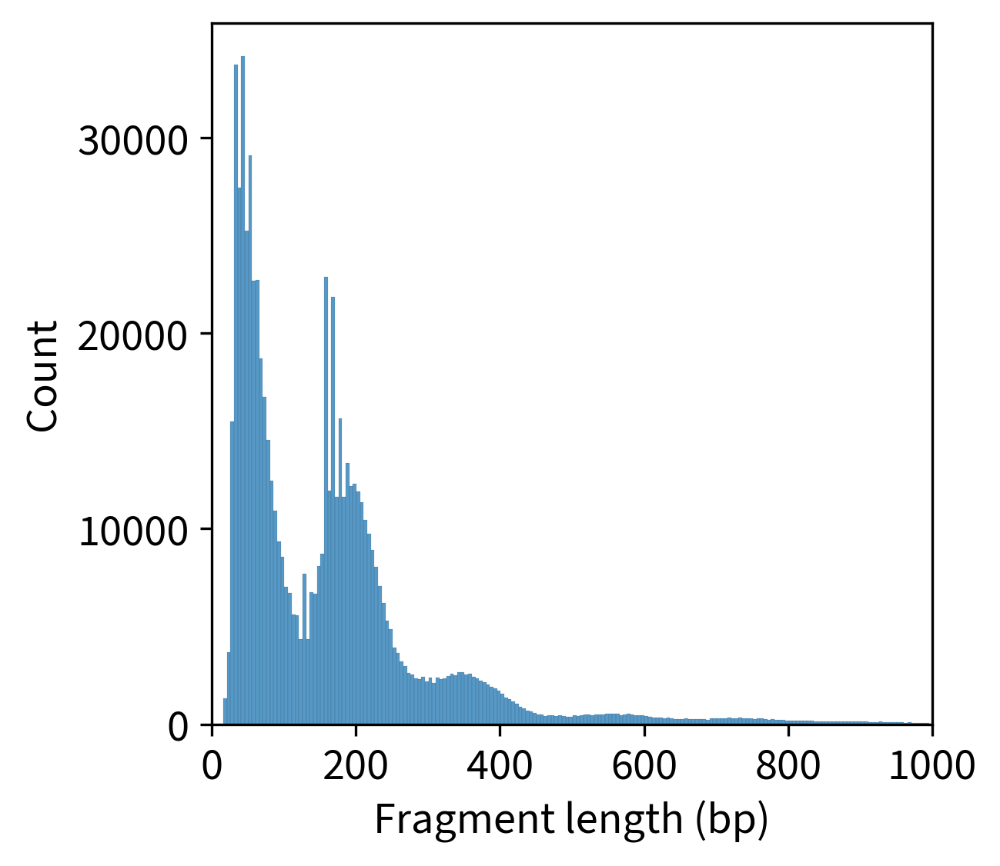

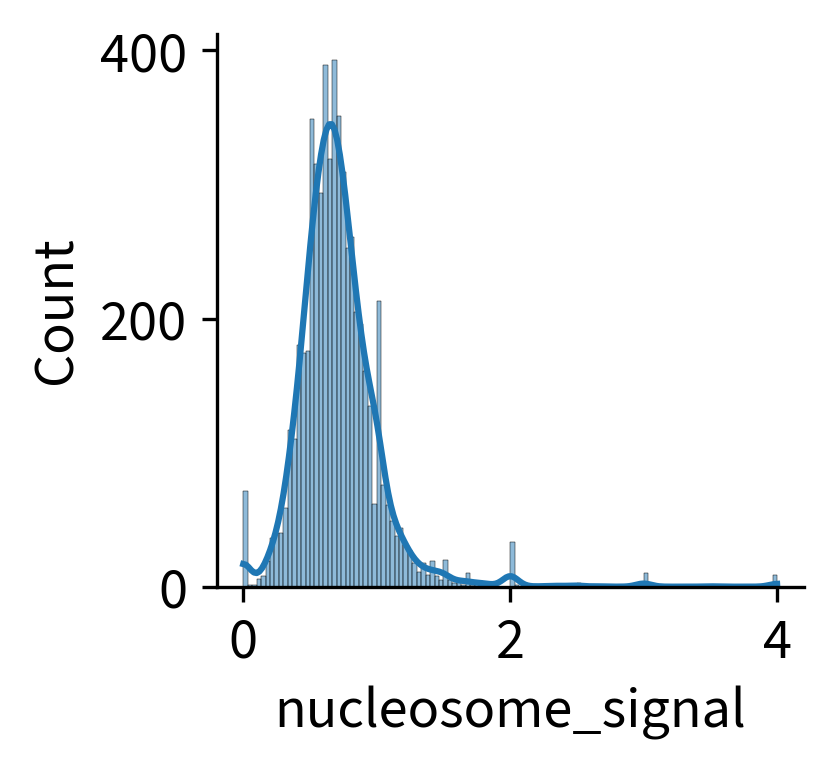

[W::hts_idx_load3] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/atac_fragments.tsv.gz.tbi
Fetching Regions...: 100%|██████████████████| 1999/1999 [00:45<00:00, 43.54it/s]

Added a "tss_score" column to the .obs slot of tof the 'atac' modality


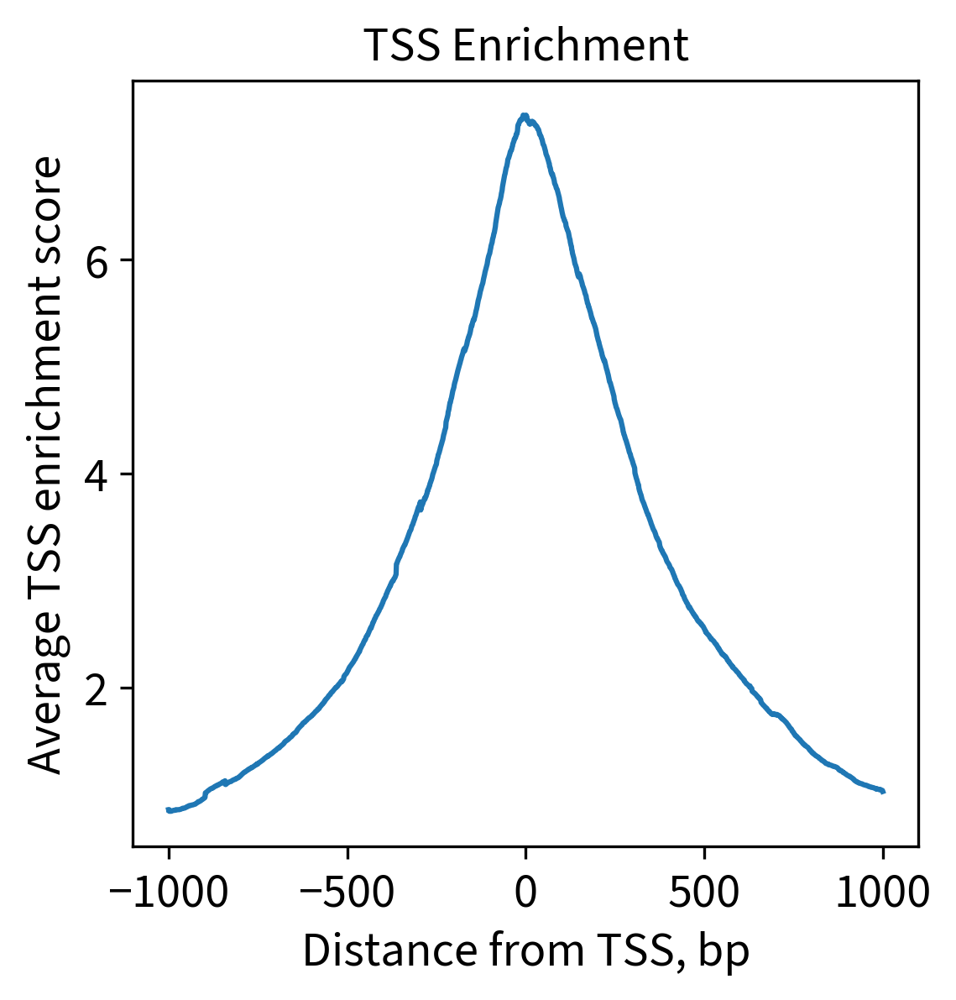

In [51]:
atac_qc_metrics(atac, mdata, n_tss=2000, gtf_path='/mnt/ssd/Genomes/mm10/Mus_musculus.GRCm38.102.gtf')

<Axes: title={'center': 'log counts ATAC'}, xlabel='tss_score', ylabel='nucleosome_signal'>

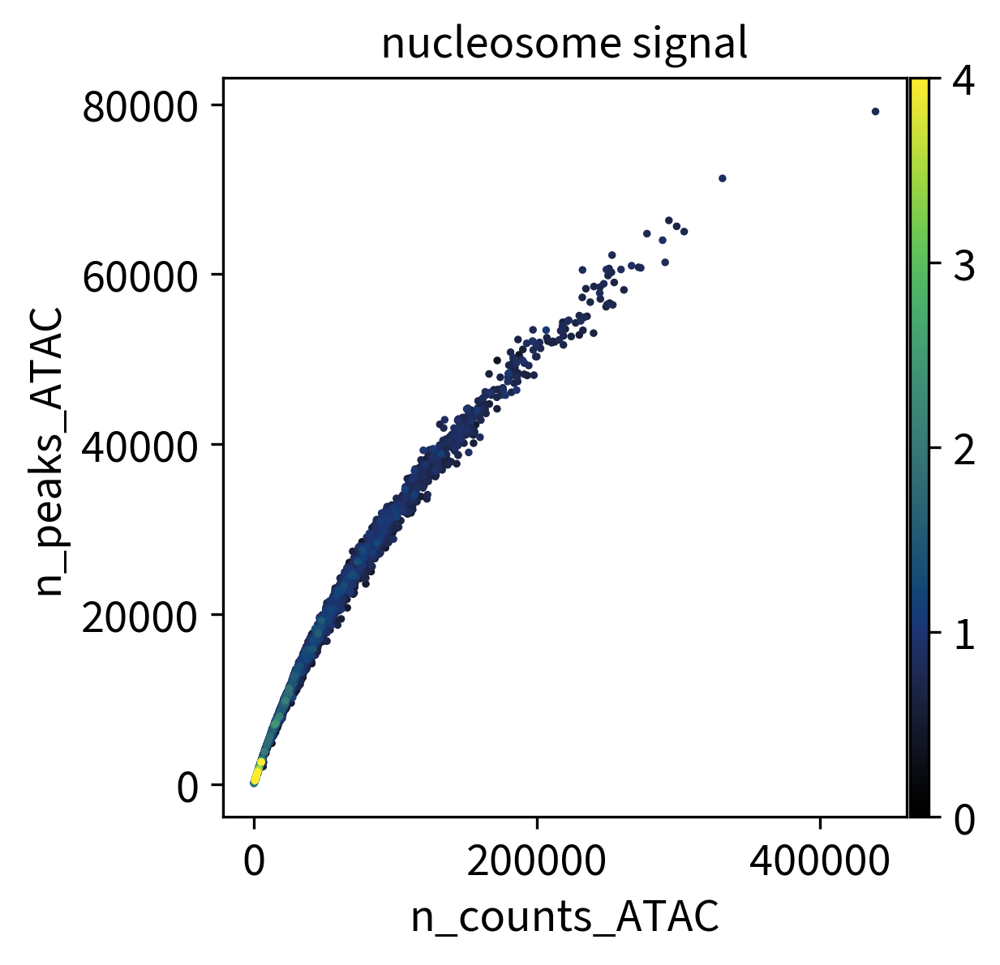

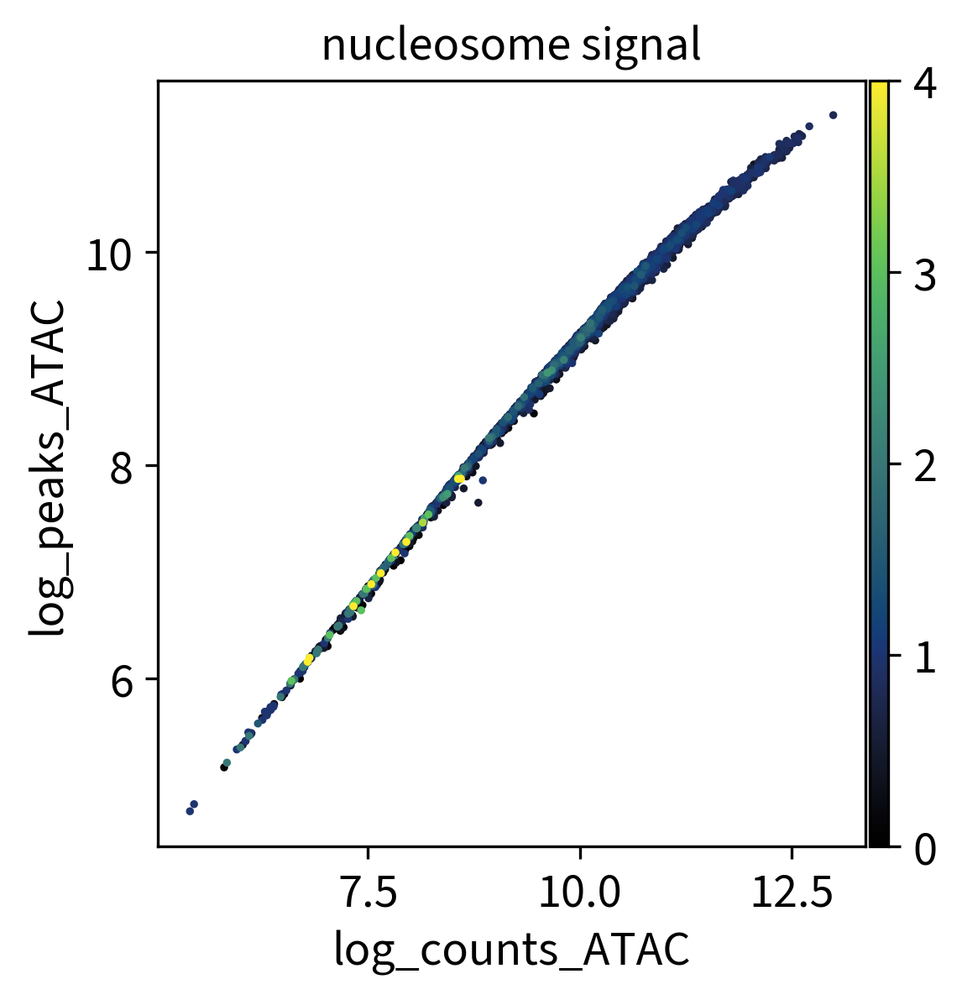

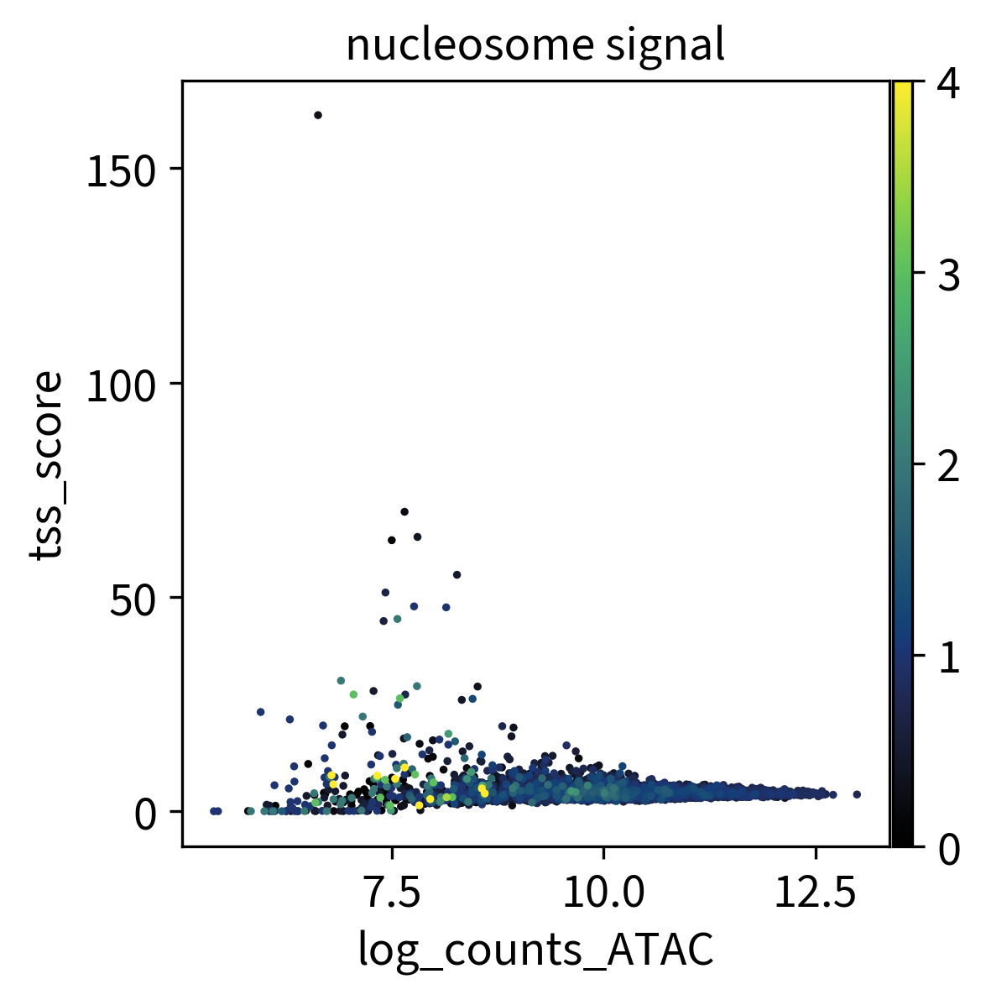

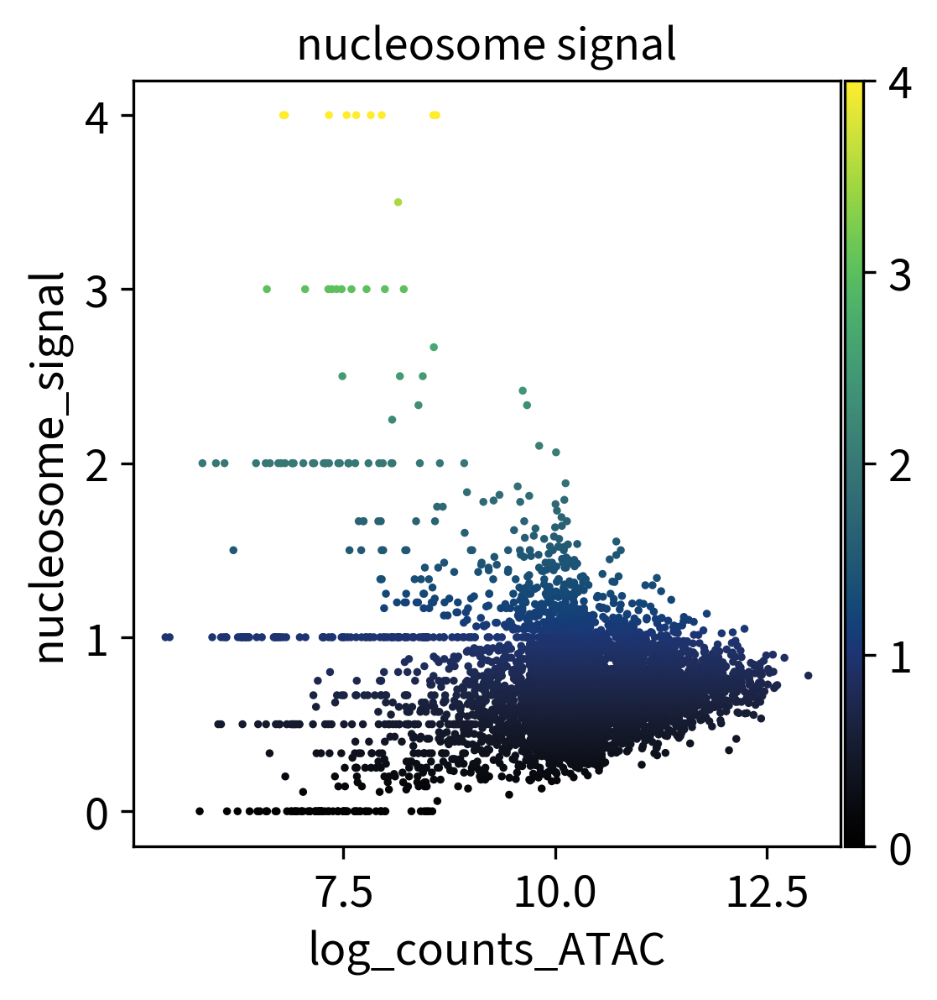

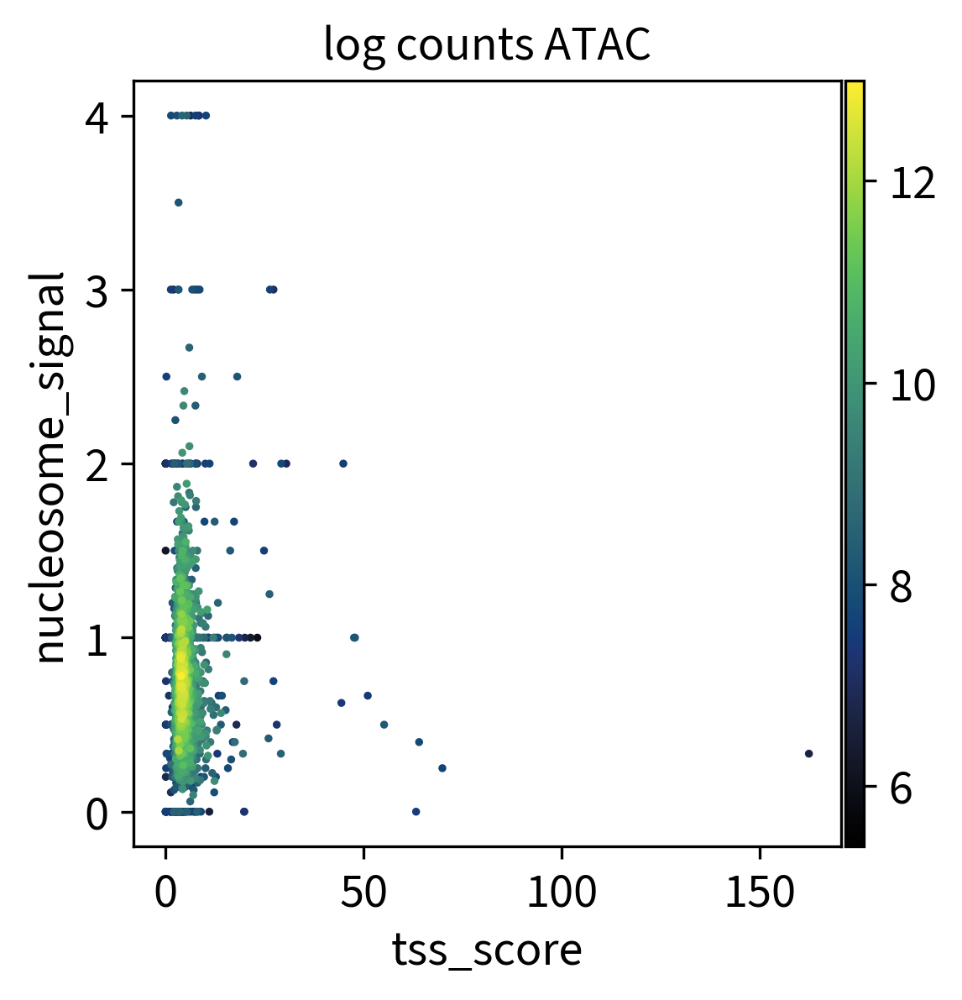

In [52]:
sc.pl.scatter(atac, 'n_counts_ATAC', 'n_peaks_ATAC', color='nucleosome_signal', color_map=michi_bk_bl_gn_yl, show=False)
sc.pl.scatter(atac, 'log_counts_ATAC', 'log_peaks_ATAC', color='nucleosome_signal', color_map=michi_bk_bl_gn_yl, show=False)
sc.pl.scatter(atac, 'log_counts_ATAC', 'tss_score', color='nucleosome_signal', color_map=michi_bk_bl_gn_yl, show=False)
sc.pl.scatter(atac, 'log_counts_ATAC', 'nucleosome_signal', color='nucleosome_signal', color_map=michi_bk_bl_gn_yl, show=False)
sc.pl.scatter(atac, 'tss_score', 'nucleosome_signal', color='log_counts_ATAC', color_map=michi_bk_bl_gn_yl, show=False)

### QC & Thresholding Decisions

#### Counts

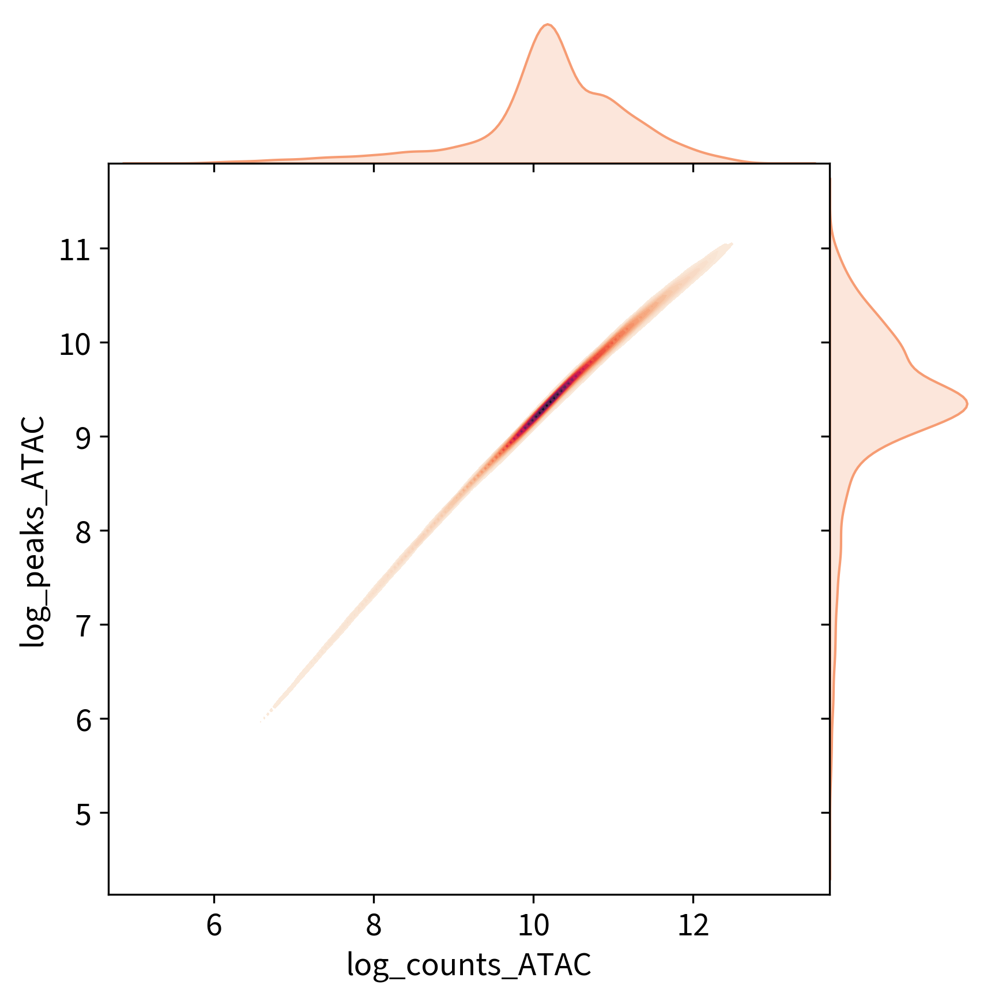

In [53]:
sb.jointplot(x=atac.obs['log_counts_ATAC'], y=atac.obs['log_peaks_ATAC'], n_levels=30, thresh=0.05, kind="kde", space=0, fill=True, cmap="rocket_r", color="#f69c73").plot_joint(
    sb.scatterplot, alpha=0)

/tmp/ipykernel_980990/3936968963.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['n_counts_ATAC'], kde=True)


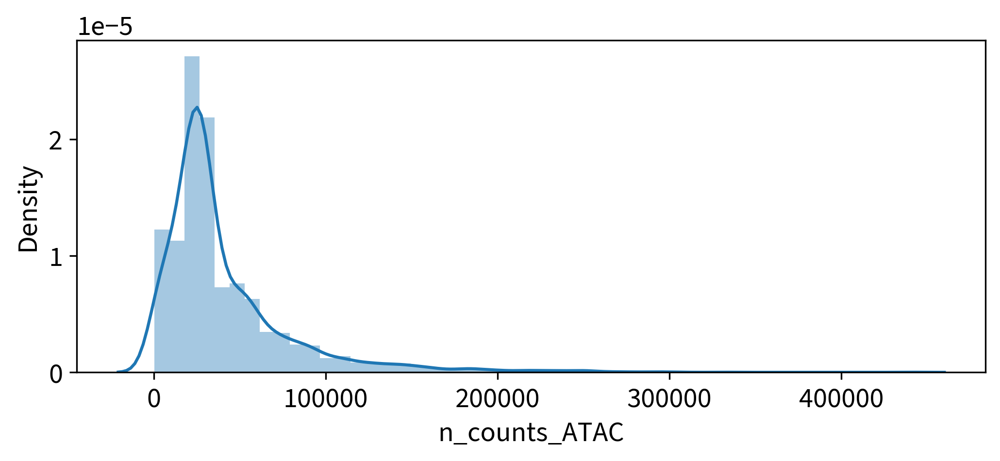

In [54]:
#Thresholding decision: counts
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(atac.obs['n_counts_ATAC'], kde=True)

/tmp/ipykernel_980990/1401240201.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['n_counts_ATAC'][(atac.obs['n_counts_ATAC']<x_lim[1])], kde=True, bins=60)


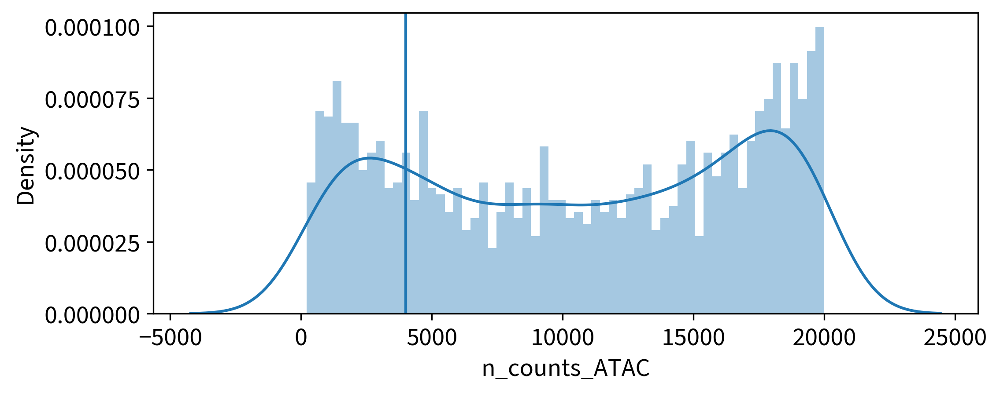

In [55]:
min_counts_atac = 4000
x_lim = [0,20000]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(atac.obs['n_counts_ATAC'][(atac.obs['n_counts_ATAC']<x_lim[1])], kde=True, bins=60)
    plt.axvline(min_counts_atac, 0, 1)

/tmp/ipykernel_980990/2608235364.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['n_counts_ATAC'][(atac.obs['n_counts_ATAC']>x_lim[0]) & (atac.obs['n_counts_ATAC']<x_lim[1])], kde=True, bins=60)


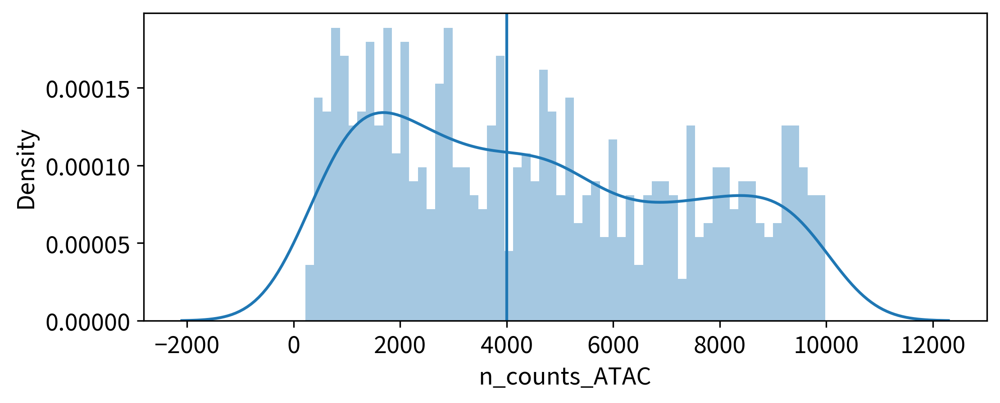

In [56]:
x_lim = [1,10000]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(atac.obs['n_counts_ATAC'][(atac.obs['n_counts_ATAC']>x_lim[0]) & (atac.obs['n_counts_ATAC']<x_lim[1])], kde=True, bins=60)
    plt.axvline(min_counts_atac, 0, 1)

/tmp/ipykernel_980990/2065150437.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['n_counts_ATAC'][(atac.obs['n_counts_ATAC']>x_lim[0]) & (atac.obs['n_counts_ATAC']<x_lim[1])], kde=True, bins=60)


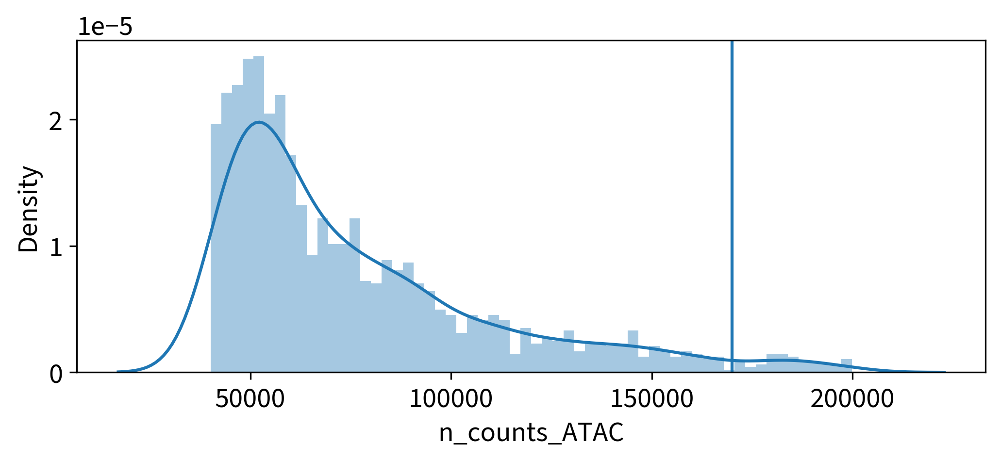

In [57]:
max_counts_atac = 170000
x_lim = [40000,200000]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(atac.obs['n_counts_ATAC'][(atac.obs['n_counts_ATAC']>x_lim[0]) & (atac.obs['n_counts_ATAC']<x_lim[1])], kde=True, bins=60)
    plt.axvline(max_counts_atac, 0, 1)

/tmp/ipykernel_980990/2943203423.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['n_counts_ATAC'][(atac.obs['n_counts_ATAC']>x_lim[0]) & (atac.obs['n_counts_ATAC']<x_lim[1])], kde=True, bins=60)


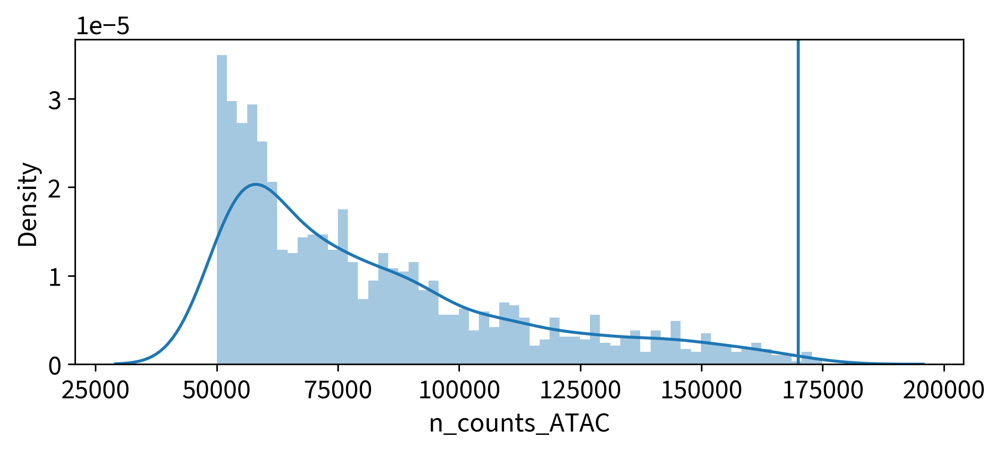

In [58]:
x_lim = [50000,175000]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(atac.obs['n_counts_ATAC'][(atac.obs['n_counts_ATAC']>x_lim[0]) & (atac.obs['n_counts_ATAC']<x_lim[1])], kde=True, bins=60)
    plt.axvline(max_counts_atac, 0, 1)

In [59]:
counts_filter_atac = (atac.obs['n_counts_ATAC'] > min_counts_atac) & (atac.obs['n_counts_ATAC'] < max_counts_atac)

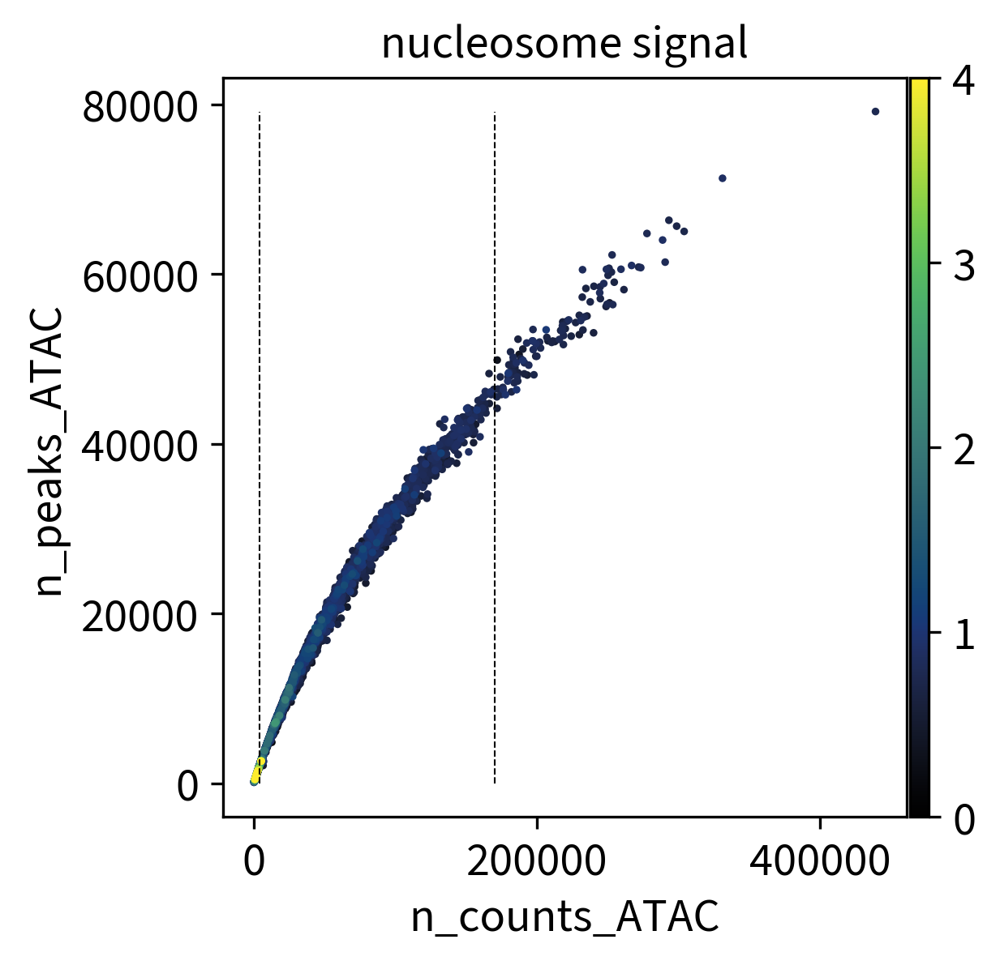

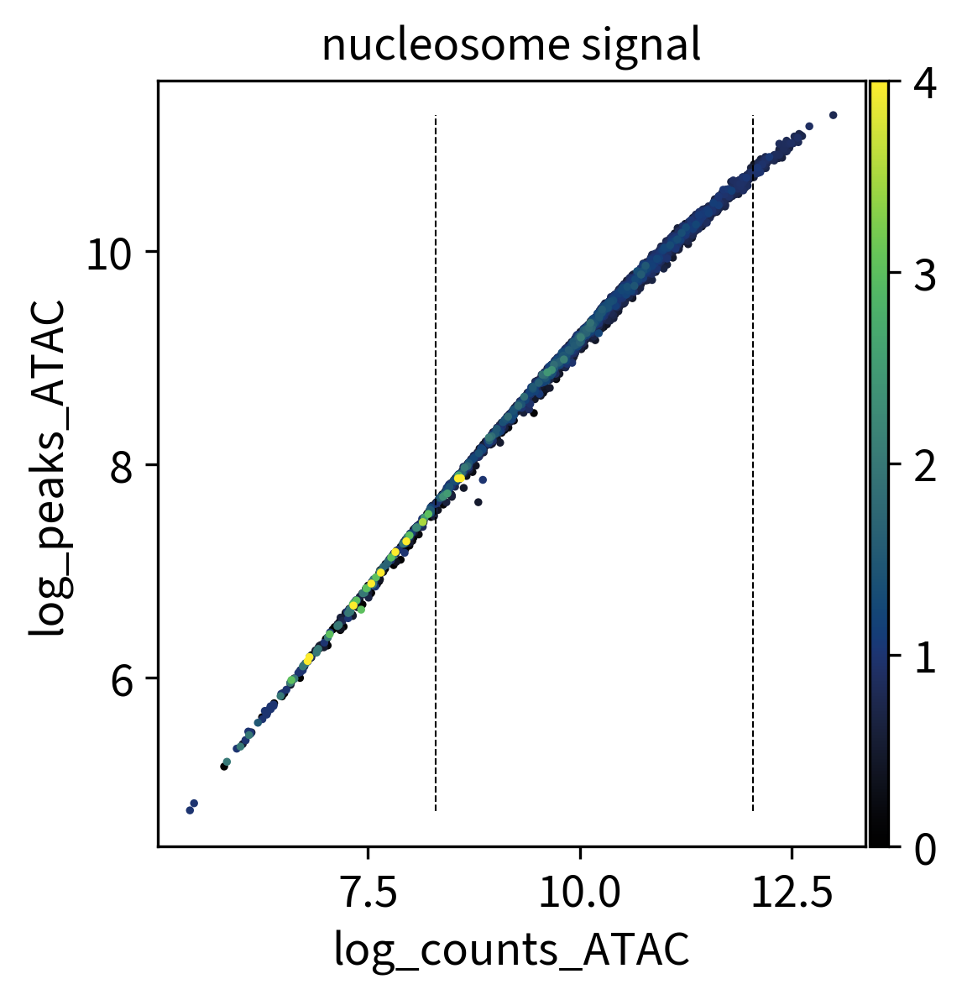

In [60]:
sc.pl.scatter(atac, 'n_counts_ATAC', 'n_peaks_ATAC', color='nucleosome_signal', color_map=michi_bk_bl_gn_yl, show=False).vlines(x=[min_counts_atac, max_counts_atac], ymin=[0,0], ymax=[max(atac.obs['n_peaks_ATAC']),max(atac.obs['n_peaks_ATAC'])], color="black", lw=0.5).set_linestyle("--")
sc.pl.scatter(atac, 'log_counts_ATAC', 'log_peaks_ATAC', color='nucleosome_signal', color_map=michi_bk_bl_gn_yl, show=False).vlines(x=[np.log(min_counts_atac), np.log(max_counts_atac)], ymin=[np.log(min(atac.obs['n_peaks_ATAC'])),np.log(min(atac.obs['n_peaks_ATAC']))], ymax=[np.log(max(atac.obs['n_peaks_ATAC'])),np.log(max(atac.obs['n_peaks_ATAC']))], color="black", lw=0.5).set_linestyle("--")

#### TSS Enrichment

/tmp/ipykernel_980990/1861261643.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['tss_score'][counts_filter_atac], kde=True, bins=60)
/tmp/ipykernel_980990/1861261643.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['tss_score'], kde=True, bins=60)


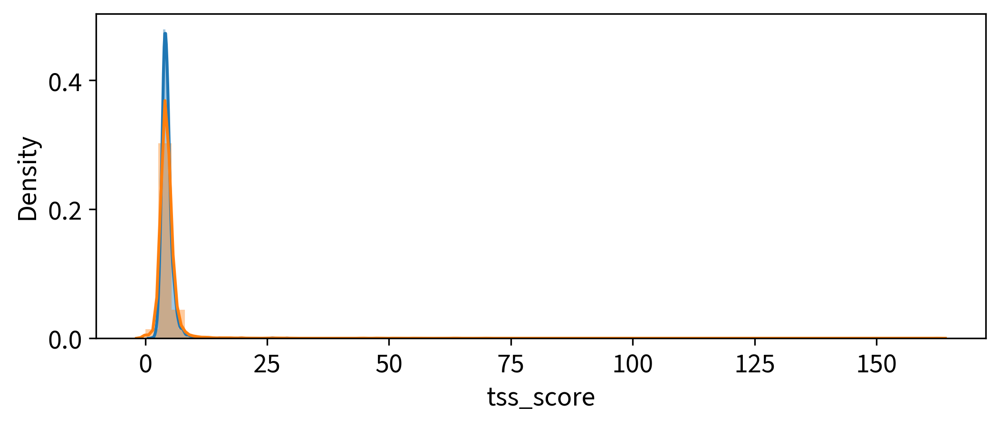

In [61]:
#Thresholding decision: tss enrichment
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(atac.obs['tss_score'][counts_filter_atac], kde=True, bins=60)
    sb.distplot(atac.obs['tss_score'], kde=True, bins=60)

/tmp/ipykernel_980990/1101978936.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['tss_score'][(atac.obs['tss_score']>x_lim[0]) & (atac.obs['tss_score']<x_lim[1]) & counts_filter_atac], kde=True, bins=60)
/tmp/ipykernel_980990/1101978936.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distp

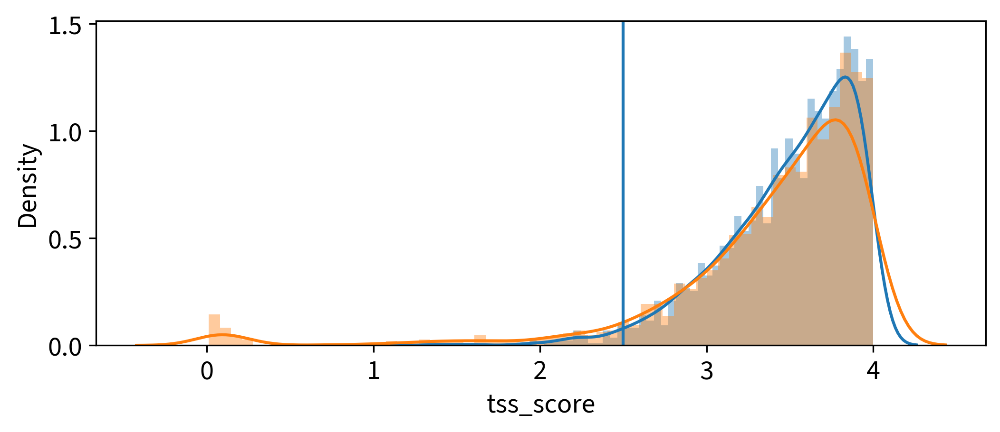

In [62]:
min_tss = 2.5
x_lim = [0,4]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(atac.obs['tss_score'][(atac.obs['tss_score']>x_lim[0]) & (atac.obs['tss_score']<x_lim[1]) & counts_filter_atac], kde=True, bins=60)
    sb.distplot(atac.obs['tss_score'][(atac.obs['tss_score']>x_lim[0]) & (atac.obs['tss_score']<x_lim[1])], kde=True, bins=60)
    plt.axvline(min_tss, 0, 1)

/tmp/ipykernel_980990/92342277.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['tss_score'][(atac.obs['tss_score']>x_lim[0]) & (atac.obs['tss_score']<x_lim[1]) & counts_filter_atac], kde=True, bins=60)
/tmp/ipykernel_980990/92342277.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(

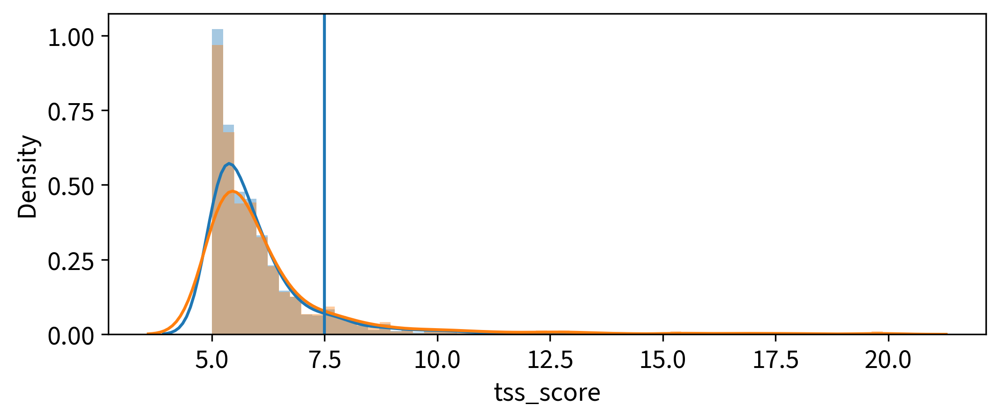

In [63]:
max_tss = 7.5
x_lim = [5,20]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(atac.obs['tss_score'][(atac.obs['tss_score']>x_lim[0]) & (atac.obs['tss_score']<x_lim[1]) & counts_filter_atac], kde=True, bins=60)
    sb.distplot(atac.obs['tss_score'][(atac.obs['tss_score']>x_lim[0]) & (atac.obs['tss_score']<x_lim[1])], kde=True, bins=60)
    plt.axvline(max_tss, 0, 1)

/tmp/ipykernel_980990/1515386184.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['tss_score'][(atac.obs['tss_score']>x_lim[0]) & (atac.obs['tss_score']<x_lim[1]) & counts_filter_atac], kde=True, bins=60)
/tmp/ipykernel_980990/1515386184.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distp

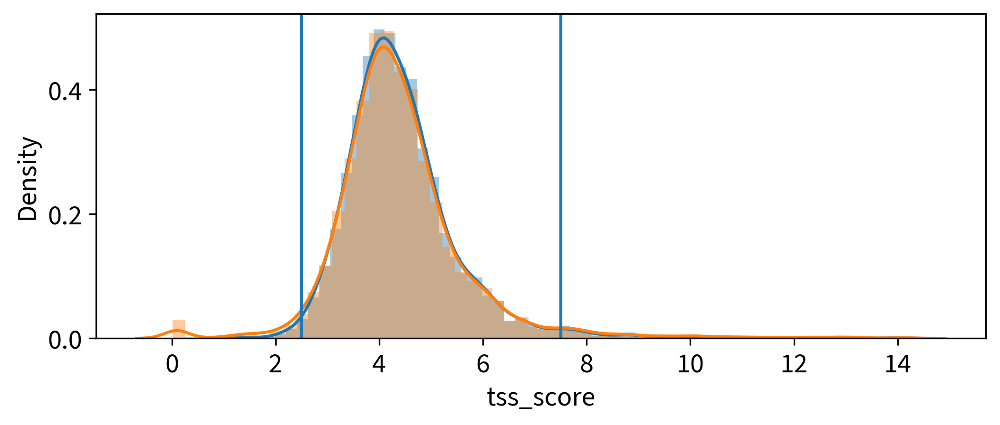

In [64]:
x_lim = [0,15]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(atac.obs['tss_score'][(atac.obs['tss_score']>x_lim[0]) & (atac.obs['tss_score']<x_lim[1]) & counts_filter_atac], kde=True, bins=60)
    sb.distplot(atac.obs['tss_score'][(atac.obs['tss_score']>x_lim[0]) & (atac.obs['tss_score']<x_lim[1])], kde=True, bins=60)
    plt.axvline([min_tss], 0, 1)
    plt.axvline([max_tss], 0, 1)

In [65]:
tss_filter_atac = (atac.obs['tss_score'] > min_tss) & (atac.obs['tss_score'] < max_tss)

#### Nucleosome Signal

/tmp/ipykernel_980990/1859720918.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['nucleosome_signal'][counts_filter_atac & tss_filter_atac], kde=True, bins=60)
/tmp/ipykernel_980990/1859720918.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['nucleosome_signal'], kde=True,

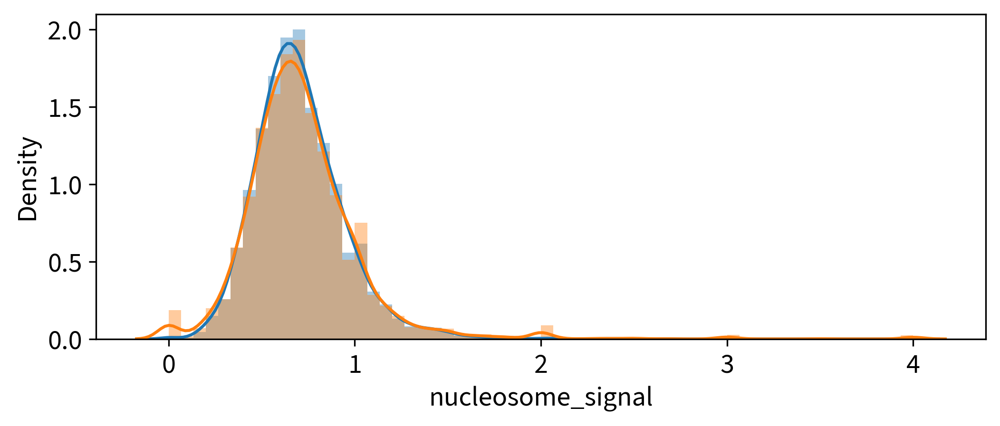

In [66]:
#Thresholding decision: nucleosome signal
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(atac.obs['nucleosome_signal'][counts_filter_atac & tss_filter_atac], kde=True, bins=60)
    sb.distplot(atac.obs['nucleosome_signal'], kde=True, bins=60)

/tmp/ipykernel_980990/4010705945.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1]) & counts_filter_atac & tss_filter_atac], kde=True, bins=60)
/tmp/ipykernel_980990/4010705945.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de

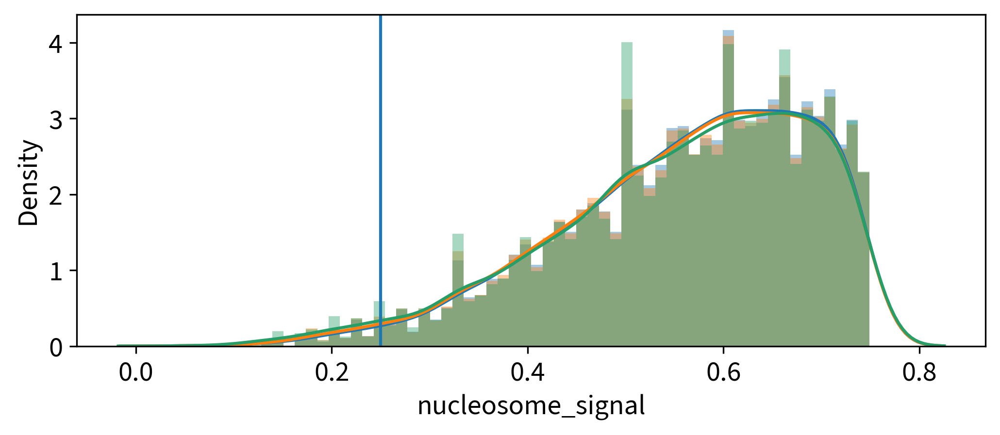

In [67]:
min_nuc = 0.25
x_lim = [0,0.75]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1]) & counts_filter_atac & tss_filter_atac], kde=True, bins=60)
    sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1]) & counts_filter_atac], kde=True, bins=60)
    # sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1]) & counts_filter_atac], kde=True, bins=60)
    sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1])], kde=True, bins=60)
    plt.axvline(min_nuc, 0, 1)

/tmp/ipykernel_980990/2302771396.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1]) & counts_filter_atac & tss_filter_atac], kde=True, bins=60)
/tmp/ipykernel_980990/2302771396.py:5: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de

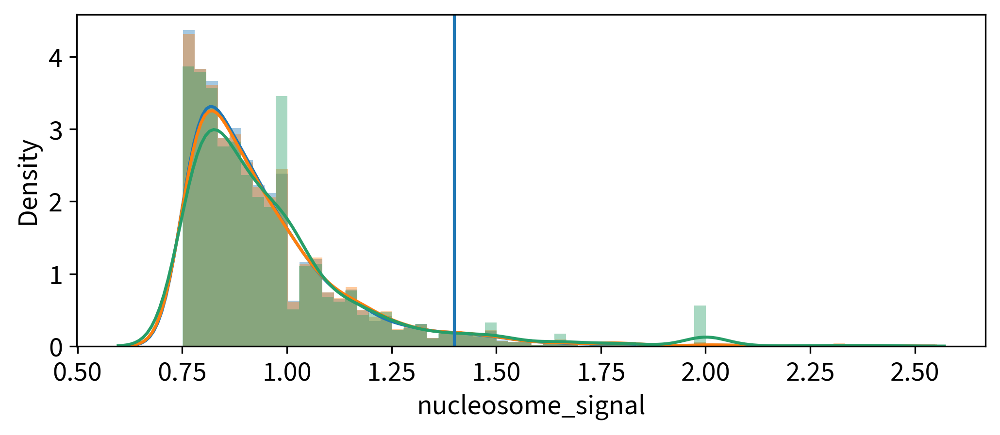

In [68]:
max_nuc = 1.4
x_lim = [0.75,2.5]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1]) & counts_filter_atac & tss_filter_atac], kde=True, bins=60)
    sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1]) & counts_filter_atac], kde=True, bins=60)
    # sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1]) & counts_filter_atac], kde=True, bins=60)
    sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1])], kde=True, bins=60)
    plt.axvline(max_nuc, 0, 1)

/tmp/ipykernel_980990/2892467472.py:3: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1]) & counts_filter_atac & tss_filter_atac], kde=True, bins=60)
/tmp/ipykernel_980990/2892467472.py:4: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de

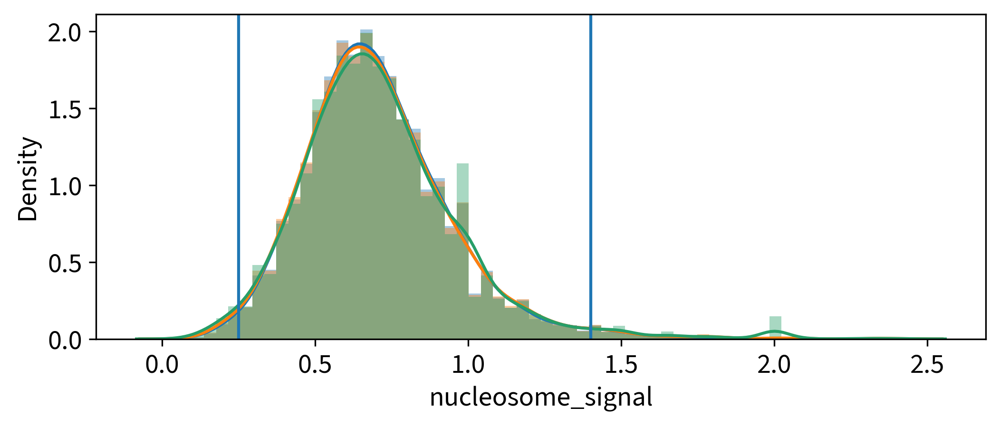

In [69]:
x_lim = [0,2.5]
with rc_context({'figure.figsize': (8, 3)}):
    sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1]) & counts_filter_atac & tss_filter_atac], kde=True, bins=60)
    sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1]) & counts_filter_atac], kde=True, bins=60)
    # sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1]) & counts_filter_atac], kde=True, bins=60)
    sb.distplot(atac.obs['nucleosome_signal'][(atac.obs['nucleosome_signal']>x_lim[0]) & (atac.obs['nucleosome_signal']<x_lim[1])], kde=True, bins=60)
    plt.axvline(min_nuc, 0, 1)
    plt.axvline(max_nuc, 0, 1)

In [70]:
nuc_filter_atac = (atac.obs['nucleosome_signal'] > min_nuc) & (atac.obs['nucleosome_signal'] < max_nuc)

### Filtering

In [71]:
atac.obs['filtered_cells']=pd.Categorical(list(map(str,list(counts_filter_atac & tss_filter_atac & nuc_filter_atac))))

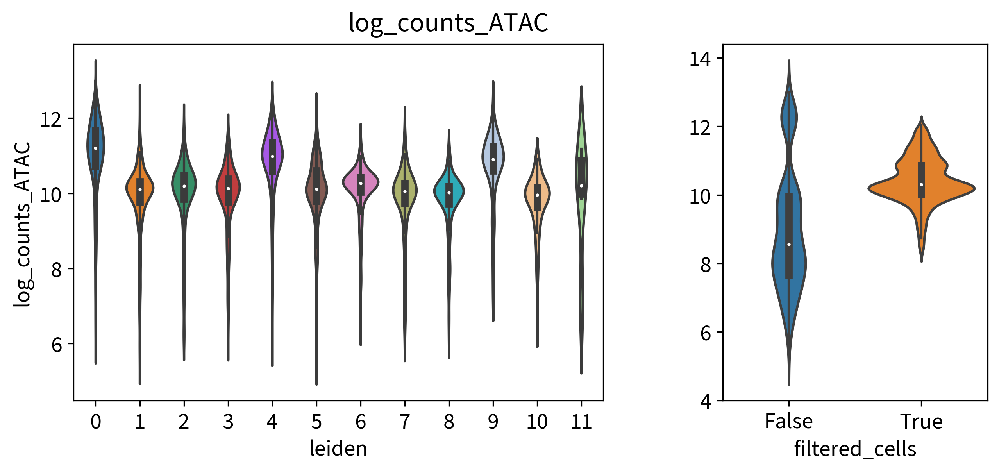

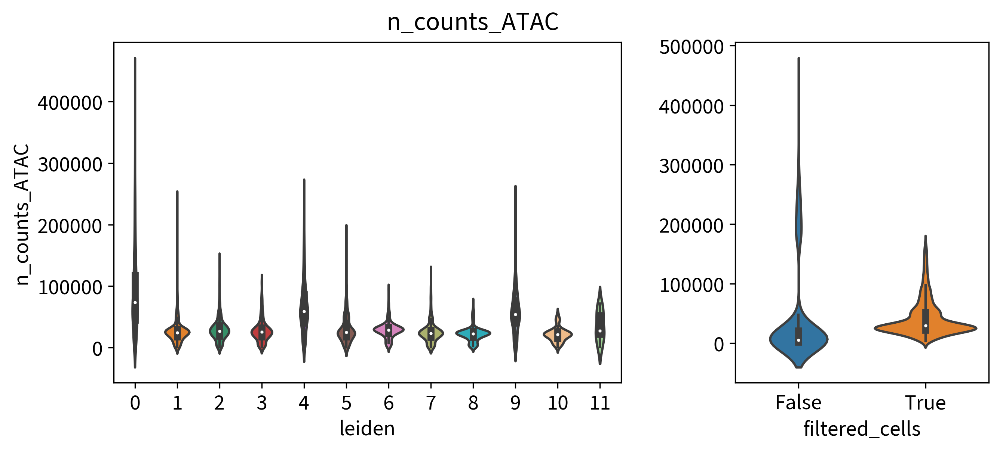

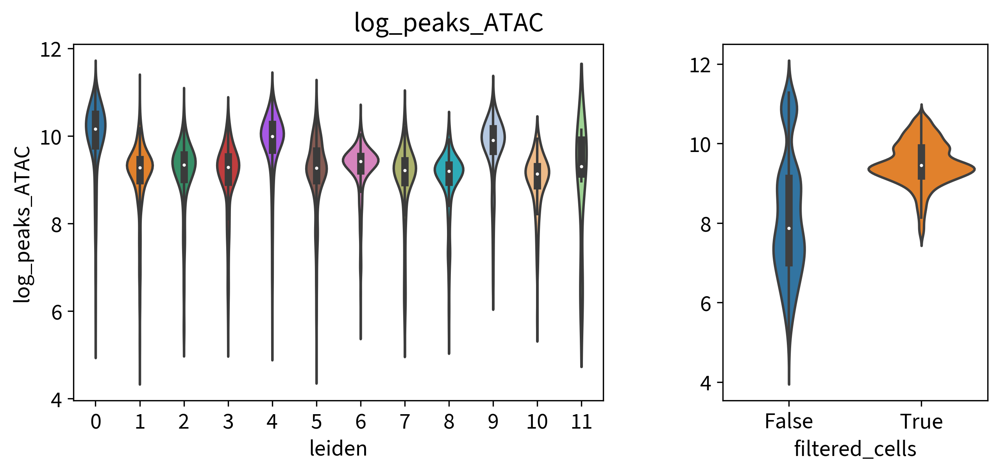

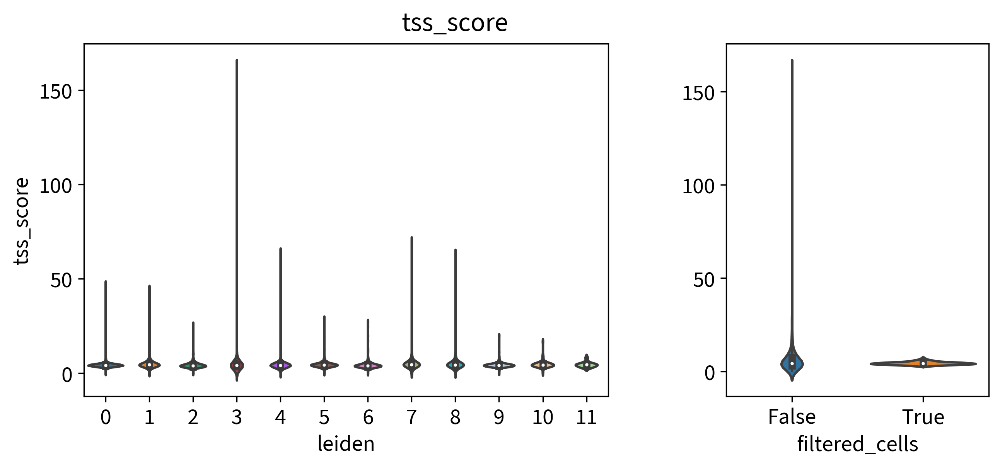

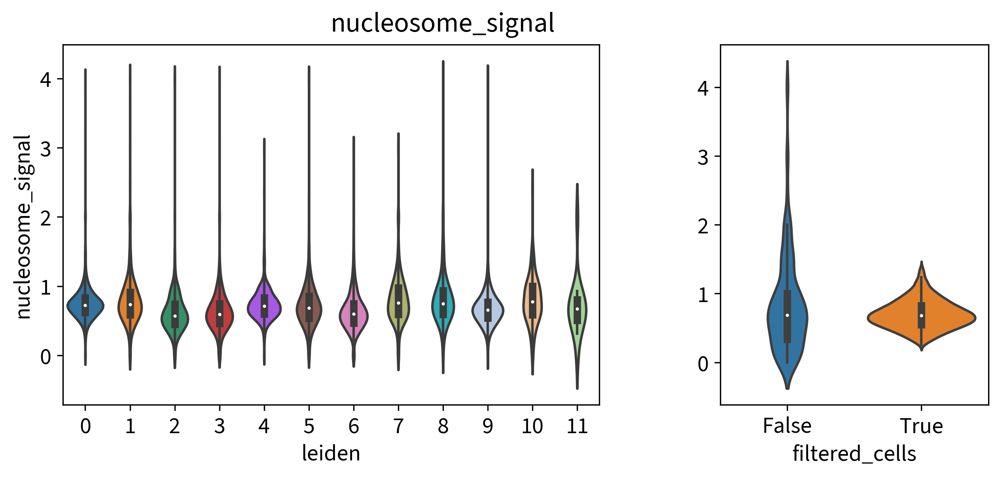

In [72]:
for col in ['log_counts_ATAC', 'n_counts_ATAC', 'log_peaks_ATAC', 'tss_score', 'nucleosome_signal']:
    
    fig, axes = plt.subplots(1,2, figsize=(10, 4), gridspec_kw=dict(width_ratios=[2,1],wspace = 0.3))
    
    sb.violinplot(x='leiden', y=col, data=atac.obs, ax=axes[0])
    
    sb.violinplot(x='filtered_cells', y=col, data=atac.obs, ax=axes[1])
    axes[1].set_ylabel(None)
    fig.suptitle(col)

/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap', 'norm' will be ignored
  ax.scatter(


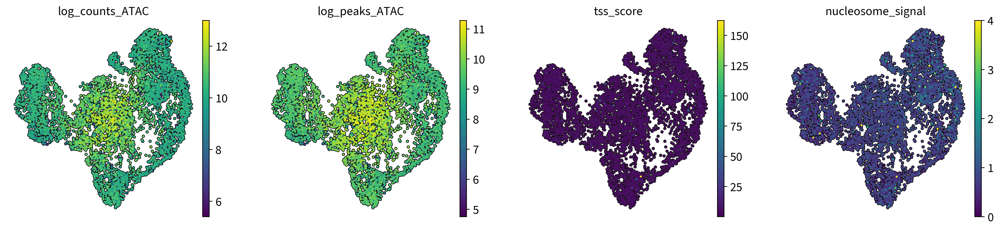

/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:369: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  ax.scatter(
/home/michi/Software/venvs/scverse_2023/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:379: UserWarning: No data 

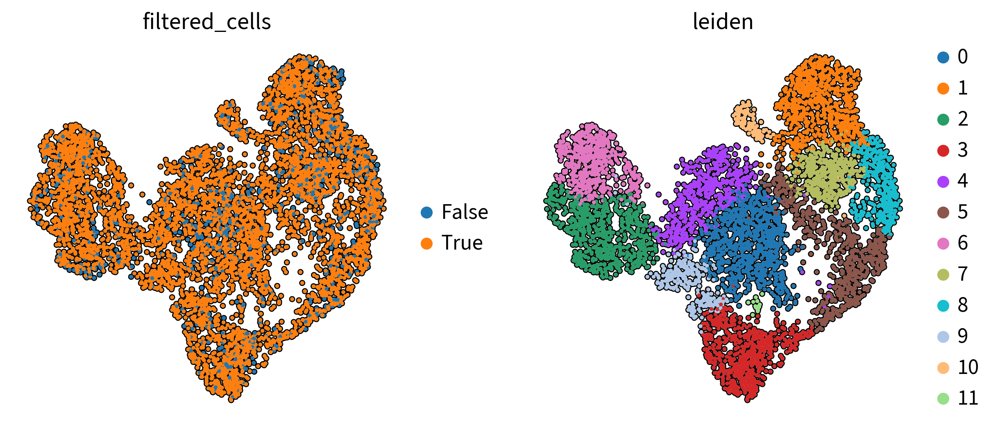

/tmp/ipykernel_980990/3353929547.py:25: UserWarning: FixedFormatter should only be used together with FixedLocator
  ax.axes.set_xticklabels(labels=labels, rotation=90)


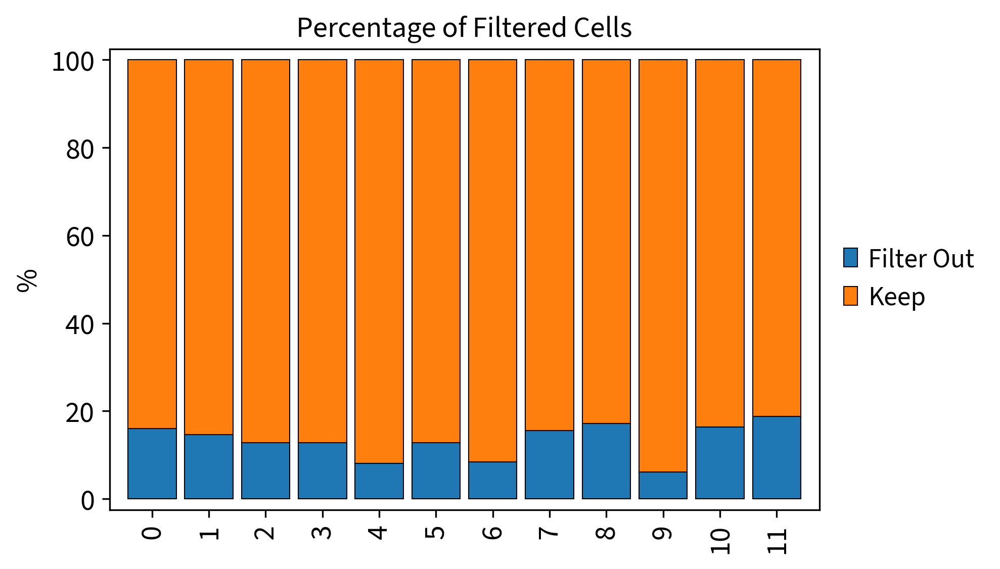

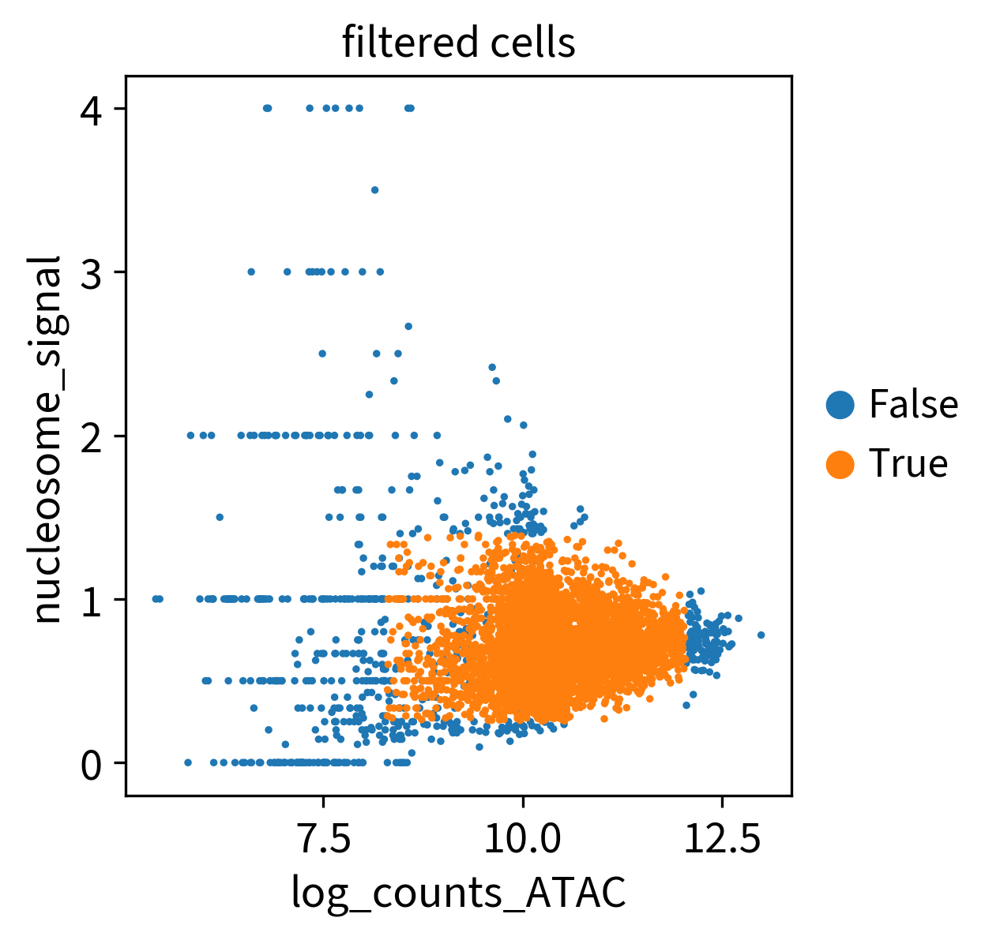

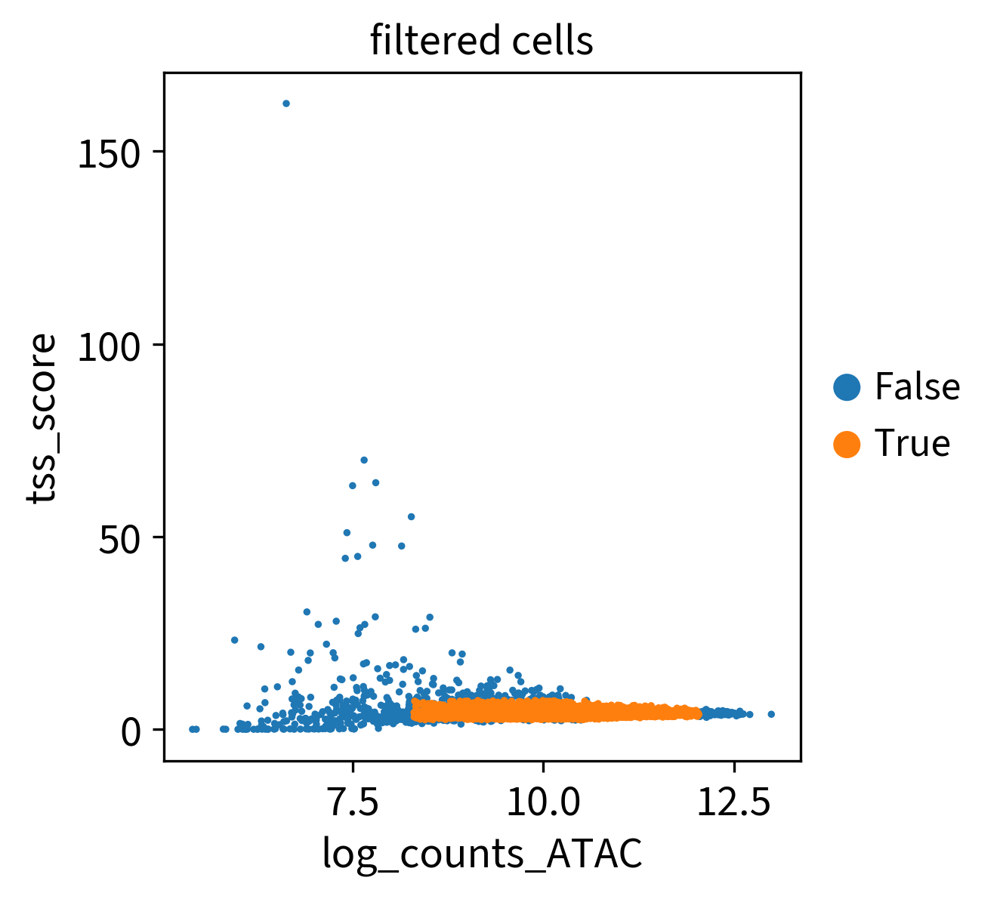

In [73]:
sc.pl.umap(atac, color=['log_counts_ATAC', 'log_peaks_ATAC', 'tss_score', 'nucleosome_signal'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=4)
sc.pl.umap(atac, color=['filtered_cells','leiden'], size=20, add_outline=True, alpha=1, outline_width=(0.3, 0.0), ncols=6)

###############################################################################
###############################################################################

with rc_context({'figure.figsize': (6, 4)}): #rcParams['figure.figsize']=(6,4)
    key = 'leiden'
    labels = list(atac.obs[key].cat.categories)
    keep_pct = []
    filter_pct = []
    width = 0.85       # the width of the bars: can also be len(x) sequence

    for label in labels:
        keep_pct = keep_pct + [atac.obs['filtered_cells'][atac.obs[key]==label].value_counts()['True']/atac.obs['filtered_cells'][atac.obs[key]==label].value_counts().sum()*100]
        filter_pct = filter_pct + [atac.obs['filtered_cells'][atac.obs[key]==label].value_counts()['False']/atac.obs['filtered_cells'][atac.obs[key]==label].value_counts().sum()*100]

    fig, ax = plt.subplots()

    ax.bar(labels, filter_pct, width, label='Filter Out', edgecolor='0', linewidth=0.5)
    ax.bar(labels, keep_pct, width, bottom=filter_pct, label='Keep', edgecolor='0', linewidth=0.5)

    ax.set_ylabel('%')
    ax.set_title('Percentage of Filtered Cells')
    ax.axes.set_xticklabels(labels=labels, rotation=90)
    ax.legend(bbox_to_anchor=(1, .5),loc='center left', edgecolor='1')

    plt.ylim([-2.5,100+2.5])
    plt.xlim([-1+0.25,len(labels)-0.25])

    plt.show()

#################################################################################
#################################################################################

sc.pl.scatter(atac, 'log_counts_ATAC', 'nucleosome_signal', color='filtered_cells')
sc.pl.scatter(atac, 'log_counts_ATAC', 'tss_score', color='filtered_cells')

In [74]:
# Filter cells according to identified QC thresholds:
atac = qc_filter_mdata(mdata, atac, modality='atac', qc_filter=(counts_filter_atac & tss_filter_atac & nuc_filter_atac))

Filtered out 745 cells (12.9 %).
Number of cells after filter: 5031


/tmp/ipykernel_980990/112473584.py:21: ImplicitModificationWarning: Trying to modify attribute `.var` of view, initializing view as actual.
  atac.var['n_counts'] = atac.X.sum(0)


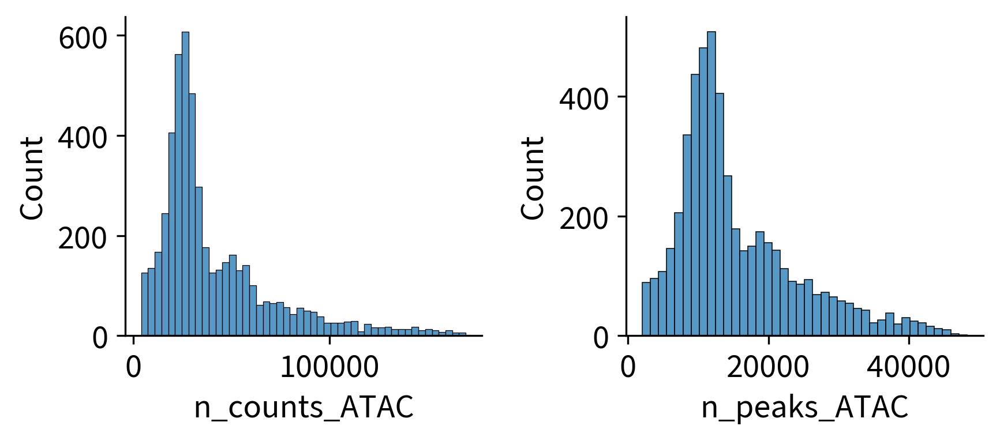

[W::hts_idx_load3] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/atac_fragments.tsv.gz.tbi
Reading Fragments: 100%|██████████| 1000000/1000000 [00:03<00:00, 295204.09it/s]

Added a "nucleosome_signal" column to the .obs slot of the AnnData object



[W::hts_idx_load3] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/atac_fragments.tsv.gz.tbi
Fetching Regions...: 100%|████████████████████████| 1/1 [00:04<00:00,  4.57s/it]


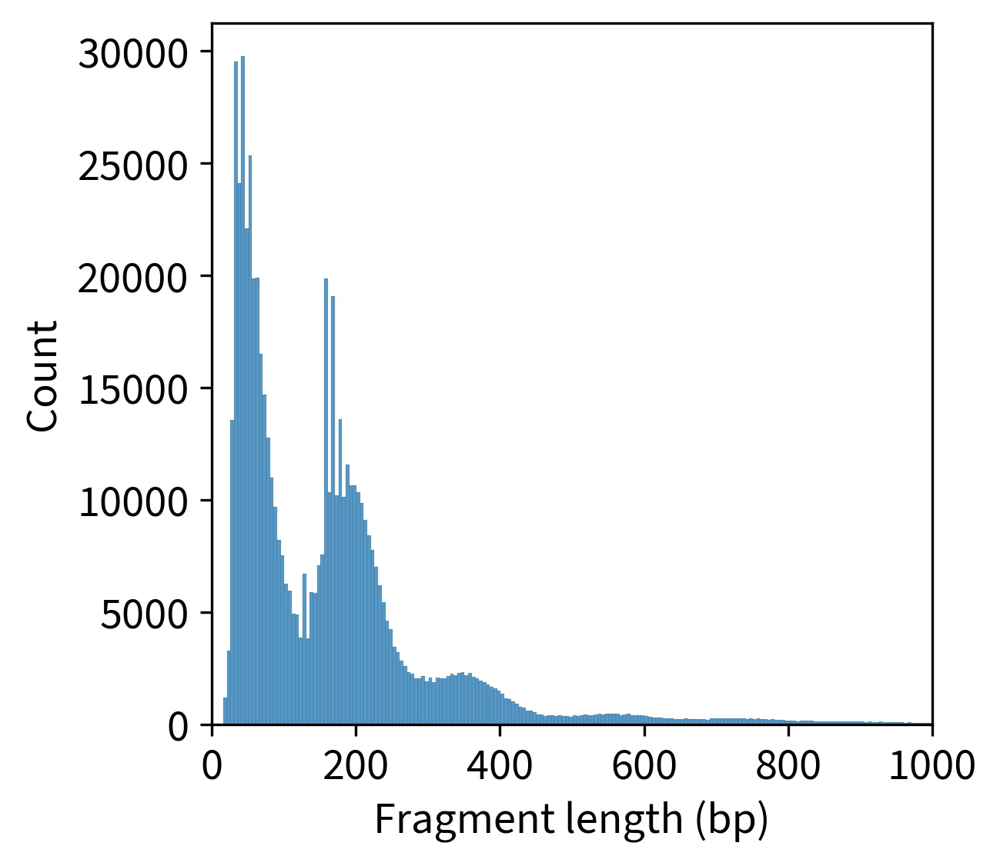

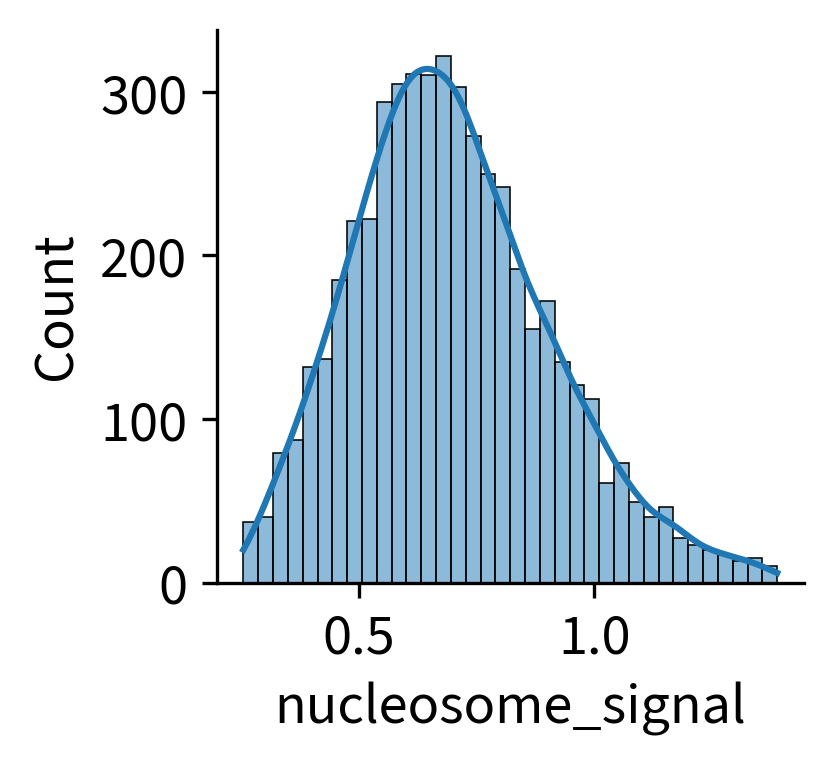

[W::hts_idx_load3] The index file is older than the data file: /storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/atac_fragments.tsv.gz.tbi
Fetching Regions...: 100%|██████████████████| 1998/1998 [00:44<00:00, 45.30it/s]

Added a "tss_score" column to the .obs slot of tof the 'atac' modality


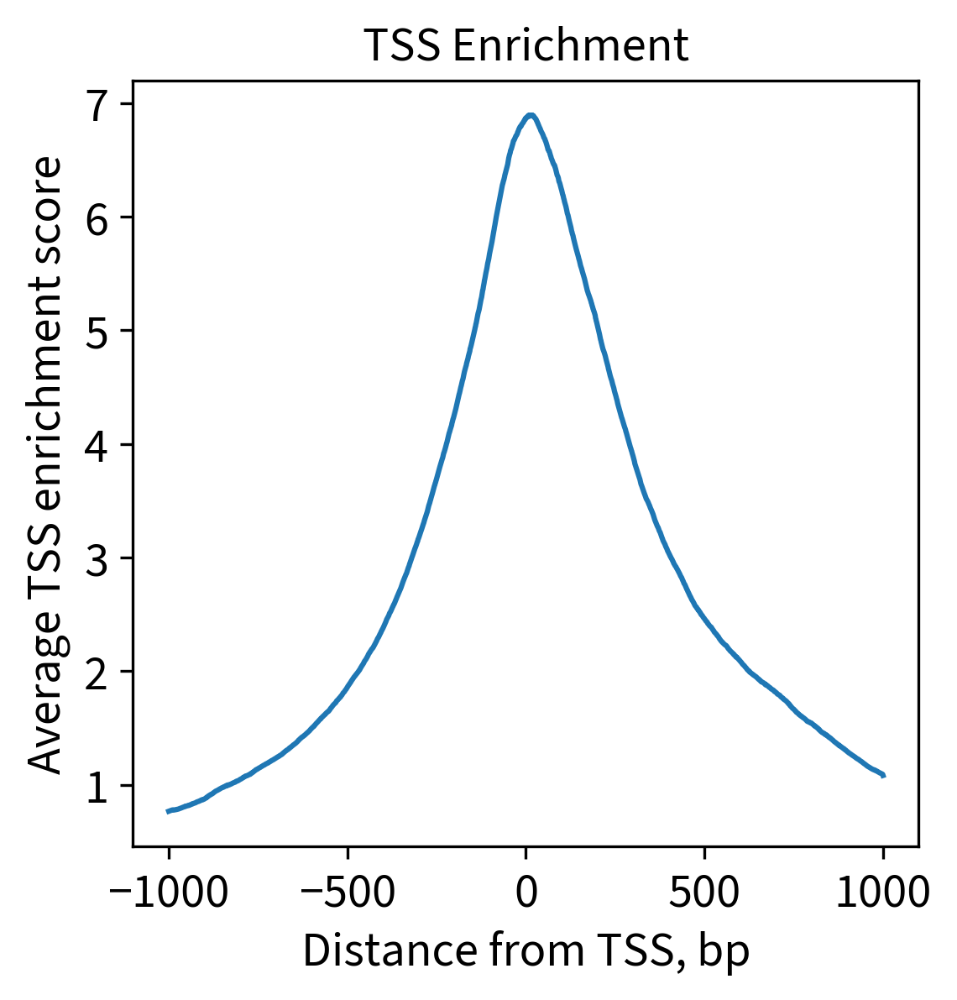

In [75]:
atac_qc_metrics(atac, mdata, n_tss=2000, gtf_path='/mnt/ssd/Genomes/mm10/Mus_musculus.GRCm38.102.gtf')

In [76]:
# retain only cell passing GEX & ATAC QC
mu.pp.intersect_obs(mdata)
mdata

MuData object with n_obs × n_vars = 5031 × 212894
  obs:	'sample', 'name', 'stage', 'stage_num', 'int_id', 'seq_id_gex_id', 'seq_id_atac', 'reporter', 'experiment_batch', 'sequencing_batch'
  var:	'gene_ids', 'feature_types', 'genome', 'interval'
  2 modalities
    rna:	5031 x 31255
      obs:	'sample', 'name', 'stage', 'stage_num', 'int_id', 'seq_id_gex_id', 'seq_id_atac', 'reporter', 'experiment_batch', 'sequencing_batch', 'log_cell_probs', 'n_counts', 'log_counts', 'n_counts_rank', 'n_genes', 'log_genes', 'mt_frac', 'rp_frac', 'ambi_frac', 'leiden'
      var:	'gene_ids', 'feature_types', 'genome', 'interval', 'ambient_genes_NVF_E16-5_Rep1', 'is_ambient_NVF_E16-5_Rep1', 'n_counts'
      uns:	'leiden_colors', 'filter_mt_frac_colors', 'filtered_cells_colors'
      obsm:	'X_umap'
    atac:	5031 x 181639
      obs:	'sample', 'name', 'stage', 'stage_num', 'int_id', 'seq_id_gex_id', 'seq_id_atac', 'reporter', 'experiment_batch', 'sequencing_batch', 'leiden', 'n_counts_ATAC', 'log_counts_ATAC', 'n_counts_rank_ATAC', 'n_peaks_ATAC', 'log_peaks_ATAC', 'nucleosome_signal', 'tss_score', 'filtered_cells'
      var:	'gene_ids', 'feature_types', 'genome', 'interval', 'n_counts'
      uns:	'atac', 'files', 'filtered_cells_colors', 'leiden_colors'
      obsm:	'X_umap'

# Save Results

In [77]:
# Make matrices sparse again
sparsify_mdata(mdata)

Sparsify modality rna
Sparsify modality atac


In [78]:
is_ambi_key = 'is_ambient_' + mdata.mod['rna'].obs['sample'][0]
mdata.mod['rna'].var[is_ambi_key] = mdata.mod['rna'].var[is_ambi_key].astype(str).astype('category').copy()

In [79]:
# https://github.com/scverse/muon/issues/65
mdata.mod['atac'].uns['files'] = dict(mdata.mod['atac'].uns['files'])
mdata.mod['atac'].uns['atac'] = dict(mdata.mod['atac'].uns['atac'])

In [80]:
# Save
mdata.write('/storage/scRNA-seq/scMultiome_Mouse-Islets_NVF_E14-E16_P23044/cr_arc_rev9/cr_count/NVF_E16-5_Rep1/outs/NVF_E16-5_Rep1_raw_feature_bc_matrix_filtered.h5mu')